# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/home/vladimir/.local/bin/miniconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

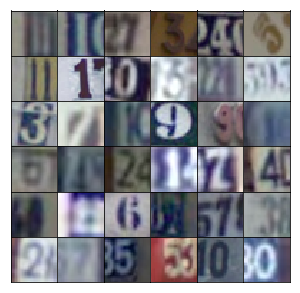

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer
        x = tf.layers.dense(z, 512 * 4 * 4, use_bias=False)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.nn.leaky_relu(x, alpha)
        
        # 4x4x512
        
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, use_bias=False, padding='SAME')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.nn.leaky_relu(x, alpha)
        
        # 8x8x256
        
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, use_bias=False, padding='SAME')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.nn.leaky_relu(x, alpha)
        
        # 16x16x128
        x = tf.layers.conv2d_transpose(x, output_dim, 5, strides=2, padding='SAME')
        
        # Output layer, 32x32x3
        logits = x
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='SAME')
        x = tf.nn.leaky_relu(x, alpha)
        
        print("conv1 -> ", x)
        
        # 16x16x64
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='SAME', use_bias=False)
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.nn.leaky_relu(x, alpha)
        
        print("conv2 -> ", x)
        
        # 8x8x128
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='SAME', use_bias=False)
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.nn.leaky_relu(x, alpha)
        
        print("conv3 -> ", x)
        
        # 4x4x256
        
        x = tf.reshape(x, (-1, 256 * 4 * 4))
        logits = tf.layers.dense(x, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.02
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

conv1 ->  Tensor("discriminator/LeakyRelu/Maximum:0", shape=(?, 16, 16, 64), dtype=float32)
conv2 ->  Tensor("discriminator/LeakyRelu_1/Maximum:0", shape=(?, 8, 8, 128), dtype=float32)
conv3 ->  Tensor("discriminator/LeakyRelu_2/Maximum:0", shape=(?, 4, 4, 256), dtype=float32)
conv1 ->  Tensor("discriminator_1/LeakyRelu/Maximum:0", shape=(?, 16, 16, 64), dtype=float32)
conv2 ->  Tensor("discriminator_1/LeakyRelu_1/Maximum:0", shape=(?, 8, 8, 128), dtype=float32)
conv3 ->  Tensor("discriminator_1/LeakyRelu_2/Maximum:0", shape=(?, 4, 4, 256), dtype=float32)


Epoch 1/25... Discriminator Loss: 0.5803... Generator Loss: 1.3250
Epoch 1/25... Discriminator Loss: 0.2763... Generator Loss: 1.9455
Epoch 1/25... Discriminator Loss: 0.1848... Generator Loss: 2.1738
Epoch 1/25... Discriminator Loss: 0.0739... Generator Loss: 5.0414
Epoch 1/25... Discriminator Loss: 0.1027... Generator Loss: 3.1415
Epoch 1/25... Discriminator Loss: 0.0731... Generator Loss: 3.1559
Epoch 1/25... Discriminator Loss: 0.0935... Generator Loss: 2.8792
Epoch 1/25... Discriminator Loss: 0.1228... Generator Loss: 3.0301
Epoch 1/25... Discriminator Loss: 0.1394... Generator Loss: 10.7890
Epoch 1/25... Discriminator Loss: 0.0938... Generator Loss: 5.9112


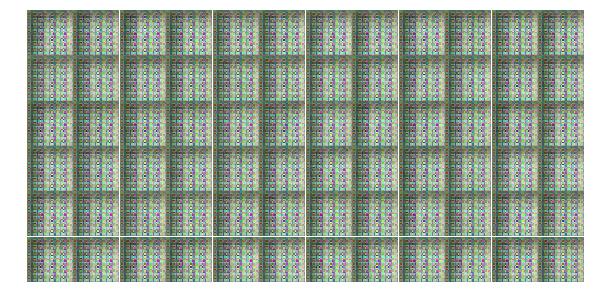

Epoch 1/25... Discriminator Loss: 0.1489... Generator Loss: 6.1713
Epoch 1/25... Discriminator Loss: 0.0903... Generator Loss: 3.1133
Epoch 1/25... Discriminator Loss: 0.0914... Generator Loss: 4.2085
Epoch 1/25... Discriminator Loss: 0.1272... Generator Loss: 2.9801
Epoch 1/25... Discriminator Loss: 0.8428... Generator Loss: 3.4349
Epoch 1/25... Discriminator Loss: 0.6273... Generator Loss: 1.4690
Epoch 1/25... Discriminator Loss: 0.8159... Generator Loss: 0.9767
Epoch 1/25... Discriminator Loss: 0.7460... Generator Loss: 3.7779
Epoch 1/25... Discriminator Loss: 0.8970... Generator Loss: 0.7451
Epoch 1/25... Discriminator Loss: 0.2178... Generator Loss: 2.7994


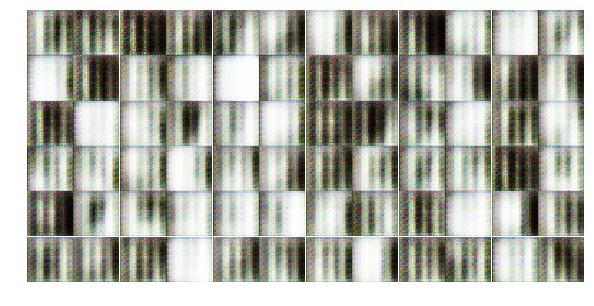

Epoch 1/25... Discriminator Loss: 0.1743... Generator Loss: 3.9178
Epoch 1/25... Discriminator Loss: 0.0775... Generator Loss: 5.0289
Epoch 1/25... Discriminator Loss: 0.2563... Generator Loss: 1.9193
Epoch 1/25... Discriminator Loss: 0.0865... Generator Loss: 3.6006
Epoch 1/25... Discriminator Loss: 0.0830... Generator Loss: 3.5093
Epoch 1/25... Discriminator Loss: 0.4859... Generator Loss: 4.6489
Epoch 1/25... Discriminator Loss: 0.2726... Generator Loss: 2.7006
Epoch 1/25... Discriminator Loss: 0.1336... Generator Loss: 3.0619
Epoch 1/25... Discriminator Loss: 0.2063... Generator Loss: 2.9614
Epoch 1/25... Discriminator Loss: 0.6824... Generator Loss: 2.0296


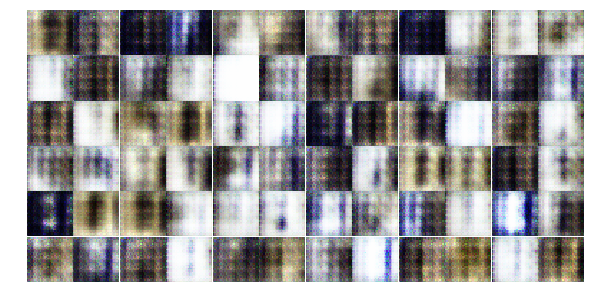

Epoch 1/25... Discriminator Loss: 0.3835... Generator Loss: 2.2751
Epoch 1/25... Discriminator Loss: 0.4933... Generator Loss: 4.2805
Epoch 1/25... Discriminator Loss: 0.3518... Generator Loss: 1.6823
Epoch 1/25... Discriminator Loss: 0.2392... Generator Loss: 3.2448
Epoch 1/25... Discriminator Loss: 0.2779... Generator Loss: 2.5952
Epoch 1/25... Discriminator Loss: 0.6919... Generator Loss: 0.9584
Epoch 1/25... Discriminator Loss: 0.2328... Generator Loss: 2.8802
Epoch 1/25... Discriminator Loss: 0.3100... Generator Loss: 2.6665
Epoch 1/25... Discriminator Loss: 0.3934... Generator Loss: 2.2444
Epoch 1/25... Discriminator Loss: 0.5777... Generator Loss: 1.4308


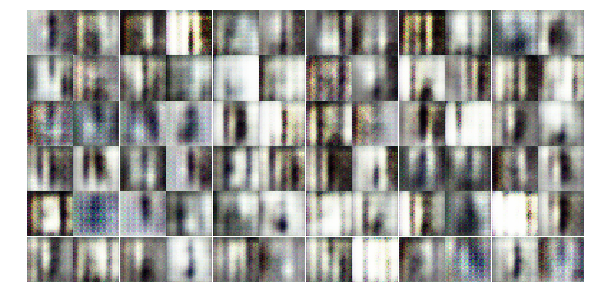

Epoch 1/25... Discriminator Loss: 0.2348... Generator Loss: 2.3239
Epoch 1/25... Discriminator Loss: 0.3637... Generator Loss: 2.3393
Epoch 1/25... Discriminator Loss: 0.7673... Generator Loss: 0.9631
Epoch 1/25... Discriminator Loss: 0.3576... Generator Loss: 4.0548
Epoch 1/25... Discriminator Loss: 0.1497... Generator Loss: 2.5499
Epoch 1/25... Discriminator Loss: 0.2351... Generator Loss: 2.8920
Epoch 1/25... Discriminator Loss: 0.7028... Generator Loss: 1.4194
Epoch 1/25... Discriminator Loss: 0.2850... Generator Loss: 2.1342
Epoch 1/25... Discriminator Loss: 0.1990... Generator Loss: 2.8542
Epoch 1/25... Discriminator Loss: 0.8283... Generator Loss: 0.8668


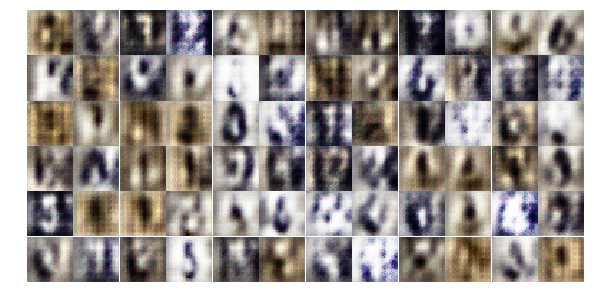

Epoch 1/25... Discriminator Loss: 1.5032... Generator Loss: 0.7127
Epoch 1/25... Discriminator Loss: 0.5300... Generator Loss: 1.6572
Epoch 1/25... Discriminator Loss: 0.5139... Generator Loss: 2.4338
Epoch 1/25... Discriminator Loss: 0.3970... Generator Loss: 1.5444
Epoch 1/25... Discriminator Loss: 2.0387... Generator Loss: 5.7988
Epoch 1/25... Discriminator Loss: 0.7397... Generator Loss: 0.9357
Epoch 1/25... Discriminator Loss: 0.3889... Generator Loss: 3.3729
Epoch 2/25... Discriminator Loss: 0.4058... Generator Loss: 2.0820
Epoch 2/25... Discriminator Loss: 0.3119... Generator Loss: 2.3424
Epoch 2/25... Discriminator Loss: 1.2156... Generator Loss: 0.5447


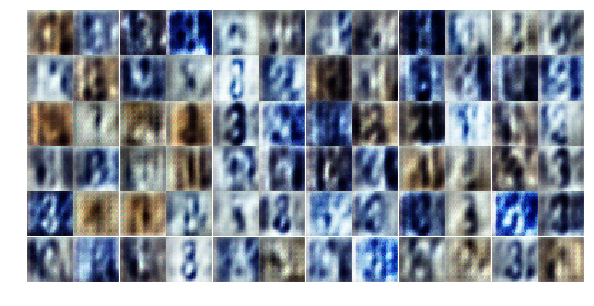

Epoch 2/25... Discriminator Loss: 0.4097... Generator Loss: 2.5013
Epoch 2/25... Discriminator Loss: 1.2382... Generator Loss: 3.3918
Epoch 2/25... Discriminator Loss: 0.8117... Generator Loss: 1.2633
Epoch 2/25... Discriminator Loss: 0.7937... Generator Loss: 2.1668
Epoch 2/25... Discriminator Loss: 0.9094... Generator Loss: 0.9254
Epoch 2/25... Discriminator Loss: 0.6770... Generator Loss: 1.3315
Epoch 2/25... Discriminator Loss: 0.5746... Generator Loss: 2.4741
Epoch 2/25... Discriminator Loss: 1.0309... Generator Loss: 0.7190
Epoch 2/25... Discriminator Loss: 1.2579... Generator Loss: 0.6494
Epoch 2/25... Discriminator Loss: 1.0747... Generator Loss: 0.9112


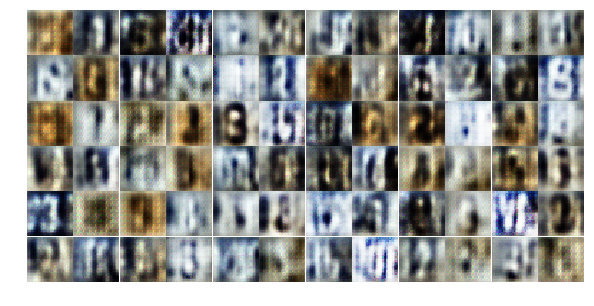

Epoch 2/25... Discriminator Loss: 0.6010... Generator Loss: 1.4834
Epoch 2/25... Discriminator Loss: 1.0014... Generator Loss: 1.1274
Epoch 2/25... Discriminator Loss: 0.5007... Generator Loss: 2.0873
Epoch 2/25... Discriminator Loss: 0.5783... Generator Loss: 1.4321
Epoch 2/25... Discriminator Loss: 0.4599... Generator Loss: 1.6609
Epoch 2/25... Discriminator Loss: 0.9233... Generator Loss: 1.4977
Epoch 2/25... Discriminator Loss: 0.7023... Generator Loss: 1.6631
Epoch 2/25... Discriminator Loss: 0.9350... Generator Loss: 0.8280
Epoch 2/25... Discriminator Loss: 0.5222... Generator Loss: 1.4620
Epoch 2/25... Discriminator Loss: 1.1438... Generator Loss: 0.6593


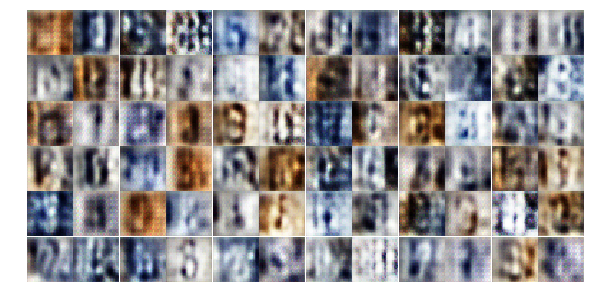

Epoch 2/25... Discriminator Loss: 0.6488... Generator Loss: 1.2798
Epoch 2/25... Discriminator Loss: 0.5229... Generator Loss: 1.3976
Epoch 2/25... Discriminator Loss: 1.0968... Generator Loss: 0.7022
Epoch 2/25... Discriminator Loss: 0.8631... Generator Loss: 0.9208
Epoch 2/25... Discriminator Loss: 0.8987... Generator Loss: 2.4163
Epoch 2/25... Discriminator Loss: 0.6970... Generator Loss: 1.8728
Epoch 2/25... Discriminator Loss: 0.6628... Generator Loss: 1.3276
Epoch 2/25... Discriminator Loss: 0.8794... Generator Loss: 0.8398
Epoch 2/25... Discriminator Loss: 0.9198... Generator Loss: 0.7356
Epoch 2/25... Discriminator Loss: 1.0017... Generator Loss: 0.7317


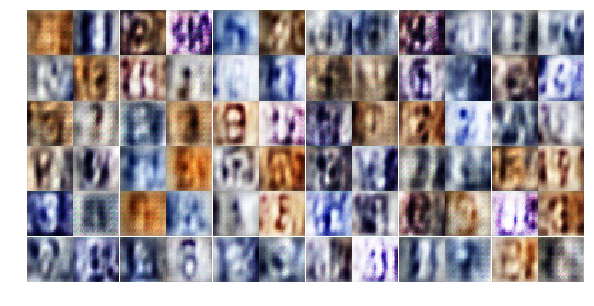

Epoch 2/25... Discriminator Loss: 0.9012... Generator Loss: 1.0309
Epoch 2/25... Discriminator Loss: 0.6570... Generator Loss: 1.2230
Epoch 2/25... Discriminator Loss: 0.8048... Generator Loss: 1.1719
Epoch 2/25... Discriminator Loss: 0.7474... Generator Loss: 0.9014
Epoch 2/25... Discriminator Loss: 0.3311... Generator Loss: 2.3410
Epoch 2/25... Discriminator Loss: 0.8174... Generator Loss: 1.6185
Epoch 2/25... Discriminator Loss: 0.7067... Generator Loss: 2.9563
Epoch 2/25... Discriminator Loss: 0.6786... Generator Loss: 1.7247
Epoch 2/25... Discriminator Loss: 0.8000... Generator Loss: 1.1688
Epoch 2/25... Discriminator Loss: 0.3301... Generator Loss: 2.3462


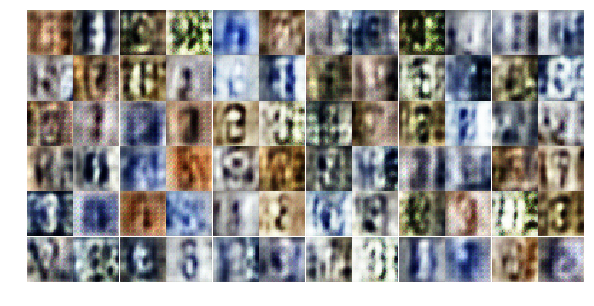

Epoch 2/25... Discriminator Loss: 0.9579... Generator Loss: 4.2278
Epoch 2/25... Discriminator Loss: 1.0870... Generator Loss: 1.0620
Epoch 2/25... Discriminator Loss: 0.6892... Generator Loss: 1.9220
Epoch 2/25... Discriminator Loss: 0.7362... Generator Loss: 1.0576
Epoch 2/25... Discriminator Loss: 1.0655... Generator Loss: 0.6112
Epoch 2/25... Discriminator Loss: 0.6070... Generator Loss: 1.2211
Epoch 2/25... Discriminator Loss: 0.2837... Generator Loss: 2.6930
Epoch 2/25... Discriminator Loss: 0.7197... Generator Loss: 1.9480
Epoch 2/25... Discriminator Loss: 0.8948... Generator Loss: 3.3477
Epoch 2/25... Discriminator Loss: 0.8716... Generator Loss: 1.3464


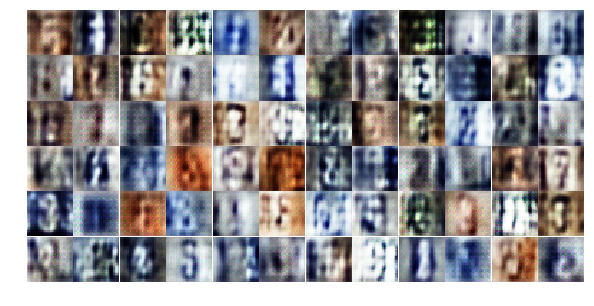

Epoch 2/25... Discriminator Loss: 0.6223... Generator Loss: 1.4048
Epoch 2/25... Discriminator Loss: 0.3973... Generator Loss: 1.9098
Epoch 2/25... Discriminator Loss: 0.2290... Generator Loss: 2.0350
Epoch 2/25... Discriminator Loss: 0.7309... Generator Loss: 1.1806
Epoch 3/25... Discriminator Loss: 0.4382... Generator Loss: 2.9318
Epoch 3/25... Discriminator Loss: 0.3777... Generator Loss: 2.8906
Epoch 3/25... Discriminator Loss: 0.6931... Generator Loss: 3.5618
Epoch 3/25... Discriminator Loss: 1.1341... Generator Loss: 3.2422
Epoch 3/25... Discriminator Loss: 0.4403... Generator Loss: 1.4355
Epoch 3/25... Discriminator Loss: 0.6993... Generator Loss: 1.4575


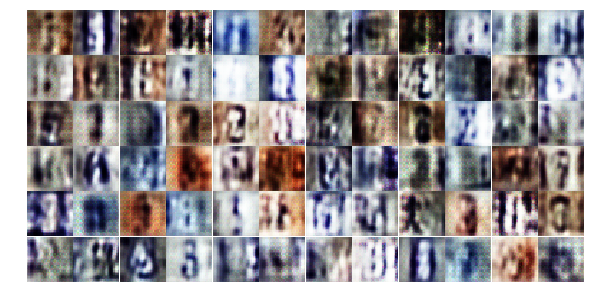

Epoch 3/25... Discriminator Loss: 0.6486... Generator Loss: 3.3251
Epoch 3/25... Discriminator Loss: 0.2159... Generator Loss: 2.2874
Epoch 3/25... Discriminator Loss: 0.5177... Generator Loss: 3.5628
Epoch 3/25... Discriminator Loss: 1.2917... Generator Loss: 0.5038
Epoch 3/25... Discriminator Loss: 0.5311... Generator Loss: 1.3006
Epoch 3/25... Discriminator Loss: 0.3360... Generator Loss: 1.6723
Epoch 3/25... Discriminator Loss: 0.6098... Generator Loss: 1.1985
Epoch 3/25... Discriminator Loss: 0.4712... Generator Loss: 1.3002
Epoch 3/25... Discriminator Loss: 0.3326... Generator Loss: 1.8949
Epoch 3/25... Discriminator Loss: 0.9526... Generator Loss: 0.6918


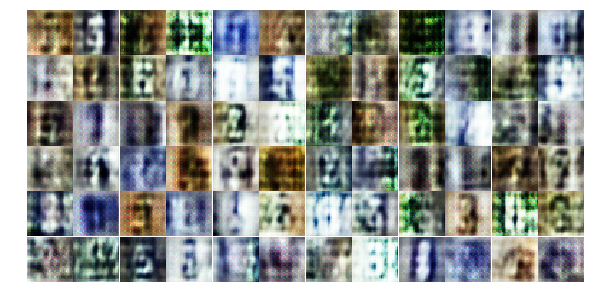

Epoch 3/25... Discriminator Loss: 0.7548... Generator Loss: 0.8578
Epoch 3/25... Discriminator Loss: 0.3365... Generator Loss: 3.5162
Epoch 3/25... Discriminator Loss: 0.1420... Generator Loss: 2.9096
Epoch 3/25... Discriminator Loss: 0.3556... Generator Loss: 1.7175
Epoch 3/25... Discriminator Loss: 0.2626... Generator Loss: 3.2569
Epoch 3/25... Discriminator Loss: 1.1558... Generator Loss: 0.5499
Epoch 3/25... Discriminator Loss: 0.1749... Generator Loss: 3.0159
Epoch 3/25... Discriminator Loss: 0.4085... Generator Loss: 1.4466
Epoch 3/25... Discriminator Loss: 0.4610... Generator Loss: 1.4477
Epoch 3/25... Discriminator Loss: 0.4079... Generator Loss: 3.8666


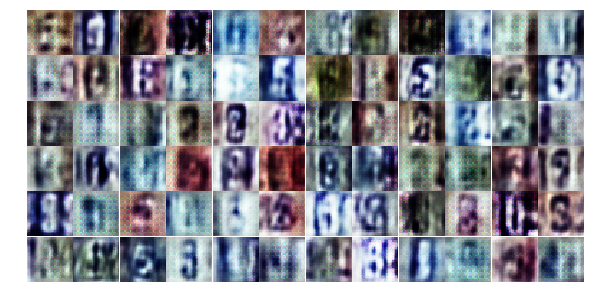

Epoch 3/25... Discriminator Loss: 0.1616... Generator Loss: 4.9621
Epoch 3/25... Discriminator Loss: 0.2356... Generator Loss: 1.7994
Epoch 3/25... Discriminator Loss: 1.1302... Generator Loss: 0.6967
Epoch 3/25... Discriminator Loss: 0.9210... Generator Loss: 1.8072
Epoch 3/25... Discriminator Loss: 1.0651... Generator Loss: 0.6495
Epoch 3/25... Discriminator Loss: 0.4185... Generator Loss: 2.0575
Epoch 3/25... Discriminator Loss: 0.1919... Generator Loss: 2.8448
Epoch 3/25... Discriminator Loss: 0.5270... Generator Loss: 4.4744
Epoch 3/25... Discriminator Loss: 0.6399... Generator Loss: 1.0429
Epoch 3/25... Discriminator Loss: 2.3562... Generator Loss: 5.0650


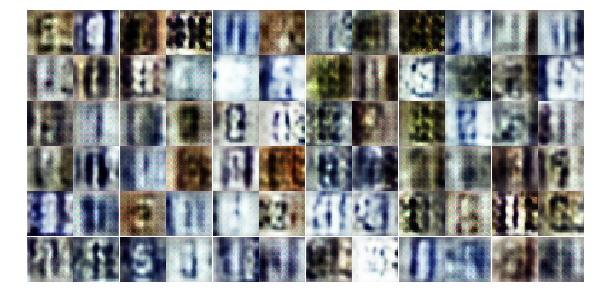

Epoch 3/25... Discriminator Loss: 0.4336... Generator Loss: 1.9534
Epoch 3/25... Discriminator Loss: 0.2488... Generator Loss: 2.0685
Epoch 3/25... Discriminator Loss: 0.8511... Generator Loss: 0.9646
Epoch 3/25... Discriminator Loss: 0.2344... Generator Loss: 2.4874
Epoch 3/25... Discriminator Loss: 0.1428... Generator Loss: 2.9270
Epoch 3/25... Discriminator Loss: 0.2421... Generator Loss: 4.0011
Epoch 3/25... Discriminator Loss: 0.1466... Generator Loss: 3.0116
Epoch 3/25... Discriminator Loss: 0.3293... Generator Loss: 2.4364
Epoch 3/25... Discriminator Loss: 0.3769... Generator Loss: 3.4663
Epoch 3/25... Discriminator Loss: 1.0098... Generator Loss: 3.7031


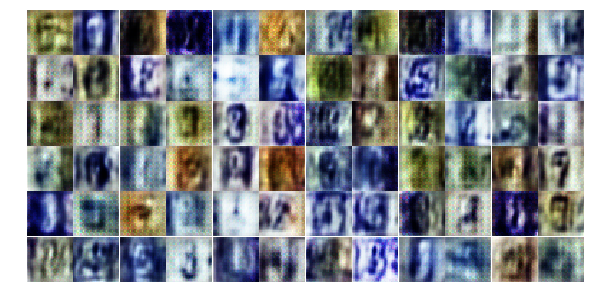

Epoch 3/25... Discriminator Loss: 0.3342... Generator Loss: 1.8534
Epoch 3/25... Discriminator Loss: 0.5609... Generator Loss: 2.2722
Epoch 3/25... Discriminator Loss: 0.9910... Generator Loss: 0.6751
Epoch 3/25... Discriminator Loss: 0.2423... Generator Loss: 3.9379
Epoch 3/25... Discriminator Loss: 1.6913... Generator Loss: 4.5208
Epoch 3/25... Discriminator Loss: 0.3660... Generator Loss: 2.4821
Epoch 3/25... Discriminator Loss: 0.1182... Generator Loss: 3.7588
Epoch 3/25... Discriminator Loss: 0.2433... Generator Loss: 3.1059
Epoch 3/25... Discriminator Loss: 0.4709... Generator Loss: 1.4879
Epoch 3/25... Discriminator Loss: 0.0922... Generator Loss: 4.5097


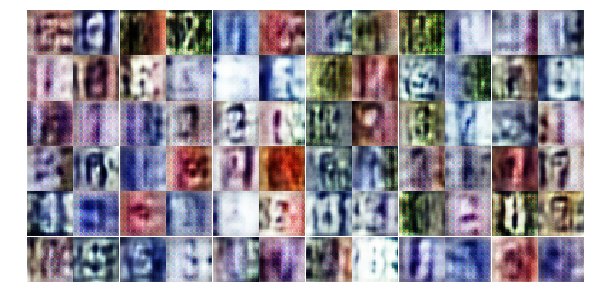

Epoch 3/25... Discriminator Loss: 0.3783... Generator Loss: 5.3994
Epoch 4/25... Discriminator Loss: 0.6623... Generator Loss: 0.9849
Epoch 4/25... Discriminator Loss: 3.0807... Generator Loss: 5.8146
Epoch 4/25... Discriminator Loss: 0.6869... Generator Loss: 1.4239
Epoch 4/25... Discriminator Loss: 0.8923... Generator Loss: 3.0829
Epoch 4/25... Discriminator Loss: 1.4007... Generator Loss: 2.4428
Epoch 4/25... Discriminator Loss: 0.5377... Generator Loss: 1.6740
Epoch 4/25... Discriminator Loss: 0.3133... Generator Loss: 3.1803
Epoch 4/25... Discriminator Loss: 0.3687... Generator Loss: 3.1315
Epoch 4/25... Discriminator Loss: 0.3085... Generator Loss: 1.7918


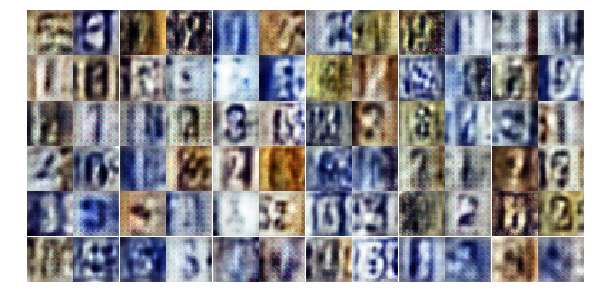

Epoch 4/25... Discriminator Loss: 1.0728... Generator Loss: 0.5535
Epoch 4/25... Discriminator Loss: 0.1418... Generator Loss: 3.6593
Epoch 4/25... Discriminator Loss: 1.4279... Generator Loss: 0.5524
Epoch 4/25... Discriminator Loss: 1.6369... Generator Loss: 0.3804
Epoch 4/25... Discriminator Loss: 0.7974... Generator Loss: 1.7225
Epoch 4/25... Discriminator Loss: 0.9738... Generator Loss: 0.6952
Epoch 4/25... Discriminator Loss: 0.7006... Generator Loss: 0.9965
Epoch 4/25... Discriminator Loss: 0.1839... Generator Loss: 3.0960
Epoch 4/25... Discriminator Loss: 0.3438... Generator Loss: 2.6622
Epoch 4/25... Discriminator Loss: 0.3611... Generator Loss: 1.8501


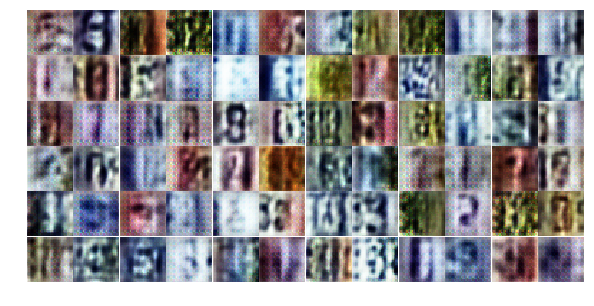

Epoch 4/25... Discriminator Loss: 0.2134... Generator Loss: 3.0723
Epoch 4/25... Discriminator Loss: 0.4264... Generator Loss: 1.9015
Epoch 4/25... Discriminator Loss: 0.3218... Generator Loss: 1.7421
Epoch 4/25... Discriminator Loss: 0.4380... Generator Loss: 1.4282
Epoch 4/25... Discriminator Loss: 0.2266... Generator Loss: 2.4305
Epoch 4/25... Discriminator Loss: 0.2548... Generator Loss: 3.7215
Epoch 4/25... Discriminator Loss: 0.8677... Generator Loss: 0.8131
Epoch 4/25... Discriminator Loss: 0.8599... Generator Loss: 0.8802
Epoch 4/25... Discriminator Loss: 0.2497... Generator Loss: 3.3117
Epoch 4/25... Discriminator Loss: 0.5908... Generator Loss: 1.4242


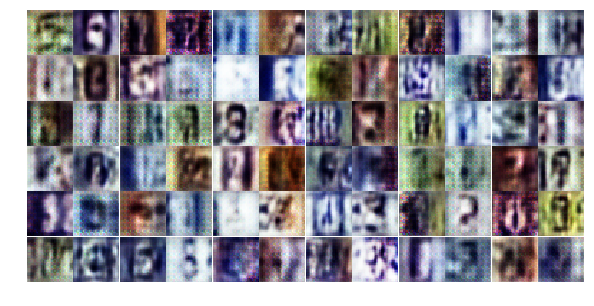

Epoch 4/25... Discriminator Loss: 0.3219... Generator Loss: 2.7765
Epoch 4/25... Discriminator Loss: 0.2106... Generator Loss: 3.0401
Epoch 4/25... Discriminator Loss: 0.3039... Generator Loss: 3.6709
Epoch 4/25... Discriminator Loss: 0.8630... Generator Loss: 0.8571
Epoch 4/25... Discriminator Loss: 0.1074... Generator Loss: 3.7521
Epoch 4/25... Discriminator Loss: 0.2175... Generator Loss: 2.6454
Epoch 4/25... Discriminator Loss: 0.5501... Generator Loss: 1.3604
Epoch 4/25... Discriminator Loss: 0.9075... Generator Loss: 0.7453
Epoch 4/25... Discriminator Loss: 0.9022... Generator Loss: 0.7850
Epoch 4/25... Discriminator Loss: 0.3318... Generator Loss: 1.8787


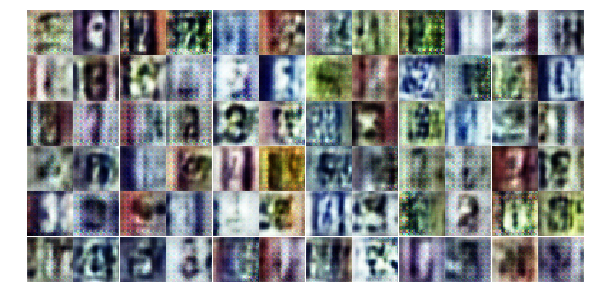

Epoch 4/25... Discriminator Loss: 0.2434... Generator Loss: 3.0702
Epoch 4/25... Discriminator Loss: 0.1255... Generator Loss: 3.3280
Epoch 4/25... Discriminator Loss: 0.3059... Generator Loss: 1.8433
Epoch 4/25... Discriminator Loss: 0.5053... Generator Loss: 1.3116
Epoch 4/25... Discriminator Loss: 0.1179... Generator Loss: 2.8763
Epoch 4/25... Discriminator Loss: 0.6086... Generator Loss: 1.0890
Epoch 4/25... Discriminator Loss: 0.8158... Generator Loss: 1.8902
Epoch 4/25... Discriminator Loss: 0.5836... Generator Loss: 1.3640
Epoch 4/25... Discriminator Loss: 0.9205... Generator Loss: 0.7587
Epoch 4/25... Discriminator Loss: 0.9789... Generator Loss: 0.6122


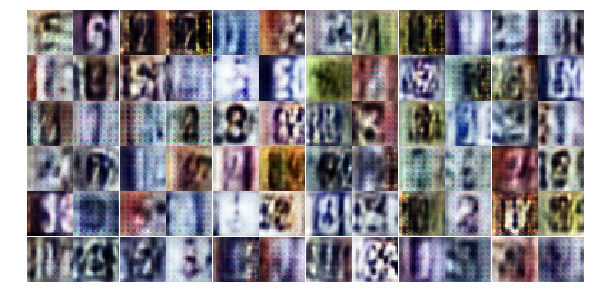

Epoch 4/25... Discriminator Loss: 0.8767... Generator Loss: 0.8004
Epoch 4/25... Discriminator Loss: 0.1664... Generator Loss: 3.3245
Epoch 4/25... Discriminator Loss: 0.3140... Generator Loss: 2.8485
Epoch 4/25... Discriminator Loss: 0.3998... Generator Loss: 1.6052
Epoch 4/25... Discriminator Loss: 1.2619... Generator Loss: 0.5015
Epoch 4/25... Discriminator Loss: 1.0148... Generator Loss: 2.0165
Epoch 4/25... Discriminator Loss: 0.4384... Generator Loss: 1.4073
Epoch 4/25... Discriminator Loss: 0.6404... Generator Loss: 1.1617
Epoch 4/25... Discriminator Loss: 0.2617... Generator Loss: 2.1740
Epoch 5/25... Discriminator Loss: 1.1525... Generator Loss: 2.8917


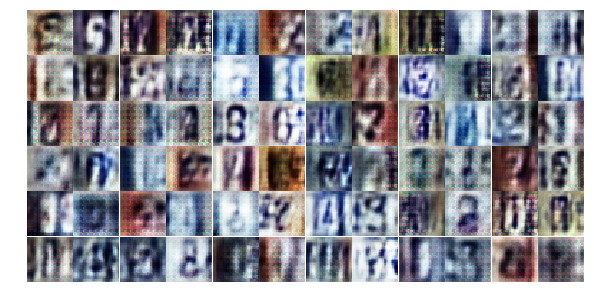

Epoch 5/25... Discriminator Loss: 0.4207... Generator Loss: 1.8701
Epoch 5/25... Discriminator Loss: 1.4823... Generator Loss: 0.4105
Epoch 5/25... Discriminator Loss: 0.3244... Generator Loss: 2.8965
Epoch 5/25... Discriminator Loss: 0.5221... Generator Loss: 1.3867
Epoch 5/25... Discriminator Loss: 0.1893... Generator Loss: 2.4179
Epoch 5/25... Discriminator Loss: 0.1512... Generator Loss: 2.5184
Epoch 5/25... Discriminator Loss: 1.1648... Generator Loss: 3.1535
Epoch 5/25... Discriminator Loss: 0.6292... Generator Loss: 1.3055
Epoch 5/25... Discriminator Loss: 0.7790... Generator Loss: 1.0618
Epoch 5/25... Discriminator Loss: 1.1809... Generator Loss: 0.5109


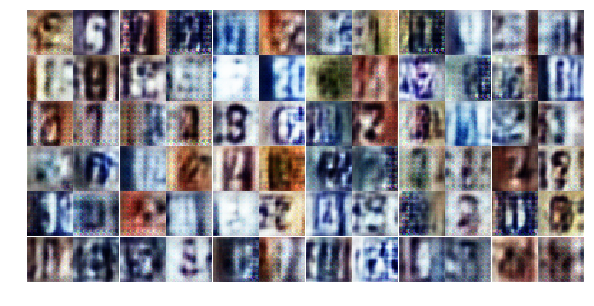

Epoch 5/25... Discriminator Loss: 0.9622... Generator Loss: 0.8725
Epoch 5/25... Discriminator Loss: 0.4307... Generator Loss: 1.4117
Epoch 5/25... Discriminator Loss: 0.4431... Generator Loss: 1.6401
Epoch 5/25... Discriminator Loss: 0.5420... Generator Loss: 1.1215
Epoch 5/25... Discriminator Loss: 0.7758... Generator Loss: 0.7916
Epoch 5/25... Discriminator Loss: 1.3889... Generator Loss: 0.3927
Epoch 5/25... Discriminator Loss: 1.0107... Generator Loss: 3.2298
Epoch 5/25... Discriminator Loss: 0.6039... Generator Loss: 1.0464
Epoch 5/25... Discriminator Loss: 0.1957... Generator Loss: 2.4866
Epoch 5/25... Discriminator Loss: 0.4133... Generator Loss: 1.8376


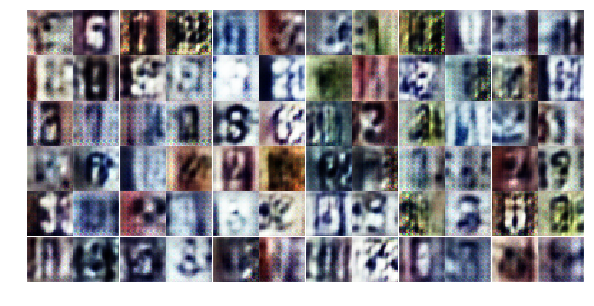

Epoch 5/25... Discriminator Loss: 0.7599... Generator Loss: 2.4115
Epoch 5/25... Discriminator Loss: 0.7017... Generator Loss: 0.9605
Epoch 5/25... Discriminator Loss: 0.6023... Generator Loss: 0.9894
Epoch 5/25... Discriminator Loss: 0.3534... Generator Loss: 1.6791
Epoch 5/25... Discriminator Loss: 0.4684... Generator Loss: 1.2321
Epoch 5/25... Discriminator Loss: 0.2264... Generator Loss: 2.0569
Epoch 5/25... Discriminator Loss: 1.4038... Generator Loss: 0.4649
Epoch 5/25... Discriminator Loss: 0.6833... Generator Loss: 1.2913
Epoch 5/25... Discriminator Loss: 0.7766... Generator Loss: 0.9229
Epoch 5/25... Discriminator Loss: 0.8556... Generator Loss: 2.4439


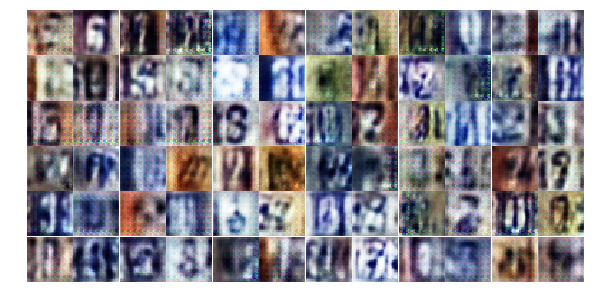

Epoch 5/25... Discriminator Loss: 0.7430... Generator Loss: 0.9692
Epoch 5/25... Discriminator Loss: 0.6712... Generator Loss: 0.9204
Epoch 5/25... Discriminator Loss: 0.4266... Generator Loss: 1.8514
Epoch 5/25... Discriminator Loss: 0.4800... Generator Loss: 1.7310
Epoch 5/25... Discriminator Loss: 0.3504... Generator Loss: 2.5850
Epoch 5/25... Discriminator Loss: 0.4395... Generator Loss: 2.0675
Epoch 5/25... Discriminator Loss: 0.6879... Generator Loss: 0.9372
Epoch 5/25... Discriminator Loss: 0.6334... Generator Loss: 0.9762
Epoch 5/25... Discriminator Loss: 0.3442... Generator Loss: 1.8259
Epoch 5/25... Discriminator Loss: 0.2635... Generator Loss: 1.9680


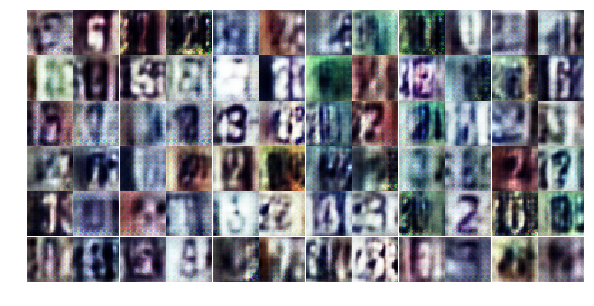

Epoch 5/25... Discriminator Loss: 0.4874... Generator Loss: 3.3825
Epoch 5/25... Discriminator Loss: 0.3290... Generator Loss: 2.1325
Epoch 5/25... Discriminator Loss: 0.5015... Generator Loss: 1.3222
Epoch 5/25... Discriminator Loss: 2.2422... Generator Loss: 0.1744
Epoch 5/25... Discriminator Loss: 0.9563... Generator Loss: 1.1382
Epoch 5/25... Discriminator Loss: 1.2404... Generator Loss: 0.4636
Epoch 5/25... Discriminator Loss: 1.0662... Generator Loss: 0.6638
Epoch 5/25... Discriminator Loss: 0.5317... Generator Loss: 1.4053
Epoch 5/25... Discriminator Loss: 0.8666... Generator Loss: 0.7625
Epoch 5/25... Discriminator Loss: 0.2606... Generator Loss: 1.9298


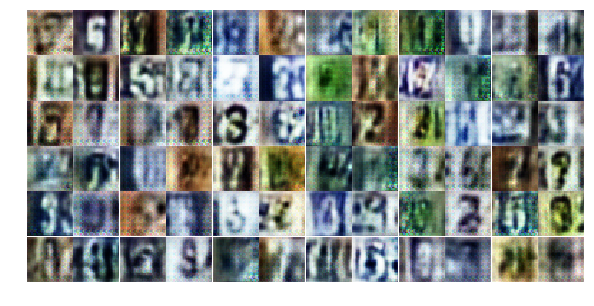

Epoch 5/25... Discriminator Loss: 1.0081... Generator Loss: 0.6205
Epoch 5/25... Discriminator Loss: 0.9085... Generator Loss: 0.8307
Epoch 5/25... Discriminator Loss: 0.7599... Generator Loss: 0.8791
Epoch 5/25... Discriminator Loss: 0.4936... Generator Loss: 1.2876
Epoch 5/25... Discriminator Loss: 0.6802... Generator Loss: 0.9675
Epoch 5/25... Discriminator Loss: 0.8582... Generator Loss: 0.9630
Epoch 6/25... Discriminator Loss: 0.4284... Generator Loss: 1.4568
Epoch 6/25... Discriminator Loss: 0.3866... Generator Loss: 1.4655
Epoch 6/25... Discriminator Loss: 0.4034... Generator Loss: 2.1765
Epoch 6/25... Discriminator Loss: 0.5430... Generator Loss: 1.2673


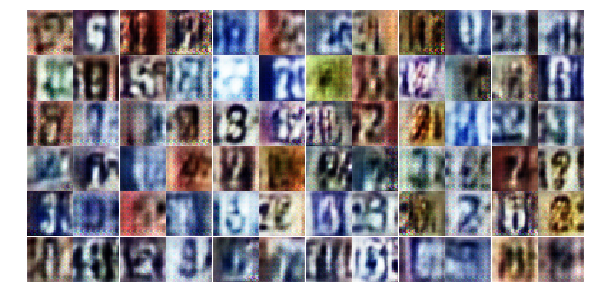

Epoch 6/25... Discriminator Loss: 0.1711... Generator Loss: 2.9561
Epoch 6/25... Discriminator Loss: 0.8148... Generator Loss: 2.1633
Epoch 6/25... Discriminator Loss: 1.3281... Generator Loss: 0.4079
Epoch 6/25... Discriminator Loss: 1.8438... Generator Loss: 0.2345
Epoch 6/25... Discriminator Loss: 1.7417... Generator Loss: 0.2727
Epoch 6/25... Discriminator Loss: 0.5879... Generator Loss: 1.1131
Epoch 6/25... Discriminator Loss: 0.8903... Generator Loss: 2.1605
Epoch 6/25... Discriminator Loss: 0.5432... Generator Loss: 1.5396
Epoch 6/25... Discriminator Loss: 0.6436... Generator Loss: 0.9688
Epoch 6/25... Discriminator Loss: 0.4888... Generator Loss: 3.0418


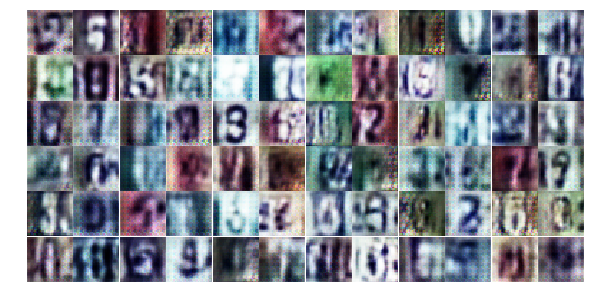

Epoch 6/25... Discriminator Loss: 0.8642... Generator Loss: 0.8550
Epoch 6/25... Discriminator Loss: 0.5665... Generator Loss: 1.6348
Epoch 6/25... Discriminator Loss: 0.4757... Generator Loss: 1.3539
Epoch 6/25... Discriminator Loss: 0.9946... Generator Loss: 0.6499
Epoch 6/25... Discriminator Loss: 0.4260... Generator Loss: 1.8012
Epoch 6/25... Discriminator Loss: 0.3135... Generator Loss: 1.8272
Epoch 6/25... Discriminator Loss: 0.6772... Generator Loss: 0.9474
Epoch 6/25... Discriminator Loss: 0.8672... Generator Loss: 0.7520
Epoch 6/25... Discriminator Loss: 0.4523... Generator Loss: 1.5751
Epoch 6/25... Discriminator Loss: 0.4045... Generator Loss: 2.4247


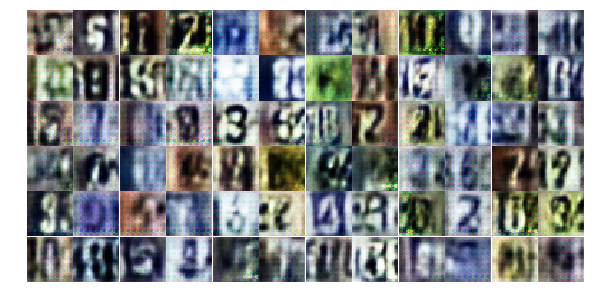

Epoch 6/25... Discriminator Loss: 0.7009... Generator Loss: 0.9250
Epoch 6/25... Discriminator Loss: 1.3359... Generator Loss: 0.4216
Epoch 6/25... Discriminator Loss: 0.9590... Generator Loss: 0.6832
Epoch 6/25... Discriminator Loss: 1.7391... Generator Loss: 0.2894
Epoch 6/25... Discriminator Loss: 0.5436... Generator Loss: 2.3096
Epoch 6/25... Discriminator Loss: 0.8432... Generator Loss: 0.8522
Epoch 6/25... Discriminator Loss: 0.3280... Generator Loss: 1.7826
Epoch 6/25... Discriminator Loss: 0.3608... Generator Loss: 1.6505
Epoch 6/25... Discriminator Loss: 0.3924... Generator Loss: 1.5169
Epoch 6/25... Discriminator Loss: 1.3693... Generator Loss: 3.4141


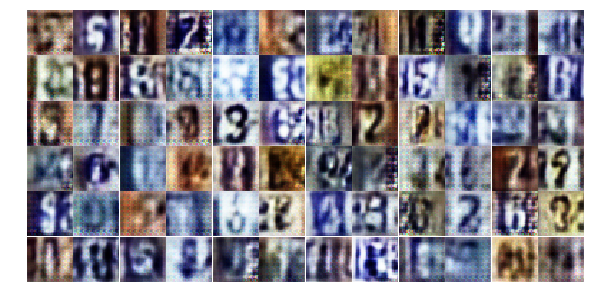

Epoch 6/25... Discriminator Loss: 1.2348... Generator Loss: 0.5105
Epoch 6/25... Discriminator Loss: 0.5715... Generator Loss: 1.7821
Epoch 6/25... Discriminator Loss: 0.6298... Generator Loss: 1.4660
Epoch 6/25... Discriminator Loss: 0.3815... Generator Loss: 1.5271
Epoch 6/25... Discriminator Loss: 0.6515... Generator Loss: 1.1074
Epoch 6/25... Discriminator Loss: 0.1706... Generator Loss: 2.4624
Epoch 6/25... Discriminator Loss: 1.1175... Generator Loss: 0.7198
Epoch 6/25... Discriminator Loss: 0.7749... Generator Loss: 3.0191
Epoch 6/25... Discriminator Loss: 0.8398... Generator Loss: 0.7641
Epoch 6/25... Discriminator Loss: 0.1971... Generator Loss: 2.2354


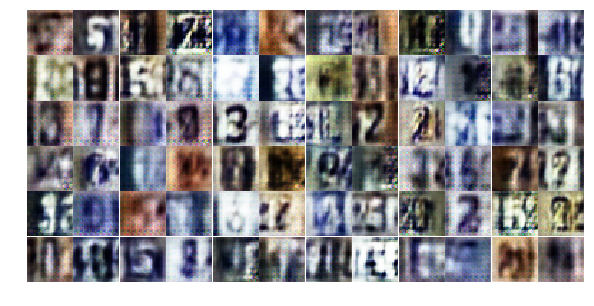

Epoch 6/25... Discriminator Loss: 0.5400... Generator Loss: 1.1953
Epoch 6/25... Discriminator Loss: 1.2839... Generator Loss: 0.4946
Epoch 6/25... Discriminator Loss: 1.6475... Generator Loss: 0.3097
Epoch 6/25... Discriminator Loss: 0.5976... Generator Loss: 1.2098
Epoch 6/25... Discriminator Loss: 0.3828... Generator Loss: 1.9562
Epoch 6/25... Discriminator Loss: 0.4444... Generator Loss: 1.4234
Epoch 6/25... Discriminator Loss: 0.6811... Generator Loss: 1.0524
Epoch 6/25... Discriminator Loss: 1.1673... Generator Loss: 0.5219
Epoch 6/25... Discriminator Loss: 0.5118... Generator Loss: 1.8889
Epoch 6/25... Discriminator Loss: 1.3663... Generator Loss: 0.4361


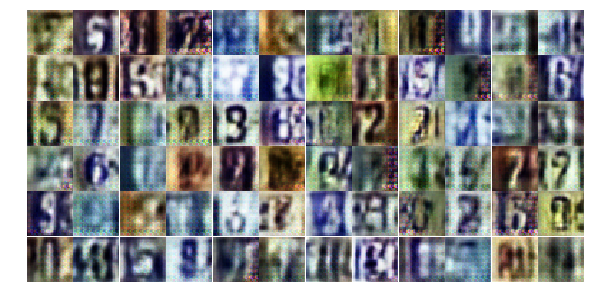

Epoch 6/25... Discriminator Loss: 0.6278... Generator Loss: 1.0874
Epoch 6/25... Discriminator Loss: 0.4442... Generator Loss: 1.5132
Epoch 6/25... Discriminator Loss: 0.5572... Generator Loss: 1.3454
Epoch 7/25... Discriminator Loss: 0.6849... Generator Loss: 1.9906
Epoch 7/25... Discriminator Loss: 0.4065... Generator Loss: 1.5270
Epoch 7/25... Discriminator Loss: 0.6243... Generator Loss: 2.2157
Epoch 7/25... Discriminator Loss: 0.4171... Generator Loss: 1.6102
Epoch 7/25... Discriminator Loss: 0.6094... Generator Loss: 1.4182
Epoch 7/25... Discriminator Loss: 0.5069... Generator Loss: 1.5593
Epoch 7/25... Discriminator Loss: 0.6591... Generator Loss: 1.0746


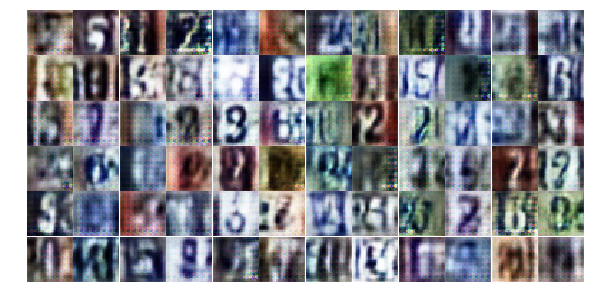

Epoch 7/25... Discriminator Loss: 0.5336... Generator Loss: 1.5757
Epoch 7/25... Discriminator Loss: 0.5690... Generator Loss: 1.4300
Epoch 7/25... Discriminator Loss: 1.2453... Generator Loss: 0.4314
Epoch 7/25... Discriminator Loss: 0.5088... Generator Loss: 1.3148
Epoch 7/25... Discriminator Loss: 0.3821... Generator Loss: 1.5488
Epoch 7/25... Discriminator Loss: 0.1659... Generator Loss: 2.7122
Epoch 7/25... Discriminator Loss: 0.5681... Generator Loss: 1.3191
Epoch 7/25... Discriminator Loss: 1.8394... Generator Loss: 3.3729
Epoch 7/25... Discriminator Loss: 1.0949... Generator Loss: 2.7284
Epoch 7/25... Discriminator Loss: 0.7451... Generator Loss: 2.0627


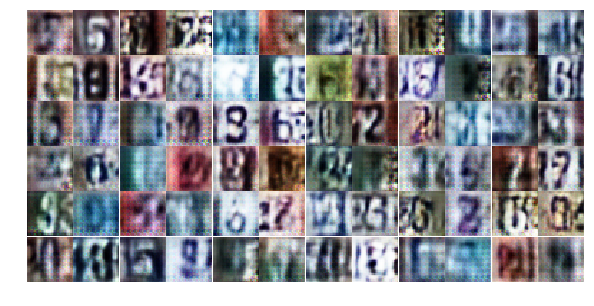

Epoch 7/25... Discriminator Loss: 0.7038... Generator Loss: 1.2620
Epoch 7/25... Discriminator Loss: 0.3966... Generator Loss: 1.8628
Epoch 7/25... Discriminator Loss: 0.6802... Generator Loss: 1.1591
Epoch 7/25... Discriminator Loss: 0.3962... Generator Loss: 1.6302
Epoch 7/25... Discriminator Loss: 0.4581... Generator Loss: 1.3799
Epoch 7/25... Discriminator Loss: 0.6158... Generator Loss: 2.6607
Epoch 7/25... Discriminator Loss: 0.5543... Generator Loss: 1.1676
Epoch 7/25... Discriminator Loss: 1.7298... Generator Loss: 0.2695
Epoch 7/25... Discriminator Loss: 0.4906... Generator Loss: 1.2583
Epoch 7/25... Discriminator Loss: 0.4281... Generator Loss: 2.0887


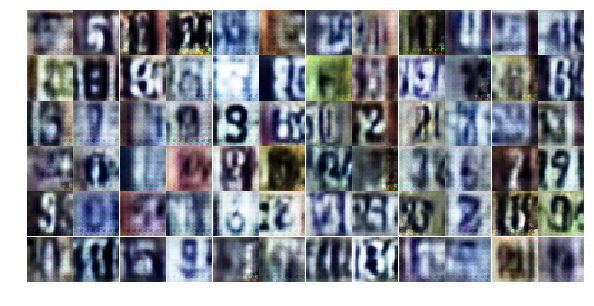

Epoch 7/25... Discriminator Loss: 1.3943... Generator Loss: 0.4131
Epoch 7/25... Discriminator Loss: 1.5244... Generator Loss: 0.3355
Epoch 7/25... Discriminator Loss: 0.4609... Generator Loss: 1.3905
Epoch 7/25... Discriminator Loss: 0.9244... Generator Loss: 0.7367
Epoch 7/25... Discriminator Loss: 0.8422... Generator Loss: 0.7302
Epoch 7/25... Discriminator Loss: 0.9247... Generator Loss: 0.6932
Epoch 7/25... Discriminator Loss: 0.2652... Generator Loss: 2.2429
Epoch 7/25... Discriminator Loss: 0.3593... Generator Loss: 1.6109
Epoch 7/25... Discriminator Loss: 0.9623... Generator Loss: 0.6663
Epoch 7/25... Discriminator Loss: 0.4966... Generator Loss: 2.3955


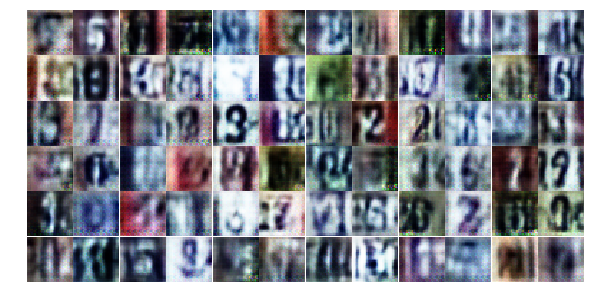

Epoch 7/25... Discriminator Loss: 1.2114... Generator Loss: 0.5220
Epoch 7/25... Discriminator Loss: 0.5777... Generator Loss: 1.1390
Epoch 7/25... Discriminator Loss: 0.4183... Generator Loss: 1.5707
Epoch 7/25... Discriminator Loss: 0.3470... Generator Loss: 1.7555
Epoch 7/25... Discriminator Loss: 0.7016... Generator Loss: 1.0824
Epoch 7/25... Discriminator Loss: 0.3826... Generator Loss: 1.7591
Epoch 7/25... Discriminator Loss: 0.5871... Generator Loss: 1.0729
Epoch 7/25... Discriminator Loss: 0.9617... Generator Loss: 0.6985
Epoch 7/25... Discriminator Loss: 0.4164... Generator Loss: 1.7603
Epoch 7/25... Discriminator Loss: 0.4199... Generator Loss: 1.6869


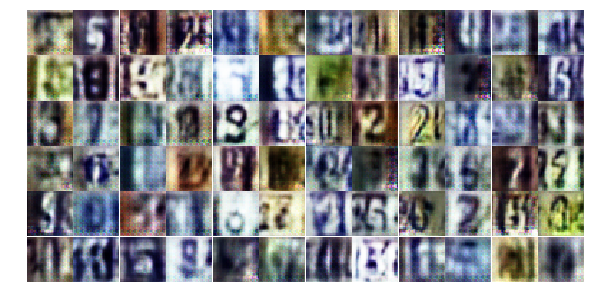

Epoch 7/25... Discriminator Loss: 0.2614... Generator Loss: 2.0373
Epoch 7/25... Discriminator Loss: 0.2766... Generator Loss: 2.0450
Epoch 7/25... Discriminator Loss: 0.7125... Generator Loss: 1.5262
Epoch 7/25... Discriminator Loss: 1.0130... Generator Loss: 0.6414
Epoch 7/25... Discriminator Loss: 0.6035... Generator Loss: 1.5380
Epoch 7/25... Discriminator Loss: 0.7566... Generator Loss: 0.9982
Epoch 7/25... Discriminator Loss: 1.3162... Generator Loss: 0.4885
Epoch 7/25... Discriminator Loss: 0.8243... Generator Loss: 0.8199
Epoch 7/25... Discriminator Loss: 0.6270... Generator Loss: 1.0441
Epoch 7/25... Discriminator Loss: 0.4308... Generator Loss: 1.5505


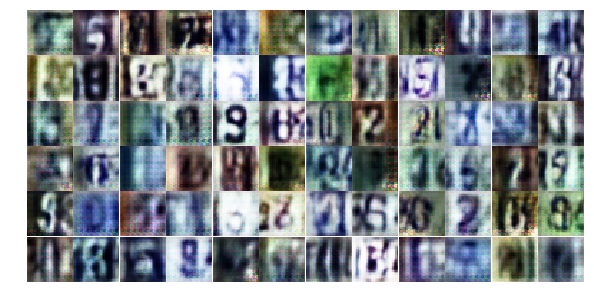

Epoch 7/25... Discriminator Loss: 0.7892... Generator Loss: 0.8724
Epoch 8/25... Discriminator Loss: 0.4511... Generator Loss: 1.4459
Epoch 8/25... Discriminator Loss: 0.8709... Generator Loss: 0.6985
Epoch 8/25... Discriminator Loss: 0.6597... Generator Loss: 0.9623
Epoch 8/25... Discriminator Loss: 0.3960... Generator Loss: 1.4965
Epoch 8/25... Discriminator Loss: 0.8317... Generator Loss: 0.7491
Epoch 8/25... Discriminator Loss: 0.8217... Generator Loss: 0.7864
Epoch 8/25... Discriminator Loss: 0.5000... Generator Loss: 2.2425
Epoch 8/25... Discriminator Loss: 1.1163... Generator Loss: 0.5557
Epoch 8/25... Discriminator Loss: 0.7680... Generator Loss: 0.9696


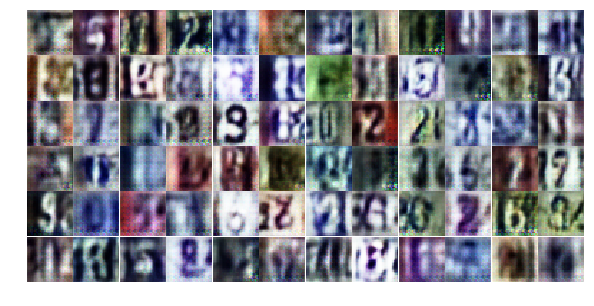

Epoch 8/25... Discriminator Loss: 0.4714... Generator Loss: 1.5964
Epoch 8/25... Discriminator Loss: 0.4556... Generator Loss: 1.6105
Epoch 8/25... Discriminator Loss: 1.1146... Generator Loss: 0.6231
Epoch 8/25... Discriminator Loss: 0.2883... Generator Loss: 2.2886
Epoch 8/25... Discriminator Loss: 0.7530... Generator Loss: 1.2166
Epoch 8/25... Discriminator Loss: 0.6383... Generator Loss: 1.7847
Epoch 8/25... Discriminator Loss: 0.4100... Generator Loss: 1.7214
Epoch 8/25... Discriminator Loss: 0.2154... Generator Loss: 3.0840
Epoch 8/25... Discriminator Loss: 0.3697... Generator Loss: 2.0148
Epoch 8/25... Discriminator Loss: 0.7577... Generator Loss: 1.1525


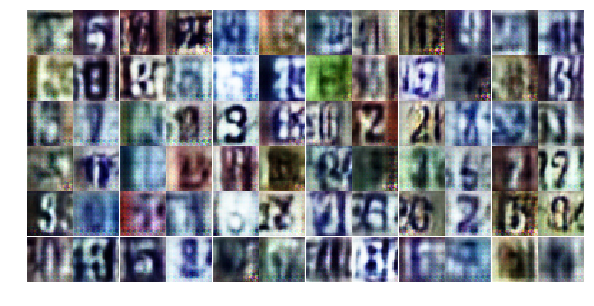

Epoch 8/25... Discriminator Loss: 0.4591... Generator Loss: 2.0866
Epoch 8/25... Discriminator Loss: 0.6437... Generator Loss: 1.0348
Epoch 8/25... Discriminator Loss: 0.4215... Generator Loss: 1.4921
Epoch 8/25... Discriminator Loss: 0.7203... Generator Loss: 2.3237
Epoch 8/25... Discriminator Loss: 0.4249... Generator Loss: 1.4750
Epoch 8/25... Discriminator Loss: 0.6859... Generator Loss: 2.0478
Epoch 8/25... Discriminator Loss: 0.7106... Generator Loss: 1.7104
Epoch 8/25... Discriminator Loss: 0.5088... Generator Loss: 1.7748
Epoch 8/25... Discriminator Loss: 0.6424... Generator Loss: 1.7189
Epoch 8/25... Discriminator Loss: 0.8868... Generator Loss: 0.7798


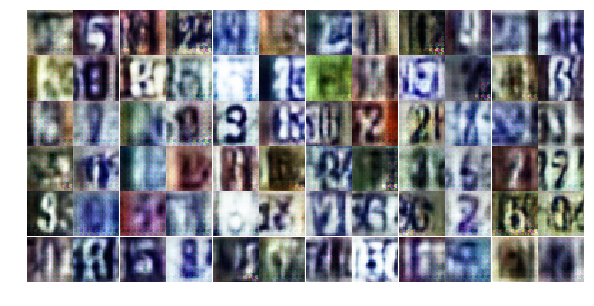

Epoch 8/25... Discriminator Loss: 0.3477... Generator Loss: 1.7305
Epoch 8/25... Discriminator Loss: 0.5795... Generator Loss: 1.0771
Epoch 8/25... Discriminator Loss: 0.5935... Generator Loss: 1.2289
Epoch 8/25... Discriminator Loss: 0.8409... Generator Loss: 0.7572
Epoch 8/25... Discriminator Loss: 1.9166... Generator Loss: 0.2346
Epoch 8/25... Discriminator Loss: 1.2827... Generator Loss: 3.4315
Epoch 8/25... Discriminator Loss: 0.7522... Generator Loss: 1.8983
Epoch 8/25... Discriminator Loss: 0.6708... Generator Loss: 1.0830
Epoch 8/25... Discriminator Loss: 0.5564... Generator Loss: 1.4583
Epoch 8/25... Discriminator Loss: 0.6199... Generator Loss: 1.0375


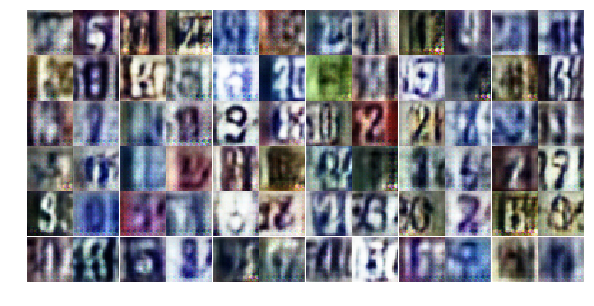

Epoch 8/25... Discriminator Loss: 0.5832... Generator Loss: 1.8536
Epoch 8/25... Discriminator Loss: 0.6642... Generator Loss: 1.0844
Epoch 8/25... Discriminator Loss: 0.5436... Generator Loss: 1.2049
Epoch 8/25... Discriminator Loss: 0.6254... Generator Loss: 1.0362
Epoch 8/25... Discriminator Loss: 3.1305... Generator Loss: 4.2454
Epoch 8/25... Discriminator Loss: 1.0804... Generator Loss: 0.6058
Epoch 8/25... Discriminator Loss: 0.9625... Generator Loss: 0.6877
Epoch 8/25... Discriminator Loss: 0.5562... Generator Loss: 1.1600
Epoch 8/25... Discriminator Loss: 0.4679... Generator Loss: 1.4151
Epoch 8/25... Discriminator Loss: 0.4808... Generator Loss: 1.3260


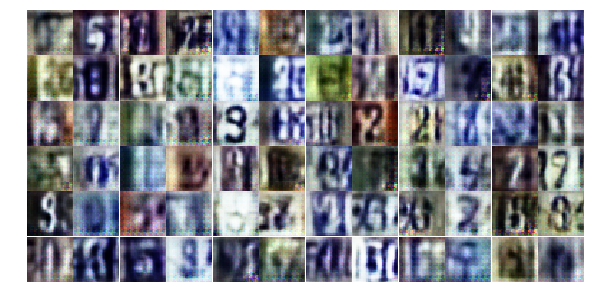

Epoch 8/25... Discriminator Loss: 0.4772... Generator Loss: 1.7366
Epoch 8/25... Discriminator Loss: 0.4119... Generator Loss: 1.7480
Epoch 8/25... Discriminator Loss: 0.3607... Generator Loss: 1.6680
Epoch 8/25... Discriminator Loss: 1.0015... Generator Loss: 0.6575
Epoch 8/25... Discriminator Loss: 0.3730... Generator Loss: 1.7001
Epoch 8/25... Discriminator Loss: 0.8175... Generator Loss: 0.8279
Epoch 8/25... Discriminator Loss: 0.9437... Generator Loss: 0.6266
Epoch 8/25... Discriminator Loss: 0.7578... Generator Loss: 2.4735
Epoch 9/25... Discriminator Loss: 0.7013... Generator Loss: 0.9220
Epoch 9/25... Discriminator Loss: 0.6676... Generator Loss: 0.9782


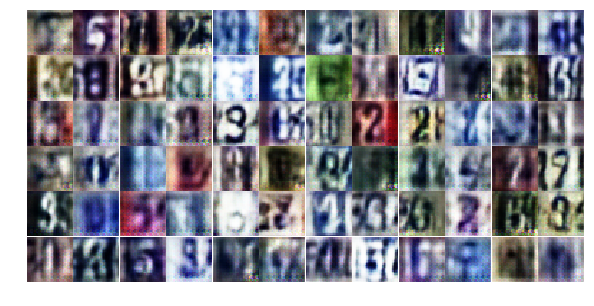

Epoch 9/25... Discriminator Loss: 0.5351... Generator Loss: 1.5778
Epoch 9/25... Discriminator Loss: 0.6497... Generator Loss: 1.8849
Epoch 9/25... Discriminator Loss: 1.4610... Generator Loss: 0.3640
Epoch 9/25... Discriminator Loss: 0.4269... Generator Loss: 1.5570
Epoch 9/25... Discriminator Loss: 0.8611... Generator Loss: 0.7863
Epoch 9/25... Discriminator Loss: 0.5283... Generator Loss: 1.2551
Epoch 9/25... Discriminator Loss: 0.7919... Generator Loss: 2.1615
Epoch 9/25... Discriminator Loss: 0.5781... Generator Loss: 1.1026
Epoch 9/25... Discriminator Loss: 0.5221... Generator Loss: 1.3866
Epoch 9/25... Discriminator Loss: 0.5235... Generator Loss: 1.2807


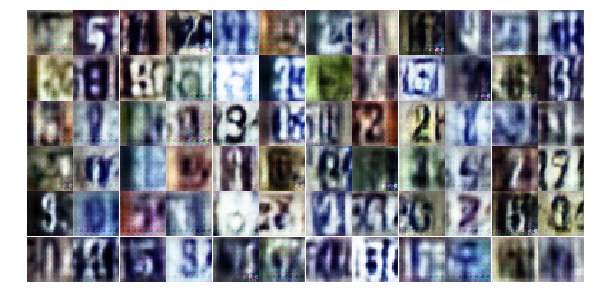

Epoch 9/25... Discriminator Loss: 0.9314... Generator Loss: 0.7234
Epoch 9/25... Discriminator Loss: 0.8879... Generator Loss: 0.8280
Epoch 9/25... Discriminator Loss: 0.6727... Generator Loss: 2.0751
Epoch 9/25... Discriminator Loss: 1.0576... Generator Loss: 0.6516
Epoch 9/25... Discriminator Loss: 0.4771... Generator Loss: 1.7268
Epoch 9/25... Discriminator Loss: 0.7698... Generator Loss: 0.8969
Epoch 9/25... Discriminator Loss: 0.5329... Generator Loss: 1.2498
Epoch 9/25... Discriminator Loss: 0.9203... Generator Loss: 0.6999
Epoch 9/25... Discriminator Loss: 1.2401... Generator Loss: 0.4762
Epoch 9/25... Discriminator Loss: 0.9785... Generator Loss: 0.7054


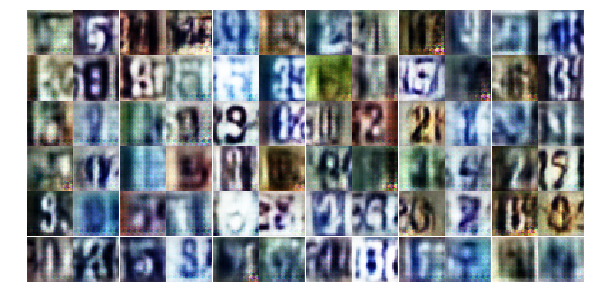

Epoch 9/25... Discriminator Loss: 1.0430... Generator Loss: 0.7075
Epoch 9/25... Discriminator Loss: 0.5177... Generator Loss: 1.4705
Epoch 9/25... Discriminator Loss: 0.6679... Generator Loss: 1.8109
Epoch 9/25... Discriminator Loss: 0.6410... Generator Loss: 1.0416
Epoch 9/25... Discriminator Loss: 0.4477... Generator Loss: 1.3634
Epoch 9/25... Discriminator Loss: 0.4191... Generator Loss: 1.4453
Epoch 9/25... Discriminator Loss: 1.3625... Generator Loss: 0.4594
Epoch 9/25... Discriminator Loss: 0.7641... Generator Loss: 0.9236
Epoch 9/25... Discriminator Loss: 0.4491... Generator Loss: 1.5341
Epoch 9/25... Discriminator Loss: 0.5100... Generator Loss: 1.3504


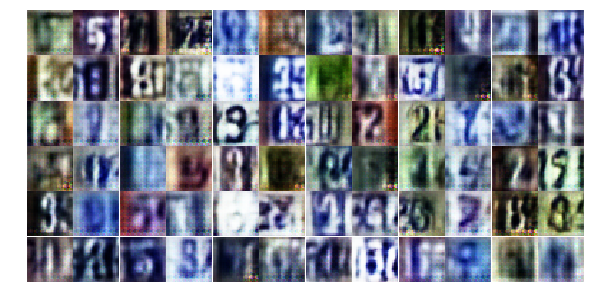

Epoch 9/25... Discriminator Loss: 0.4737... Generator Loss: 1.9153
Epoch 9/25... Discriminator Loss: 0.9051... Generator Loss: 0.8176
Epoch 9/25... Discriminator Loss: 0.6946... Generator Loss: 0.9653
Epoch 9/25... Discriminator Loss: 0.8556... Generator Loss: 2.1199
Epoch 9/25... Discriminator Loss: 0.5539... Generator Loss: 1.3061
Epoch 9/25... Discriminator Loss: 0.5825... Generator Loss: 1.2644
Epoch 9/25... Discriminator Loss: 0.6407... Generator Loss: 1.1150
Epoch 9/25... Discriminator Loss: 0.4405... Generator Loss: 1.3947
Epoch 9/25... Discriminator Loss: 0.4753... Generator Loss: 1.4333
Epoch 9/25... Discriminator Loss: 0.8079... Generator Loss: 0.8133


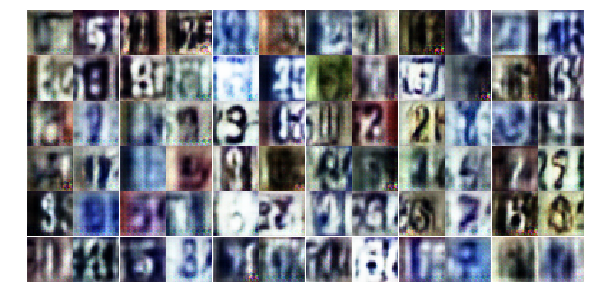

Epoch 9/25... Discriminator Loss: 0.4858... Generator Loss: 1.5667
Epoch 9/25... Discriminator Loss: 0.5061... Generator Loss: 1.2225
Epoch 9/25... Discriminator Loss: 0.4093... Generator Loss: 2.0496
Epoch 9/25... Discriminator Loss: 0.5940... Generator Loss: 1.2875
Epoch 9/25... Discriminator Loss: 0.3736... Generator Loss: 1.7237
Epoch 9/25... Discriminator Loss: 1.4529... Generator Loss: 0.3836
Epoch 9/25... Discriminator Loss: 0.6079... Generator Loss: 1.2428
Epoch 9/25... Discriminator Loss: 0.7801... Generator Loss: 0.8325
Epoch 9/25... Discriminator Loss: 0.5162... Generator Loss: 1.3162
Epoch 9/25... Discriminator Loss: 0.5338... Generator Loss: 2.2259


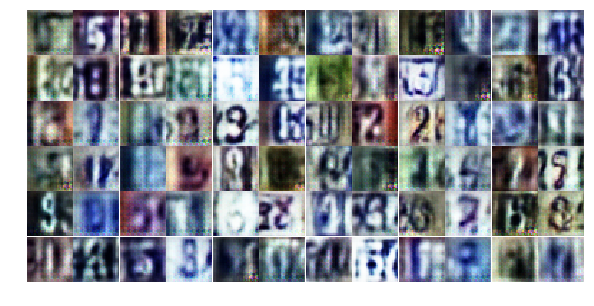

Epoch 9/25... Discriminator Loss: 1.3703... Generator Loss: 0.3975
Epoch 9/25... Discriminator Loss: 0.6682... Generator Loss: 1.1869
Epoch 9/25... Discriminator Loss: 0.5513... Generator Loss: 1.2731
Epoch 9/25... Discriminator Loss: 1.6478... Generator Loss: 0.3253
Epoch 9/25... Discriminator Loss: 0.7517... Generator Loss: 0.9389
Epoch 10/25... Discriminator Loss: 1.0808... Generator Loss: 0.6074
Epoch 10/25... Discriminator Loss: 0.6472... Generator Loss: 1.0124
Epoch 10/25... Discriminator Loss: 0.5651... Generator Loss: 1.7022
Epoch 10/25... Discriminator Loss: 0.6682... Generator Loss: 1.0454
Epoch 10/25... Discriminator Loss: 1.2535... Generator Loss: 0.4374


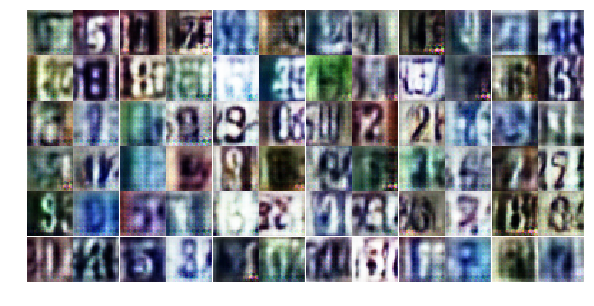

Epoch 10/25... Discriminator Loss: 1.0185... Generator Loss: 0.5982
Epoch 10/25... Discriminator Loss: 0.7872... Generator Loss: 0.8081
Epoch 10/25... Discriminator Loss: 0.6260... Generator Loss: 1.0451
Epoch 10/25... Discriminator Loss: 0.5592... Generator Loss: 1.1863
Epoch 10/25... Discriminator Loss: 0.6853... Generator Loss: 1.6893
Epoch 10/25... Discriminator Loss: 0.9114... Generator Loss: 0.8291
Epoch 10/25... Discriminator Loss: 0.2302... Generator Loss: 2.0831
Epoch 10/25... Discriminator Loss: 0.4837... Generator Loss: 1.3249
Epoch 10/25... Discriminator Loss: 1.4165... Generator Loss: 0.3873
Epoch 10/25... Discriminator Loss: 0.8537... Generator Loss: 0.8546


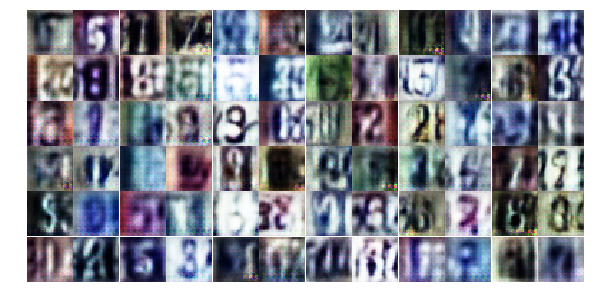

Epoch 10/25... Discriminator Loss: 0.6465... Generator Loss: 1.1615
Epoch 10/25... Discriminator Loss: 0.9219... Generator Loss: 0.7474
Epoch 10/25... Discriminator Loss: 0.8470... Generator Loss: 0.8617
Epoch 10/25... Discriminator Loss: 0.9854... Generator Loss: 0.6644
Epoch 10/25... Discriminator Loss: 0.6348... Generator Loss: 1.0413
Epoch 10/25... Discriminator Loss: 0.5268... Generator Loss: 1.4258
Epoch 10/25... Discriminator Loss: 1.5676... Generator Loss: 0.3977
Epoch 10/25... Discriminator Loss: 0.7464... Generator Loss: 1.1815
Epoch 10/25... Discriminator Loss: 0.5933... Generator Loss: 1.3501
Epoch 10/25... Discriminator Loss: 0.4794... Generator Loss: 2.5308


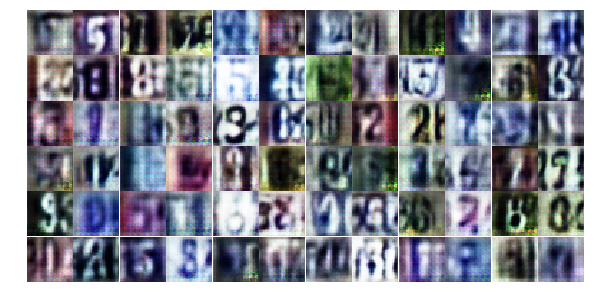

Epoch 10/25... Discriminator Loss: 0.8867... Generator Loss: 0.7114
Epoch 10/25... Discriminator Loss: 0.8164... Generator Loss: 0.9335
Epoch 10/25... Discriminator Loss: 0.3016... Generator Loss: 1.7106
Epoch 10/25... Discriminator Loss: 0.4676... Generator Loss: 2.3369
Epoch 10/25... Discriminator Loss: 1.2454... Generator Loss: 0.4728
Epoch 10/25... Discriminator Loss: 0.6124... Generator Loss: 2.0655
Epoch 10/25... Discriminator Loss: 0.5159... Generator Loss: 1.2102
Epoch 10/25... Discriminator Loss: 0.5117... Generator Loss: 1.2461
Epoch 10/25... Discriminator Loss: 0.4147... Generator Loss: 1.4859
Epoch 10/25... Discriminator Loss: 0.8449... Generator Loss: 1.6527


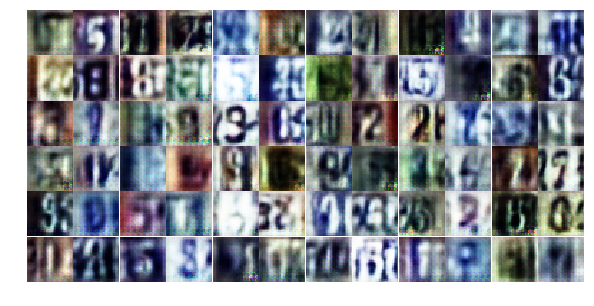

Epoch 10/25... Discriminator Loss: 1.2968... Generator Loss: 4.1527
Epoch 10/25... Discriminator Loss: 0.7963... Generator Loss: 0.9713
Epoch 10/25... Discriminator Loss: 0.5411... Generator Loss: 1.8173
Epoch 10/25... Discriminator Loss: 0.6098... Generator Loss: 1.1531
Epoch 10/25... Discriminator Loss: 0.6605... Generator Loss: 1.0533
Epoch 10/25... Discriminator Loss: 0.9760... Generator Loss: 0.6523
Epoch 10/25... Discriminator Loss: 1.0494... Generator Loss: 0.6001
Epoch 10/25... Discriminator Loss: 0.8019... Generator Loss: 0.9190
Epoch 10/25... Discriminator Loss: 1.1170... Generator Loss: 0.6199
Epoch 10/25... Discriminator Loss: 0.3869... Generator Loss: 1.5244


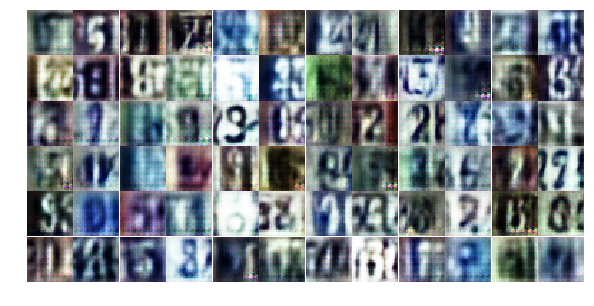

Epoch 10/25... Discriminator Loss: 0.5971... Generator Loss: 1.2853
Epoch 10/25... Discriminator Loss: 0.6918... Generator Loss: 1.0206
Epoch 10/25... Discriminator Loss: 1.0515... Generator Loss: 0.5770
Epoch 10/25... Discriminator Loss: 0.5649... Generator Loss: 1.1445
Epoch 10/25... Discriminator Loss: 0.2608... Generator Loss: 1.9594
Epoch 10/25... Discriminator Loss: 1.0910... Generator Loss: 2.9481
Epoch 10/25... Discriminator Loss: 0.8481... Generator Loss: 0.7541
Epoch 10/25... Discriminator Loss: 0.9958... Generator Loss: 1.7569
Epoch 10/25... Discriminator Loss: 1.9540... Generator Loss: 3.6274
Epoch 10/25... Discriminator Loss: 0.5839... Generator Loss: 1.1281


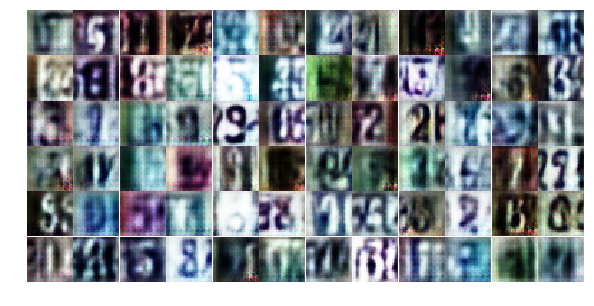

Epoch 10/25... Discriminator Loss: 0.8474... Generator Loss: 1.4454
Epoch 10/25... Discriminator Loss: 0.3973... Generator Loss: 1.9525
Epoch 10/25... Discriminator Loss: 0.6765... Generator Loss: 1.0028
Epoch 11/25... Discriminator Loss: 0.8382... Generator Loss: 0.9072
Epoch 11/25... Discriminator Loss: 0.6522... Generator Loss: 0.9241
Epoch 11/25... Discriminator Loss: 1.2863... Generator Loss: 0.4305
Epoch 11/25... Discriminator Loss: 0.5299... Generator Loss: 1.2585
Epoch 11/25... Discriminator Loss: 0.7526... Generator Loss: 2.3484
Epoch 11/25... Discriminator Loss: 1.8098... Generator Loss: 0.2722
Epoch 11/25... Discriminator Loss: 0.3247... Generator Loss: 2.1194


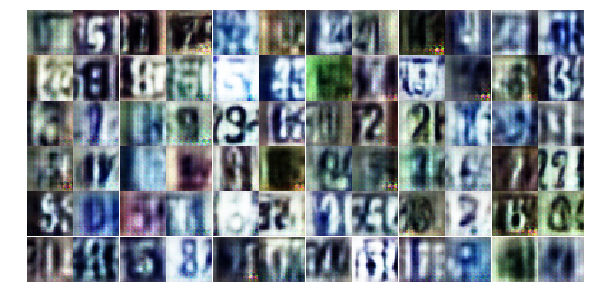

Epoch 11/25... Discriminator Loss: 0.3380... Generator Loss: 2.2889
Epoch 11/25... Discriminator Loss: 0.7877... Generator Loss: 0.8910
Epoch 11/25... Discriminator Loss: 0.4958... Generator Loss: 1.3163
Epoch 11/25... Discriminator Loss: 0.5651... Generator Loss: 1.1755
Epoch 11/25... Discriminator Loss: 0.8909... Generator Loss: 2.0525
Epoch 11/25... Discriminator Loss: 0.3534... Generator Loss: 1.6563
Epoch 11/25... Discriminator Loss: 0.6158... Generator Loss: 1.4548
Epoch 11/25... Discriminator Loss: 0.3306... Generator Loss: 2.0542
Epoch 11/25... Discriminator Loss: 0.9209... Generator Loss: 0.6958
Epoch 11/25... Discriminator Loss: 1.5246... Generator Loss: 0.4309


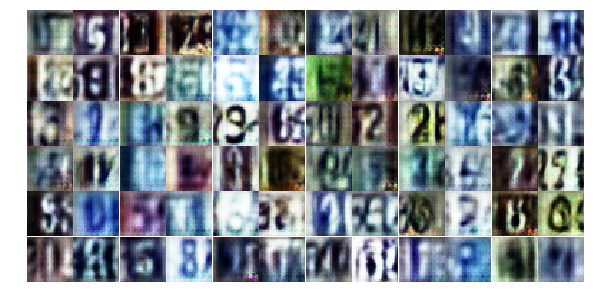

Epoch 11/25... Discriminator Loss: 0.5524... Generator Loss: 1.2644
Epoch 11/25... Discriminator Loss: 0.4353... Generator Loss: 1.3516
Epoch 11/25... Discriminator Loss: 0.6626... Generator Loss: 1.0125
Epoch 11/25... Discriminator Loss: 0.7651... Generator Loss: 0.8775
Epoch 11/25... Discriminator Loss: 0.3736... Generator Loss: 1.5204
Epoch 11/25... Discriminator Loss: 0.4349... Generator Loss: 1.4450
Epoch 11/25... Discriminator Loss: 0.4621... Generator Loss: 1.5254
Epoch 11/25... Discriminator Loss: 1.2594... Generator Loss: 0.4699
Epoch 11/25... Discriminator Loss: 0.4931... Generator Loss: 1.3005
Epoch 11/25... Discriminator Loss: 1.0912... Generator Loss: 0.5720


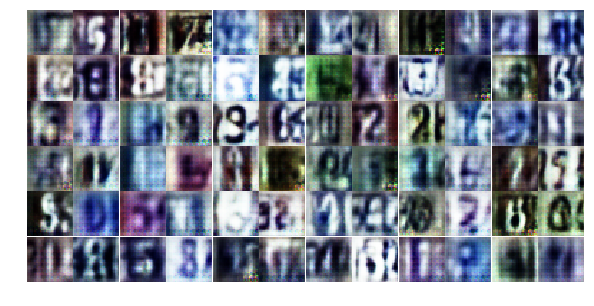

Epoch 11/25... Discriminator Loss: 0.7864... Generator Loss: 0.8692
Epoch 11/25... Discriminator Loss: 0.7252... Generator Loss: 0.9803
Epoch 11/25... Discriminator Loss: 0.7144... Generator Loss: 1.0477
Epoch 11/25... Discriminator Loss: 0.4253... Generator Loss: 1.7739
Epoch 11/25... Discriminator Loss: 0.6788... Generator Loss: 1.0163
Epoch 11/25... Discriminator Loss: 1.4366... Generator Loss: 0.4708
Epoch 11/25... Discriminator Loss: 0.8710... Generator Loss: 0.7843
Epoch 11/25... Discriminator Loss: 1.5129... Generator Loss: 0.3529
Epoch 11/25... Discriminator Loss: 0.5365... Generator Loss: 1.2535
Epoch 11/25... Discriminator Loss: 1.1743... Generator Loss: 1.8860


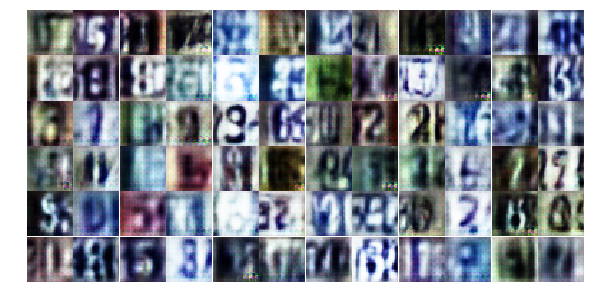

Epoch 11/25... Discriminator Loss: 0.5074... Generator Loss: 1.3491
Epoch 11/25... Discriminator Loss: 0.5784... Generator Loss: 1.2339
Epoch 11/25... Discriminator Loss: 0.8122... Generator Loss: 0.8136
Epoch 11/25... Discriminator Loss: 0.8101... Generator Loss: 0.7897
Epoch 11/25... Discriminator Loss: 0.6886... Generator Loss: 1.3119
Epoch 11/25... Discriminator Loss: 0.6274... Generator Loss: 1.1306
Epoch 11/25... Discriminator Loss: 0.3600... Generator Loss: 1.6912
Epoch 11/25... Discriminator Loss: 0.7319... Generator Loss: 0.9727
Epoch 11/25... Discriminator Loss: 1.5975... Generator Loss: 0.3059
Epoch 11/25... Discriminator Loss: 0.4685... Generator Loss: 1.3480


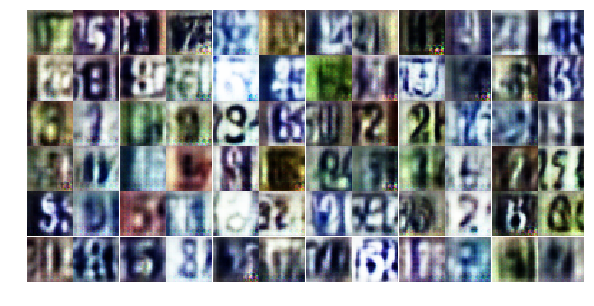

Epoch 11/25... Discriminator Loss: 0.8259... Generator Loss: 0.9359
Epoch 11/25... Discriminator Loss: 0.4407... Generator Loss: 1.5651
Epoch 11/25... Discriminator Loss: 0.3372... Generator Loss: 1.8086
Epoch 11/25... Discriminator Loss: 0.8883... Generator Loss: 0.7336
Epoch 11/25... Discriminator Loss: 1.0494... Generator Loss: 0.6207
Epoch 11/25... Discriminator Loss: 0.4955... Generator Loss: 1.2912
Epoch 11/25... Discriminator Loss: 0.6754... Generator Loss: 0.9929
Epoch 11/25... Discriminator Loss: 0.5923... Generator Loss: 2.9017
Epoch 11/25... Discriminator Loss: 0.9562... Generator Loss: 0.6848
Epoch 11/25... Discriminator Loss: 1.0722... Generator Loss: 0.6135


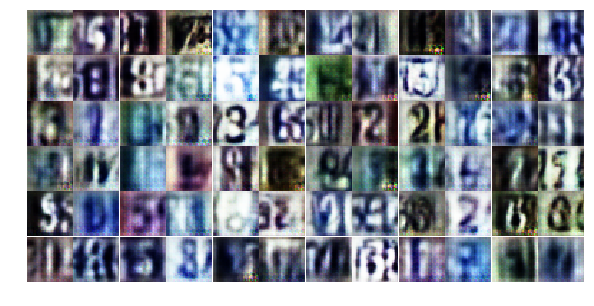

Epoch 12/25... Discriminator Loss: 0.4975... Generator Loss: 1.5227
Epoch 12/25... Discriminator Loss: 0.9995... Generator Loss: 0.6174
Epoch 12/25... Discriminator Loss: 0.5175... Generator Loss: 1.2929
Epoch 12/25... Discriminator Loss: 0.4478... Generator Loss: 1.3672
Epoch 12/25... Discriminator Loss: 0.4366... Generator Loss: 1.6899
Epoch 12/25... Discriminator Loss: 0.8679... Generator Loss: 0.7491
Epoch 12/25... Discriminator Loss: 0.5485... Generator Loss: 3.1064
Epoch 12/25... Discriminator Loss: 0.9196... Generator Loss: 0.8220
Epoch 12/25... Discriminator Loss: 0.6970... Generator Loss: 1.3482
Epoch 12/25... Discriminator Loss: 0.9730... Generator Loss: 0.7126


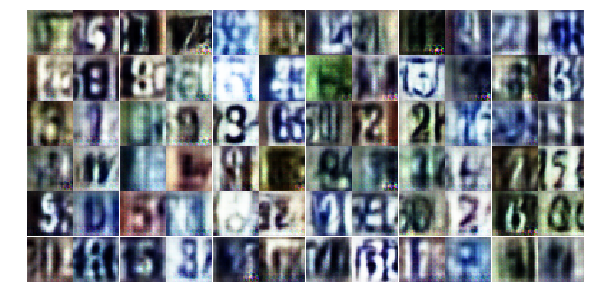

Epoch 12/25... Discriminator Loss: 0.8177... Generator Loss: 0.8528
Epoch 12/25... Discriminator Loss: 1.0639... Generator Loss: 0.7094
Epoch 12/25... Discriminator Loss: 0.6134... Generator Loss: 1.0555
Epoch 12/25... Discriminator Loss: 0.6682... Generator Loss: 1.0462
Epoch 12/25... Discriminator Loss: 0.4798... Generator Loss: 1.9516
Epoch 12/25... Discriminator Loss: 2.0303... Generator Loss: 1.4086
Epoch 12/25... Discriminator Loss: 0.7549... Generator Loss: 0.9601
Epoch 12/25... Discriminator Loss: 0.3769... Generator Loss: 2.1876
Epoch 12/25... Discriminator Loss: 0.6270... Generator Loss: 1.0615
Epoch 12/25... Discriminator Loss: 0.6631... Generator Loss: 1.1205


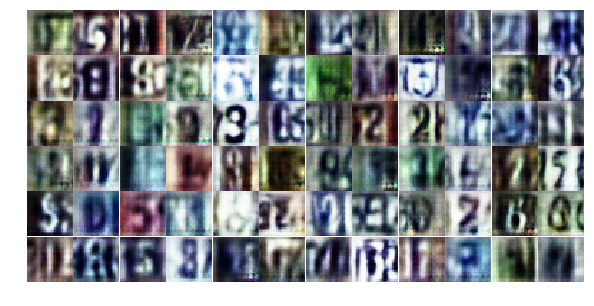

Epoch 12/25... Discriminator Loss: 0.4113... Generator Loss: 1.3729
Epoch 12/25... Discriminator Loss: 0.5821... Generator Loss: 2.0750
Epoch 12/25... Discriminator Loss: 0.8490... Generator Loss: 0.7867
Epoch 12/25... Discriminator Loss: 0.5106... Generator Loss: 1.2093
Epoch 12/25... Discriminator Loss: 0.3582... Generator Loss: 1.5040
Epoch 12/25... Discriminator Loss: 0.4623... Generator Loss: 1.3481
Epoch 12/25... Discriminator Loss: 0.5759... Generator Loss: 1.2583
Epoch 12/25... Discriminator Loss: 0.4648... Generator Loss: 1.7415
Epoch 12/25... Discriminator Loss: 0.7290... Generator Loss: 0.9887
Epoch 12/25... Discriminator Loss: 0.5437... Generator Loss: 1.2733


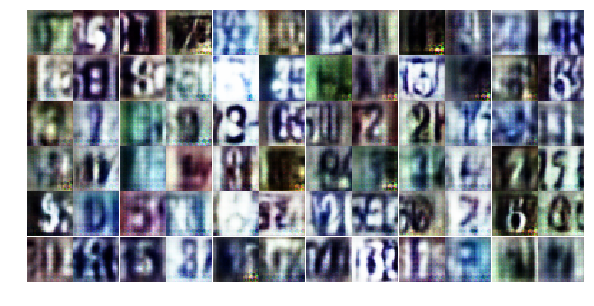

Epoch 12/25... Discriminator Loss: 0.5964... Generator Loss: 1.0522
Epoch 12/25... Discriminator Loss: 0.7348... Generator Loss: 0.9610
Epoch 12/25... Discriminator Loss: 0.6877... Generator Loss: 0.9807
Epoch 12/25... Discriminator Loss: 2.2304... Generator Loss: 0.1871
Epoch 12/25... Discriminator Loss: 0.7549... Generator Loss: 1.0740
Epoch 12/25... Discriminator Loss: 0.7309... Generator Loss: 1.0414
Epoch 12/25... Discriminator Loss: 0.8001... Generator Loss: 0.8688
Epoch 12/25... Discriminator Loss: 0.7449... Generator Loss: 1.0785
Epoch 12/25... Discriminator Loss: 0.5367... Generator Loss: 1.3857
Epoch 12/25... Discriminator Loss: 0.2381... Generator Loss: 1.9396


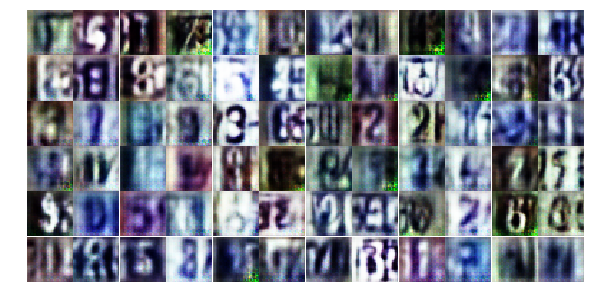

Epoch 12/25... Discriminator Loss: 0.7234... Generator Loss: 0.9549
Epoch 12/25... Discriminator Loss: 0.2837... Generator Loss: 1.9824
Epoch 12/25... Discriminator Loss: 0.5581... Generator Loss: 1.1688
Epoch 12/25... Discriminator Loss: 0.9071... Generator Loss: 0.7920
Epoch 12/25... Discriminator Loss: 1.3667... Generator Loss: 0.4737
Epoch 12/25... Discriminator Loss: 0.8778... Generator Loss: 0.7875
Epoch 12/25... Discriminator Loss: 0.6072... Generator Loss: 1.3006
Epoch 12/25... Discriminator Loss: 1.3244... Generator Loss: 0.5019
Epoch 12/25... Discriminator Loss: 0.6910... Generator Loss: 0.9647
Epoch 12/25... Discriminator Loss: 0.3365... Generator Loss: 1.6590


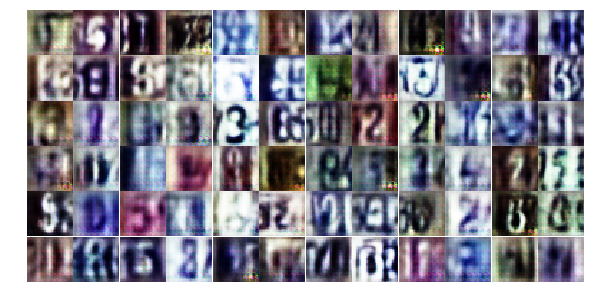

Epoch 12/25... Discriminator Loss: 1.3018... Generator Loss: 0.6068
Epoch 12/25... Discriminator Loss: 2.2445... Generator Loss: 0.1489
Epoch 12/25... Discriminator Loss: 0.5437... Generator Loss: 1.3833
Epoch 12/25... Discriminator Loss: 0.7257... Generator Loss: 1.0932
Epoch 12/25... Discriminator Loss: 0.9801... Generator Loss: 0.6398
Epoch 12/25... Discriminator Loss: 0.6129... Generator Loss: 1.9053
Epoch 12/25... Discriminator Loss: 1.0018... Generator Loss: 0.7507
Epoch 13/25... Discriminator Loss: 0.9260... Generator Loss: 0.7859
Epoch 13/25... Discriminator Loss: 0.3830... Generator Loss: 1.6011
Epoch 13/25... Discriminator Loss: 1.7763... Generator Loss: 0.2615


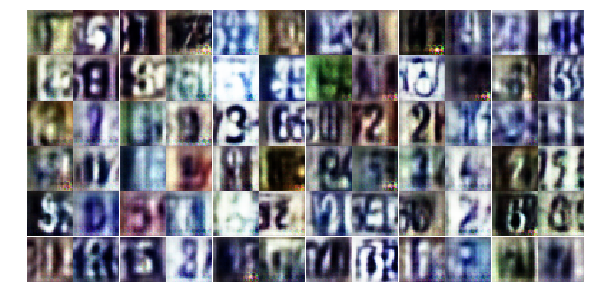

Epoch 13/25... Discriminator Loss: 1.6700... Generator Loss: 0.6895
Epoch 13/25... Discriminator Loss: 0.3975... Generator Loss: 1.6729
Epoch 13/25... Discriminator Loss: 0.9094... Generator Loss: 0.7433
Epoch 13/25... Discriminator Loss: 1.0896... Generator Loss: 0.5944
Epoch 13/25... Discriminator Loss: 0.5764... Generator Loss: 1.2459
Epoch 13/25... Discriminator Loss: 0.5853... Generator Loss: 1.1462
Epoch 13/25... Discriminator Loss: 0.3543... Generator Loss: 1.6726
Epoch 13/25... Discriminator Loss: 0.4970... Generator Loss: 1.3350
Epoch 13/25... Discriminator Loss: 0.4620... Generator Loss: 1.3896
Epoch 13/25... Discriminator Loss: 0.7440... Generator Loss: 2.8301


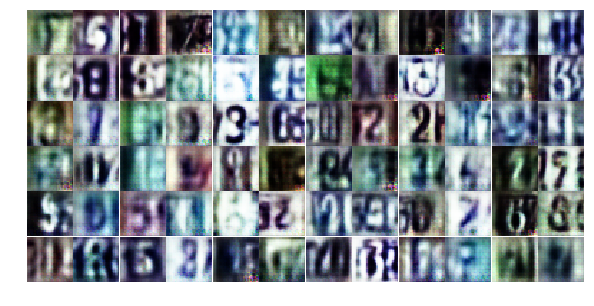

Epoch 13/25... Discriminator Loss: 0.5778... Generator Loss: 1.5855
Epoch 13/25... Discriminator Loss: 0.4379... Generator Loss: 1.5674
Epoch 13/25... Discriminator Loss: 1.0072... Generator Loss: 0.6893
Epoch 13/25... Discriminator Loss: 0.7148... Generator Loss: 1.0054
Epoch 13/25... Discriminator Loss: 0.4550... Generator Loss: 1.4821
Epoch 13/25... Discriminator Loss: 0.5961... Generator Loss: 1.1219
Epoch 13/25... Discriminator Loss: 0.7468... Generator Loss: 0.9500
Epoch 13/25... Discriminator Loss: 0.9852... Generator Loss: 0.8030
Epoch 13/25... Discriminator Loss: 0.6295... Generator Loss: 1.2877
Epoch 13/25... Discriminator Loss: 1.1828... Generator Loss: 0.4949


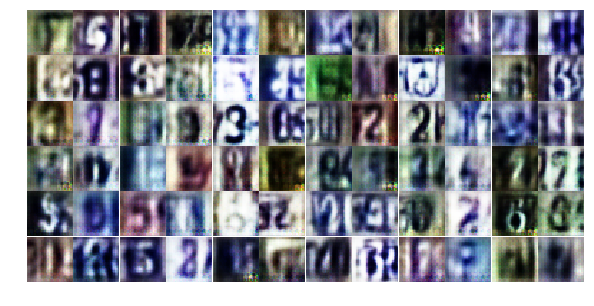

Epoch 13/25... Discriminator Loss: 0.7772... Generator Loss: 0.8574
Epoch 13/25... Discriminator Loss: 0.7675... Generator Loss: 0.8355
Epoch 13/25... Discriminator Loss: 0.7038... Generator Loss: 2.1930
Epoch 13/25... Discriminator Loss: 0.9403... Generator Loss: 3.4816
Epoch 13/25... Discriminator Loss: 0.5471... Generator Loss: 1.3536
Epoch 13/25... Discriminator Loss: 0.5568... Generator Loss: 1.2844
Epoch 13/25... Discriminator Loss: 0.9714... Generator Loss: 1.3719
Epoch 13/25... Discriminator Loss: 0.5604... Generator Loss: 1.2419
Epoch 13/25... Discriminator Loss: 0.6430... Generator Loss: 1.0230
Epoch 13/25... Discriminator Loss: 0.5545... Generator Loss: 1.2962


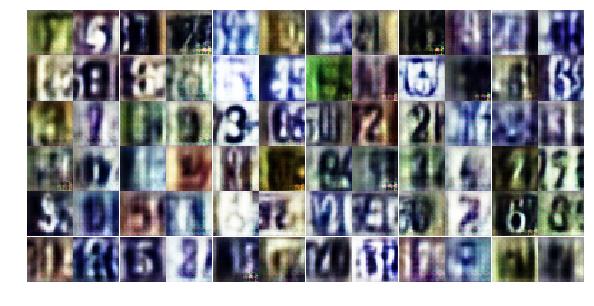

Epoch 13/25... Discriminator Loss: 1.0359... Generator Loss: 0.6401
Epoch 13/25... Discriminator Loss: 1.2500... Generator Loss: 0.4900
Epoch 13/25... Discriminator Loss: 0.6931... Generator Loss: 1.1144
Epoch 13/25... Discriminator Loss: 1.2076... Generator Loss: 0.5004
Epoch 13/25... Discriminator Loss: 0.6570... Generator Loss: 1.0410
Epoch 13/25... Discriminator Loss: 0.3004... Generator Loss: 1.9491
Epoch 13/25... Discriminator Loss: 0.6768... Generator Loss: 1.0073
Epoch 13/25... Discriminator Loss: 0.7718... Generator Loss: 0.9375
Epoch 13/25... Discriminator Loss: 0.3168... Generator Loss: 3.0316
Epoch 13/25... Discriminator Loss: 0.7999... Generator Loss: 1.5339


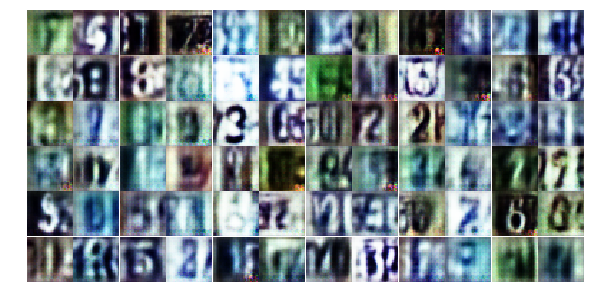

Epoch 13/25... Discriminator Loss: 0.8439... Generator Loss: 0.8285
Epoch 13/25... Discriminator Loss: 1.6278... Generator Loss: 0.5028
Epoch 13/25... Discriminator Loss: 0.5132... Generator Loss: 1.6232
Epoch 13/25... Discriminator Loss: 0.6071... Generator Loss: 1.0697
Epoch 13/25... Discriminator Loss: 0.9717... Generator Loss: 0.6705
Epoch 13/25... Discriminator Loss: 0.4653... Generator Loss: 1.4847
Epoch 13/25... Discriminator Loss: 0.7497... Generator Loss: 0.8738
Epoch 13/25... Discriminator Loss: 0.7087... Generator Loss: 1.0487
Epoch 13/25... Discriminator Loss: 0.6200... Generator Loss: 1.0527
Epoch 13/25... Discriminator Loss: 1.3693... Generator Loss: 0.5171


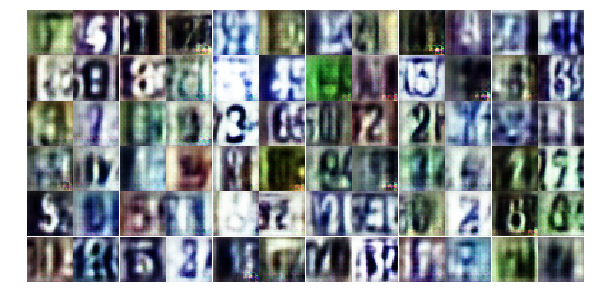

Epoch 13/25... Discriminator Loss: 0.4236... Generator Loss: 1.7683
Epoch 13/25... Discriminator Loss: 0.8873... Generator Loss: 0.7862
Epoch 13/25... Discriminator Loss: 0.5829... Generator Loss: 1.1435
Epoch 13/25... Discriminator Loss: 1.0709... Generator Loss: 0.5465
Epoch 14/25... Discriminator Loss: 0.6511... Generator Loss: 1.9067
Epoch 14/25... Discriminator Loss: 0.9587... Generator Loss: 0.7162
Epoch 14/25... Discriminator Loss: 0.9267... Generator Loss: 0.7544
Epoch 14/25... Discriminator Loss: 0.5247... Generator Loss: 1.1963
Epoch 14/25... Discriminator Loss: 0.5380... Generator Loss: 1.2662
Epoch 14/25... Discriminator Loss: 0.3601... Generator Loss: 1.8261


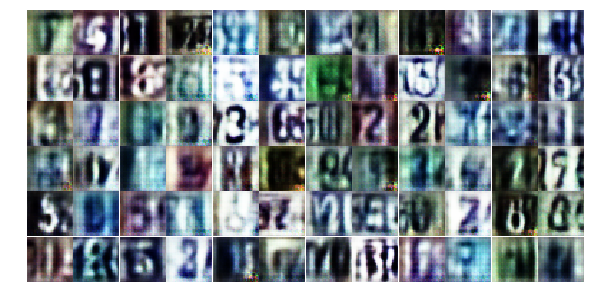

Epoch 14/25... Discriminator Loss: 1.2930... Generator Loss: 3.0734
Epoch 14/25... Discriminator Loss: 0.5286... Generator Loss: 1.2669
Epoch 14/25... Discriminator Loss: 0.7830... Generator Loss: 1.0009
Epoch 14/25... Discriminator Loss: 0.4587... Generator Loss: 1.3901
Epoch 14/25... Discriminator Loss: 0.7863... Generator Loss: 0.9186
Epoch 14/25... Discriminator Loss: 0.3669... Generator Loss: 1.4913
Epoch 14/25... Discriminator Loss: 0.2483... Generator Loss: 2.4029
Epoch 14/25... Discriminator Loss: 1.3151... Generator Loss: 0.4603
Epoch 14/25... Discriminator Loss: 1.1081... Generator Loss: 0.5509
Epoch 14/25... Discriminator Loss: 1.3362... Generator Loss: 0.5010


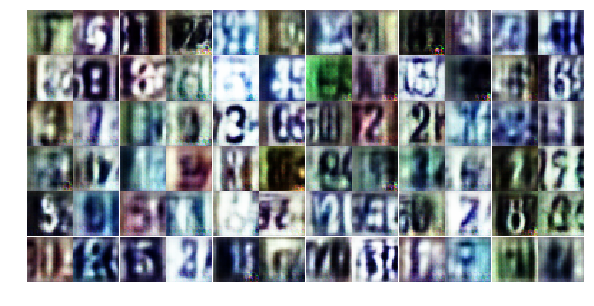

Epoch 14/25... Discriminator Loss: 0.4829... Generator Loss: 1.7890
Epoch 14/25... Discriminator Loss: 0.3132... Generator Loss: 2.4049
Epoch 14/25... Discriminator Loss: 0.7425... Generator Loss: 0.9835
Epoch 14/25... Discriminator Loss: 0.4310... Generator Loss: 1.4966
Epoch 14/25... Discriminator Loss: 0.9370... Generator Loss: 0.7471
Epoch 14/25... Discriminator Loss: 0.6928... Generator Loss: 1.0803
Epoch 14/25... Discriminator Loss: 0.7630... Generator Loss: 0.8995
Epoch 14/25... Discriminator Loss: 0.7751... Generator Loss: 0.9070
Epoch 14/25... Discriminator Loss: 0.5065... Generator Loss: 1.4058
Epoch 14/25... Discriminator Loss: 0.9763... Generator Loss: 3.6395


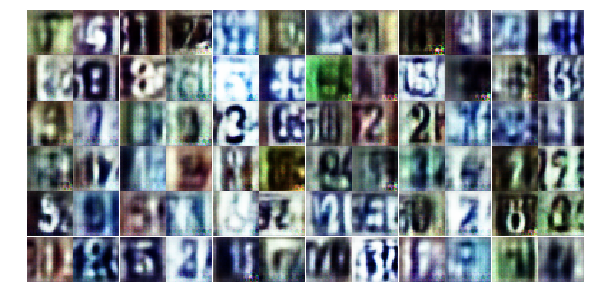

Epoch 14/25... Discriminator Loss: 1.5613... Generator Loss: 0.3784
Epoch 14/25... Discriminator Loss: 0.3008... Generator Loss: 1.9996
Epoch 14/25... Discriminator Loss: 0.4789... Generator Loss: 1.3128
Epoch 14/25... Discriminator Loss: 0.4085... Generator Loss: 1.3444
Epoch 14/25... Discriminator Loss: 0.6128... Generator Loss: 1.1655
Epoch 14/25... Discriminator Loss: 0.6699... Generator Loss: 1.0870
Epoch 14/25... Discriminator Loss: 0.7702... Generator Loss: 0.9527
Epoch 14/25... Discriminator Loss: 0.3164... Generator Loss: 1.8376
Epoch 14/25... Discriminator Loss: 0.3251... Generator Loss: 1.6932
Epoch 14/25... Discriminator Loss: 0.5990... Generator Loss: 1.3615


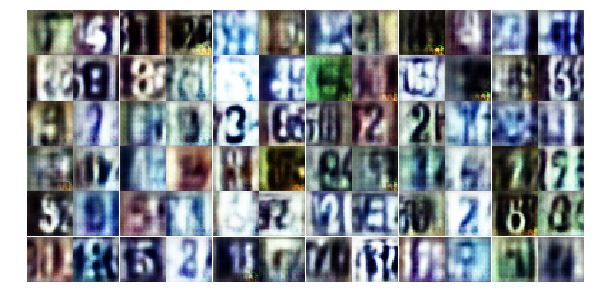

Epoch 14/25... Discriminator Loss: 0.9933... Generator Loss: 0.6951
Epoch 14/25... Discriminator Loss: 0.6429... Generator Loss: 1.1343
Epoch 14/25... Discriminator Loss: 1.0723... Generator Loss: 0.5845
Epoch 14/25... Discriminator Loss: 0.6929... Generator Loss: 0.9903
Epoch 14/25... Discriminator Loss: 0.6152... Generator Loss: 1.0949
Epoch 14/25... Discriminator Loss: 1.9445... Generator Loss: 0.2271
Epoch 14/25... Discriminator Loss: 0.6032... Generator Loss: 1.3467
Epoch 14/25... Discriminator Loss: 0.9294... Generator Loss: 0.7072
Epoch 14/25... Discriminator Loss: 1.2812... Generator Loss: 0.5382
Epoch 14/25... Discriminator Loss: 1.0538... Generator Loss: 0.7058


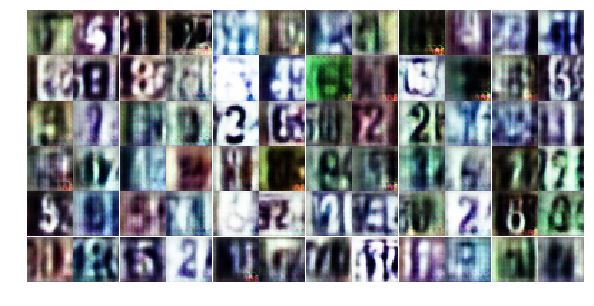

Epoch 14/25... Discriminator Loss: 0.8750... Generator Loss: 1.2298
Epoch 14/25... Discriminator Loss: 1.0077... Generator Loss: 0.6401
Epoch 14/25... Discriminator Loss: 0.4462... Generator Loss: 1.5813
Epoch 14/25... Discriminator Loss: 0.7579... Generator Loss: 0.8424
Epoch 14/25... Discriminator Loss: 0.2939... Generator Loss: 1.9115
Epoch 14/25... Discriminator Loss: 0.6728... Generator Loss: 2.1988
Epoch 14/25... Discriminator Loss: 0.6757... Generator Loss: 1.3199
Epoch 14/25... Discriminator Loss: 0.7174... Generator Loss: 0.9330
Epoch 14/25... Discriminator Loss: 1.4083... Generator Loss: 0.3874
Epoch 14/25... Discriminator Loss: 0.9807... Generator Loss: 0.6060


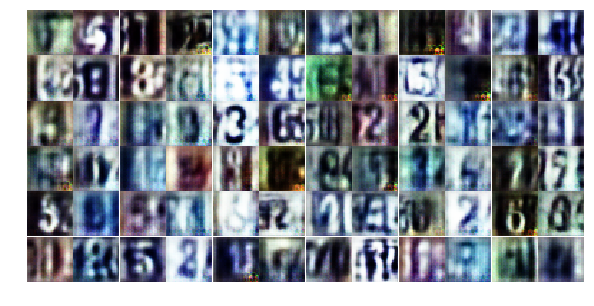

Epoch 14/25... Discriminator Loss: 0.6033... Generator Loss: 1.2257
Epoch 14/25... Discriminator Loss: 1.2589... Generator Loss: 0.5149
Epoch 15/25... Discriminator Loss: 0.8672... Generator Loss: 0.9505
Epoch 15/25... Discriminator Loss: 0.4954... Generator Loss: 1.5595
Epoch 15/25... Discriminator Loss: 0.7610... Generator Loss: 0.8340
Epoch 15/25... Discriminator Loss: 0.5712... Generator Loss: 1.1230
Epoch 15/25... Discriminator Loss: 1.6706... Generator Loss: 0.2865
Epoch 15/25... Discriminator Loss: 0.6263... Generator Loss: 1.0555
Epoch 15/25... Discriminator Loss: 0.6704... Generator Loss: 0.9979
Epoch 15/25... Discriminator Loss: 0.6661... Generator Loss: 1.1783


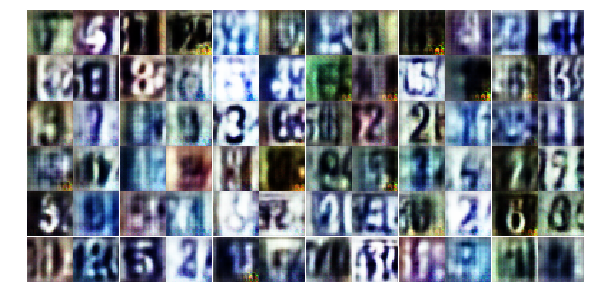

Epoch 15/25... Discriminator Loss: 1.2067... Generator Loss: 0.5290
Epoch 15/25... Discriminator Loss: 0.6902... Generator Loss: 1.8379
Epoch 15/25... Discriminator Loss: 0.6752... Generator Loss: 1.8300
Epoch 15/25... Discriminator Loss: 0.6701... Generator Loss: 1.1713
Epoch 15/25... Discriminator Loss: 1.0183... Generator Loss: 0.8903
Epoch 15/25... Discriminator Loss: 0.3919... Generator Loss: 1.6509
Epoch 15/25... Discriminator Loss: 0.7226... Generator Loss: 0.9851
Epoch 15/25... Discriminator Loss: 1.3744... Generator Loss: 0.4121
Epoch 15/25... Discriminator Loss: 0.4299... Generator Loss: 1.6145
Epoch 15/25... Discriminator Loss: 1.2485... Generator Loss: 0.4985


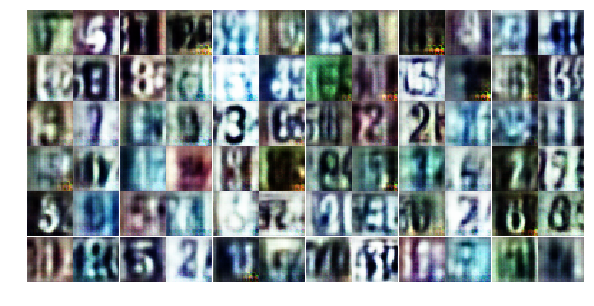

Epoch 15/25... Discriminator Loss: 1.2518... Generator Loss: 0.5525
Epoch 15/25... Discriminator Loss: 0.3656... Generator Loss: 1.7209
Epoch 15/25... Discriminator Loss: 0.4717... Generator Loss: 1.4107
Epoch 15/25... Discriminator Loss: 0.9386... Generator Loss: 0.6968
Epoch 15/25... Discriminator Loss: 1.2121... Generator Loss: 0.6521
Epoch 15/25... Discriminator Loss: 0.7442... Generator Loss: 0.9068
Epoch 15/25... Discriminator Loss: 0.6238... Generator Loss: 1.1554
Epoch 15/25... Discriminator Loss: 0.8400... Generator Loss: 0.8480
Epoch 15/25... Discriminator Loss: 0.7381... Generator Loss: 0.8714
Epoch 15/25... Discriminator Loss: 2.5496... Generator Loss: 0.1511


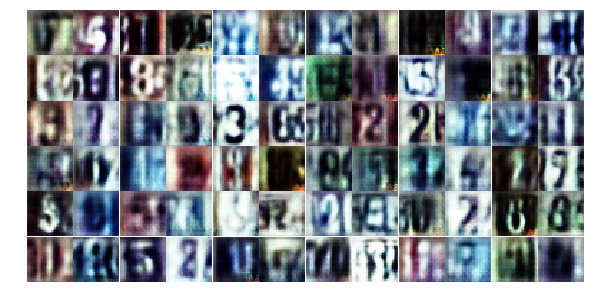

Epoch 15/25... Discriminator Loss: 0.9594... Generator Loss: 0.8013
Epoch 15/25... Discriminator Loss: 0.7433... Generator Loss: 1.8555
Epoch 15/25... Discriminator Loss: 0.4996... Generator Loss: 1.5051
Epoch 15/25... Discriminator Loss: 0.6212... Generator Loss: 1.1709
Epoch 15/25... Discriminator Loss: 0.6673... Generator Loss: 1.0085
Epoch 15/25... Discriminator Loss: 0.7069... Generator Loss: 1.0885
Epoch 15/25... Discriminator Loss: 0.6510... Generator Loss: 0.9988
Epoch 15/25... Discriminator Loss: 0.9646... Generator Loss: 0.6811
Epoch 15/25... Discriminator Loss: 0.7401... Generator Loss: 0.8949
Epoch 15/25... Discriminator Loss: 0.5045... Generator Loss: 1.6307


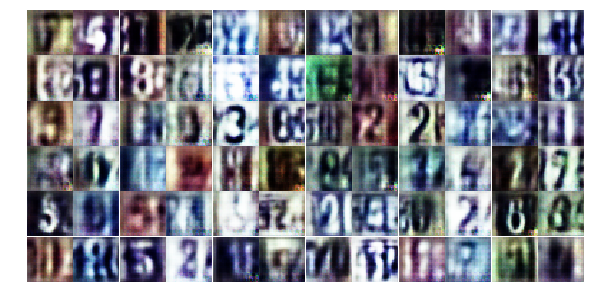

Epoch 15/25... Discriminator Loss: 0.8556... Generator Loss: 0.8470
Epoch 15/25... Discriminator Loss: 0.9271... Generator Loss: 0.8044
Epoch 15/25... Discriminator Loss: 0.7314... Generator Loss: 0.9368
Epoch 15/25... Discriminator Loss: 0.5030... Generator Loss: 1.3316
Epoch 15/25... Discriminator Loss: 0.7233... Generator Loss: 0.9521
Epoch 15/25... Discriminator Loss: 1.6204... Generator Loss: 0.3876
Epoch 15/25... Discriminator Loss: 0.4877... Generator Loss: 1.3235
Epoch 15/25... Discriminator Loss: 0.7752... Generator Loss: 0.9867
Epoch 15/25... Discriminator Loss: 1.0032... Generator Loss: 0.6268
Epoch 15/25... Discriminator Loss: 0.6058... Generator Loss: 1.1889


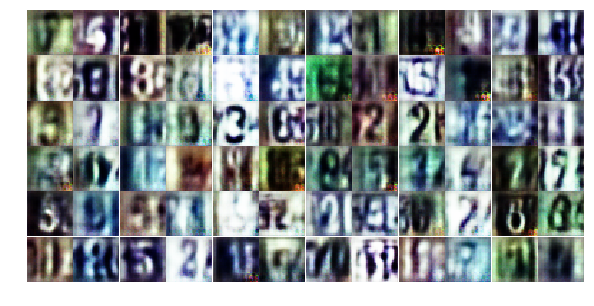

Epoch 15/25... Discriminator Loss: 1.1345... Generator Loss: 0.6085
Epoch 15/25... Discriminator Loss: 1.0545... Generator Loss: 0.6524
Epoch 15/25... Discriminator Loss: 0.3008... Generator Loss: 1.7994
Epoch 15/25... Discriminator Loss: 0.5490... Generator Loss: 1.5128
Epoch 15/25... Discriminator Loss: 0.9846... Generator Loss: 0.7068
Epoch 15/25... Discriminator Loss: 1.1725... Generator Loss: 2.6118
Epoch 15/25... Discriminator Loss: 0.9739... Generator Loss: 0.9047
Epoch 15/25... Discriminator Loss: 0.5421... Generator Loss: 1.4706
Epoch 15/25... Discriminator Loss: 2.0422... Generator Loss: 0.2132
Epoch 16/25... Discriminator Loss: 1.0472... Generator Loss: 0.6791


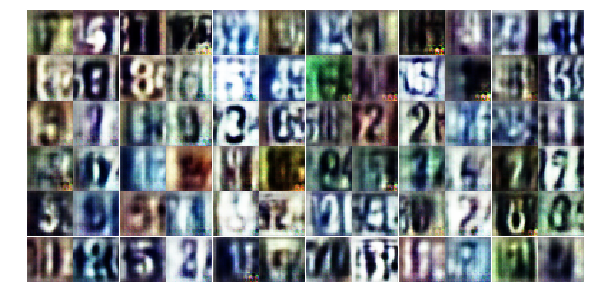

Epoch 16/25... Discriminator Loss: 0.5521... Generator Loss: 1.2550
Epoch 16/25... Discriminator Loss: 0.8344... Generator Loss: 0.9529
Epoch 16/25... Discriminator Loss: 0.7392... Generator Loss: 1.1985
Epoch 16/25... Discriminator Loss: 0.6562... Generator Loss: 1.4788
Epoch 16/25... Discriminator Loss: 0.5525... Generator Loss: 1.4271
Epoch 16/25... Discriminator Loss: 0.6298... Generator Loss: 2.4146
Epoch 16/25... Discriminator Loss: 1.9486... Generator Loss: 0.2461
Epoch 16/25... Discriminator Loss: 0.9181... Generator Loss: 0.7784
Epoch 16/25... Discriminator Loss: 0.3981... Generator Loss: 1.6975
Epoch 16/25... Discriminator Loss: 0.6679... Generator Loss: 1.0637


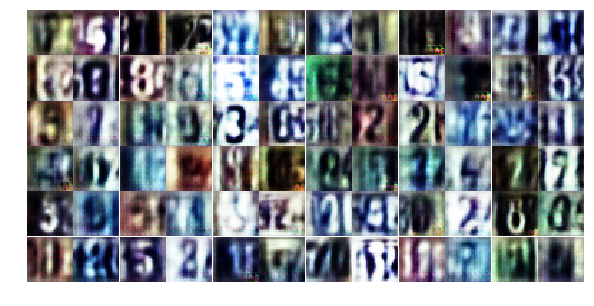

Epoch 16/25... Discriminator Loss: 1.1642... Generator Loss: 0.5331
Epoch 16/25... Discriminator Loss: 1.0325... Generator Loss: 0.6013
Epoch 16/25... Discriminator Loss: 0.7487... Generator Loss: 0.9645
Epoch 16/25... Discriminator Loss: 1.3115... Generator Loss: 0.5498
Epoch 16/25... Discriminator Loss: 0.3282... Generator Loss: 1.9643
Epoch 16/25... Discriminator Loss: 0.7778... Generator Loss: 1.1916
Epoch 16/25... Discriminator Loss: 1.1253... Generator Loss: 0.5882
Epoch 16/25... Discriminator Loss: 0.4535... Generator Loss: 1.3656
Epoch 16/25... Discriminator Loss: 0.5469... Generator Loss: 1.1698
Epoch 16/25... Discriminator Loss: 0.6314... Generator Loss: 1.4474


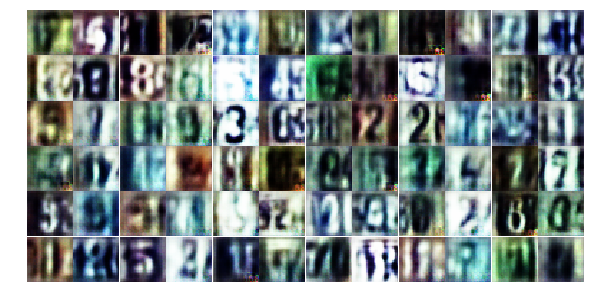

Epoch 16/25... Discriminator Loss: 0.7728... Generator Loss: 0.9207
Epoch 16/25... Discriminator Loss: 0.9409... Generator Loss: 0.7455
Epoch 16/25... Discriminator Loss: 0.7158... Generator Loss: 0.9946
Epoch 16/25... Discriminator Loss: 0.8496... Generator Loss: 0.7682
Epoch 16/25... Discriminator Loss: 0.5008... Generator Loss: 1.5536
Epoch 16/25... Discriminator Loss: 1.0366... Generator Loss: 0.6426
Epoch 16/25... Discriminator Loss: 0.5717... Generator Loss: 1.3579
Epoch 16/25... Discriminator Loss: 0.5468... Generator Loss: 1.2810
Epoch 16/25... Discriminator Loss: 1.2376... Generator Loss: 0.6144
Epoch 16/25... Discriminator Loss: 1.0314... Generator Loss: 2.8292


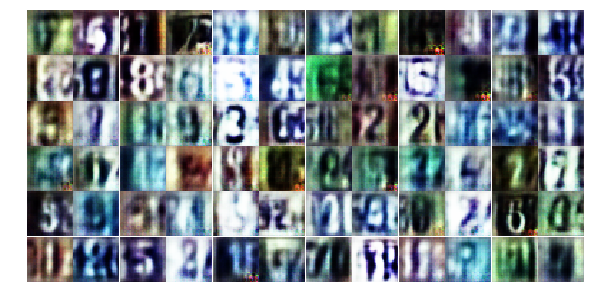

Epoch 16/25... Discriminator Loss: 0.8755... Generator Loss: 0.7778
Epoch 16/25... Discriminator Loss: 0.8034... Generator Loss: 0.8891
Epoch 16/25... Discriminator Loss: 0.5814... Generator Loss: 1.2874
Epoch 16/25... Discriminator Loss: 0.5910... Generator Loss: 1.8114
Epoch 16/25... Discriminator Loss: 0.7655... Generator Loss: 0.9654
Epoch 16/25... Discriminator Loss: 0.6599... Generator Loss: 2.7064
Epoch 16/25... Discriminator Loss: 0.7546... Generator Loss: 0.9514
Epoch 16/25... Discriminator Loss: 1.1259... Generator Loss: 0.6108
Epoch 16/25... Discriminator Loss: 0.6750... Generator Loss: 0.9975
Epoch 16/25... Discriminator Loss: 0.4083... Generator Loss: 1.7305


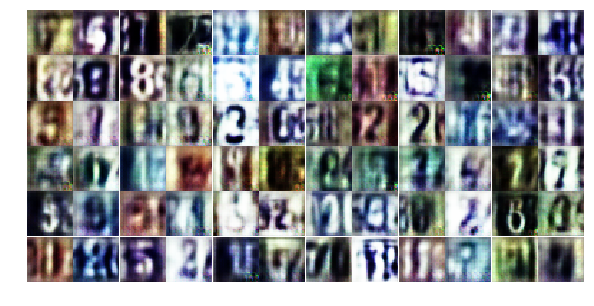

Epoch 16/25... Discriminator Loss: 0.7441... Generator Loss: 0.9712
Epoch 16/25... Discriminator Loss: 1.0152... Generator Loss: 0.7246
Epoch 16/25... Discriminator Loss: 1.9615... Generator Loss: 0.2370
Epoch 16/25... Discriminator Loss: 0.7650... Generator Loss: 1.5279
Epoch 16/25... Discriminator Loss: 0.8089... Generator Loss: 0.8402
Epoch 16/25... Discriminator Loss: 1.2723... Generator Loss: 0.5097
Epoch 16/25... Discriminator Loss: 0.4935... Generator Loss: 1.5876
Epoch 16/25... Discriminator Loss: 0.6349... Generator Loss: 1.0418
Epoch 16/25... Discriminator Loss: 0.2839... Generator Loss: 2.0162
Epoch 16/25... Discriminator Loss: 0.4572... Generator Loss: 1.5169


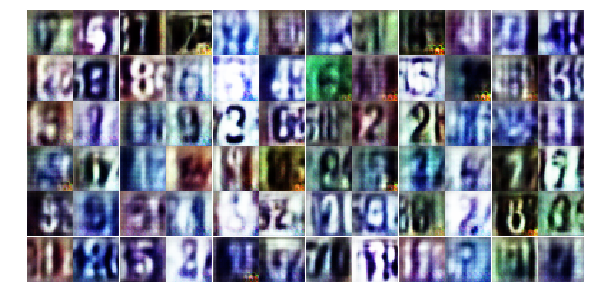

Epoch 16/25... Discriminator Loss: 1.6964... Generator Loss: 0.3267
Epoch 16/25... Discriminator Loss: 0.6184... Generator Loss: 1.5560
Epoch 16/25... Discriminator Loss: 0.6570... Generator Loss: 1.0829
Epoch 16/25... Discriminator Loss: 0.5503... Generator Loss: 1.2613
Epoch 16/25... Discriminator Loss: 0.5385... Generator Loss: 1.2145
Epoch 16/25... Discriminator Loss: 0.6330... Generator Loss: 0.9852
Epoch 17/25... Discriminator Loss: 0.6287... Generator Loss: 1.8927
Epoch 17/25... Discriminator Loss: 0.8561... Generator Loss: 0.7788
Epoch 17/25... Discriminator Loss: 0.5219... Generator Loss: 1.6958
Epoch 17/25... Discriminator Loss: 0.8836... Generator Loss: 0.9125


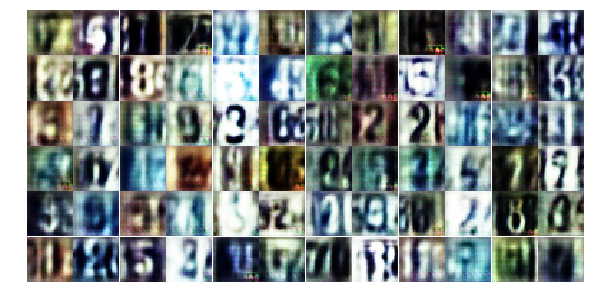

Epoch 17/25... Discriminator Loss: 0.6306... Generator Loss: 1.0443
Epoch 17/25... Discriminator Loss: 0.7846... Generator Loss: 0.8328
Epoch 17/25... Discriminator Loss: 1.4890... Generator Loss: 0.4636
Epoch 17/25... Discriminator Loss: 0.7617... Generator Loss: 1.0670
Epoch 17/25... Discriminator Loss: 0.6194... Generator Loss: 1.1260
Epoch 17/25... Discriminator Loss: 0.6503... Generator Loss: 1.3492
Epoch 17/25... Discriminator Loss: 0.5563... Generator Loss: 1.3939
Epoch 17/25... Discriminator Loss: 0.6099... Generator Loss: 1.1153
Epoch 17/25... Discriminator Loss: 0.3153... Generator Loss: 1.9259
Epoch 17/25... Discriminator Loss: 0.3427... Generator Loss: 2.1420


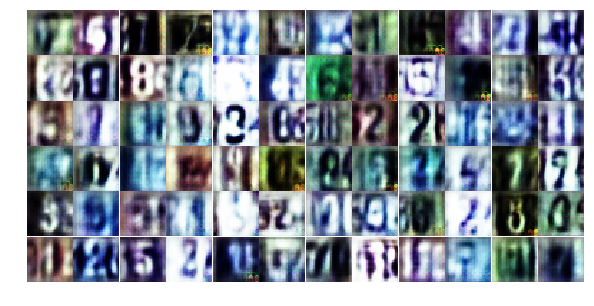

Epoch 17/25... Discriminator Loss: 2.8783... Generator Loss: 4.2838
Epoch 17/25... Discriminator Loss: 0.9237... Generator Loss: 2.2920
Epoch 17/25... Discriminator Loss: 0.5653... Generator Loss: 1.3520
Epoch 17/25... Discriminator Loss: 0.8613... Generator Loss: 0.8533
Epoch 17/25... Discriminator Loss: 0.5543... Generator Loss: 1.2095
Epoch 17/25... Discriminator Loss: 1.2035... Generator Loss: 0.5601
Epoch 17/25... Discriminator Loss: 0.7918... Generator Loss: 1.2373
Epoch 17/25... Discriminator Loss: 0.9138... Generator Loss: 0.7584
Epoch 17/25... Discriminator Loss: 0.7161... Generator Loss: 1.0381
Epoch 17/25... Discriminator Loss: 0.6922... Generator Loss: 0.9515


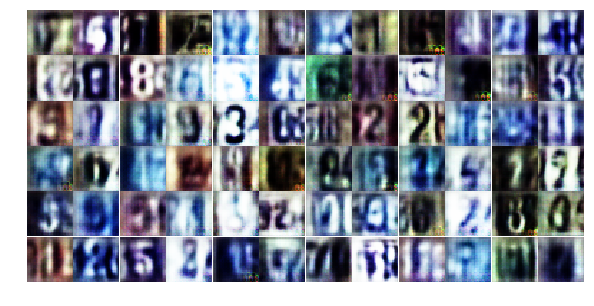

Epoch 17/25... Discriminator Loss: 1.4365... Generator Loss: 0.3713
Epoch 17/25... Discriminator Loss: 0.9021... Generator Loss: 0.8255
Epoch 17/25... Discriminator Loss: 0.8702... Generator Loss: 0.7245
Epoch 17/25... Discriminator Loss: 0.9979... Generator Loss: 0.7187
Epoch 17/25... Discriminator Loss: 1.4644... Generator Loss: 0.3983
Epoch 17/25... Discriminator Loss: 0.5112... Generator Loss: 1.4853
Epoch 17/25... Discriminator Loss: 0.5501... Generator Loss: 1.2054
Epoch 17/25... Discriminator Loss: 0.8278... Generator Loss: 0.9915
Epoch 17/25... Discriminator Loss: 1.4392... Generator Loss: 0.4990
Epoch 17/25... Discriminator Loss: 0.2144... Generator Loss: 2.6595


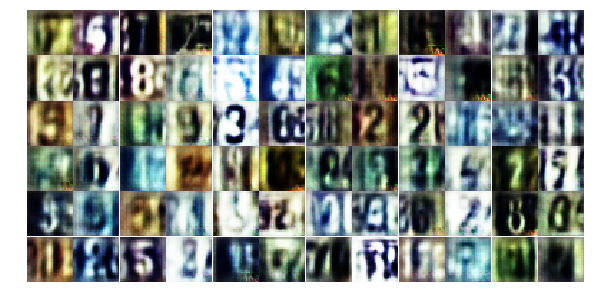

Epoch 17/25... Discriminator Loss: 0.6944... Generator Loss: 0.9607
Epoch 17/25... Discriminator Loss: 0.9287... Generator Loss: 0.9839
Epoch 17/25... Discriminator Loss: 0.7900... Generator Loss: 0.8843
Epoch 17/25... Discriminator Loss: 1.0438... Generator Loss: 0.7173
Epoch 17/25... Discriminator Loss: 0.6540... Generator Loss: 1.0902
Epoch 17/25... Discriminator Loss: 0.6992... Generator Loss: 1.0096
Epoch 17/25... Discriminator Loss: 0.9876... Generator Loss: 0.6920
Epoch 17/25... Discriminator Loss: 0.6397... Generator Loss: 1.1392
Epoch 17/25... Discriminator Loss: 0.3356... Generator Loss: 1.9498
Epoch 17/25... Discriminator Loss: 1.2104... Generator Loss: 0.5632


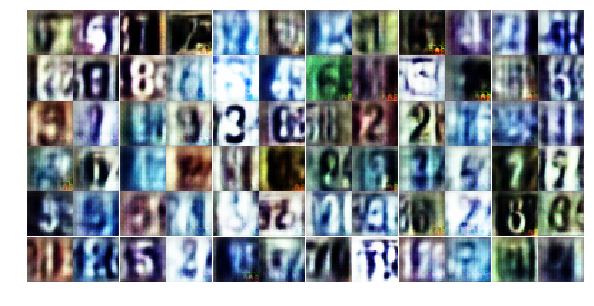

Epoch 17/25... Discriminator Loss: 1.6988... Generator Loss: 0.3615
Epoch 17/25... Discriminator Loss: 0.6623... Generator Loss: 2.9503
Epoch 17/25... Discriminator Loss: 0.6552... Generator Loss: 2.0812
Epoch 17/25... Discriminator Loss: 0.5906... Generator Loss: 1.6399
Epoch 17/25... Discriminator Loss: 0.6139... Generator Loss: 1.1107
Epoch 17/25... Discriminator Loss: 0.8195... Generator Loss: 0.8382
Epoch 17/25... Discriminator Loss: 1.4797... Generator Loss: 0.4055
Epoch 17/25... Discriminator Loss: 0.4452... Generator Loss: 1.8072
Epoch 17/25... Discriminator Loss: 0.5411... Generator Loss: 1.6288
Epoch 17/25... Discriminator Loss: 0.9312... Generator Loss: 0.7683


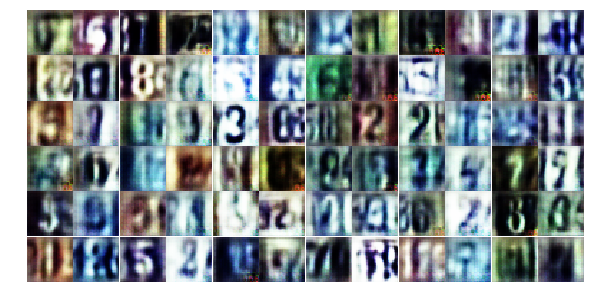

Epoch 17/25... Discriminator Loss: 0.7598... Generator Loss: 1.7274
Epoch 17/25... Discriminator Loss: 0.8464... Generator Loss: 0.8072
Epoch 17/25... Discriminator Loss: 0.5053... Generator Loss: 1.2785
Epoch 17/25... Discriminator Loss: 0.6984... Generator Loss: 0.9720
Epoch 18/25... Discriminator Loss: 1.0032... Generator Loss: 0.6754
Epoch 18/25... Discriminator Loss: 0.6112... Generator Loss: 1.2587
Epoch 18/25... Discriminator Loss: 0.4183... Generator Loss: 1.8238
Epoch 18/25... Discriminator Loss: 0.6258... Generator Loss: 1.0402
Epoch 18/25... Discriminator Loss: 1.1205... Generator Loss: 0.6185
Epoch 18/25... Discriminator Loss: 0.8133... Generator Loss: 1.0855


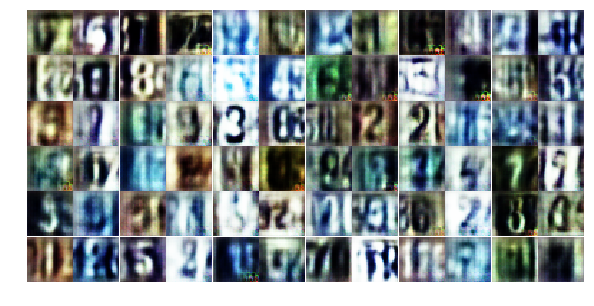

Epoch 18/25... Discriminator Loss: 0.5439... Generator Loss: 1.6432
Epoch 18/25... Discriminator Loss: 1.3270... Generator Loss: 0.5152
Epoch 18/25... Discriminator Loss: 0.9236... Generator Loss: 0.6928
Epoch 18/25... Discriminator Loss: 0.2618... Generator Loss: 2.3200
Epoch 18/25... Discriminator Loss: 0.6405... Generator Loss: 0.9707
Epoch 18/25... Discriminator Loss: 1.1679... Generator Loss: 0.5108
Epoch 18/25... Discriminator Loss: 0.6313... Generator Loss: 1.1297
Epoch 18/25... Discriminator Loss: 0.8965... Generator Loss: 0.7780
Epoch 18/25... Discriminator Loss: 0.3889... Generator Loss: 1.6453
Epoch 18/25... Discriminator Loss: 0.2964... Generator Loss: 1.7478


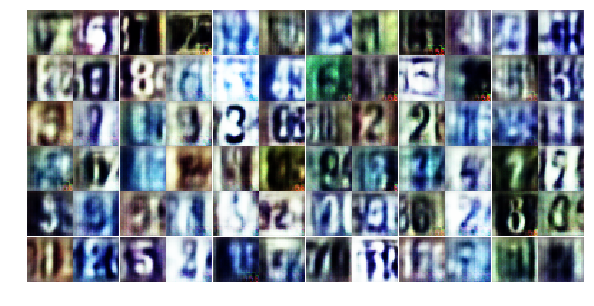

Epoch 18/25... Discriminator Loss: 0.6539... Generator Loss: 1.0934
Epoch 18/25... Discriminator Loss: 0.6463... Generator Loss: 2.3370
Epoch 18/25... Discriminator Loss: 0.7709... Generator Loss: 1.2080
Epoch 18/25... Discriminator Loss: 0.7097... Generator Loss: 1.5106
Epoch 18/25... Discriminator Loss: 0.8001... Generator Loss: 0.8578
Epoch 18/25... Discriminator Loss: 0.7278... Generator Loss: 1.1549
Epoch 18/25... Discriminator Loss: 0.9349... Generator Loss: 0.8140
Epoch 18/25... Discriminator Loss: 1.2778... Generator Loss: 0.5228
Epoch 18/25... Discriminator Loss: 1.0144... Generator Loss: 0.6974
Epoch 18/25... Discriminator Loss: 0.3972... Generator Loss: 1.5993


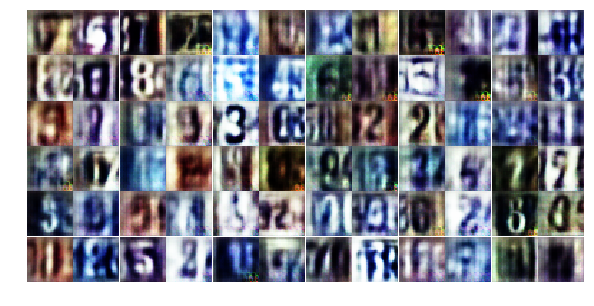

Epoch 18/25... Discriminator Loss: 0.7657... Generator Loss: 0.9029
Epoch 18/25... Discriminator Loss: 0.8019... Generator Loss: 0.9074
Epoch 18/25... Discriminator Loss: 0.7118... Generator Loss: 1.0005
Epoch 18/25... Discriminator Loss: 1.3877... Generator Loss: 0.4157
Epoch 18/25... Discriminator Loss: 1.1707... Generator Loss: 0.5530
Epoch 18/25... Discriminator Loss: 0.7746... Generator Loss: 0.9676
Epoch 18/25... Discriminator Loss: 0.6320... Generator Loss: 1.1609
Epoch 18/25... Discriminator Loss: 0.4073... Generator Loss: 2.4909
Epoch 18/25... Discriminator Loss: 1.1839... Generator Loss: 0.6077
Epoch 18/25... Discriminator Loss: 1.3313... Generator Loss: 0.4721


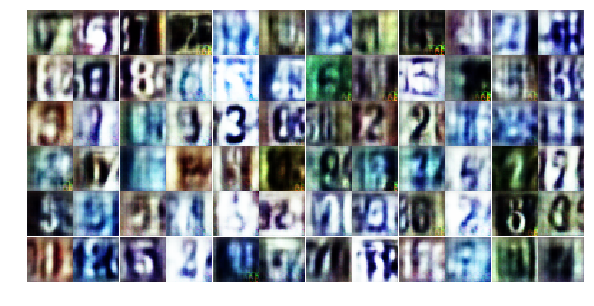

Epoch 18/25... Discriminator Loss: 0.9256... Generator Loss: 0.7982
Epoch 18/25... Discriminator Loss: 0.5830... Generator Loss: 1.1746
Epoch 18/25... Discriminator Loss: 0.5334... Generator Loss: 1.2721
Epoch 18/25... Discriminator Loss: 0.5455... Generator Loss: 1.2613
Epoch 18/25... Discriminator Loss: 0.7021... Generator Loss: 1.0448
Epoch 18/25... Discriminator Loss: 0.4099... Generator Loss: 1.5551
Epoch 18/25... Discriminator Loss: 1.3703... Generator Loss: 0.4928
Epoch 18/25... Discriminator Loss: 1.0073... Generator Loss: 2.8047
Epoch 18/25... Discriminator Loss: 0.7540... Generator Loss: 0.9886
Epoch 18/25... Discriminator Loss: 0.3734... Generator Loss: 1.5737


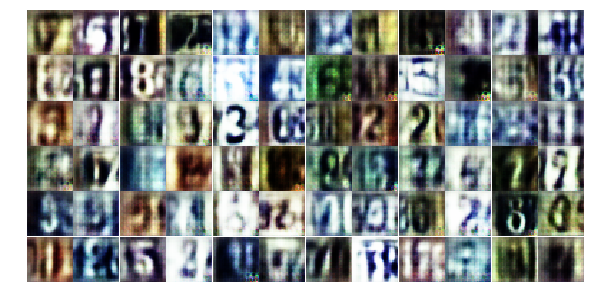

Epoch 18/25... Discriminator Loss: 0.7304... Generator Loss: 0.9426
Epoch 18/25... Discriminator Loss: 0.8580... Generator Loss: 0.7537
Epoch 18/25... Discriminator Loss: 0.6252... Generator Loss: 1.3040
Epoch 18/25... Discriminator Loss: 0.9207... Generator Loss: 0.7241
Epoch 18/25... Discriminator Loss: 0.5949... Generator Loss: 1.0512
Epoch 18/25... Discriminator Loss: 0.7879... Generator Loss: 3.1074
Epoch 18/25... Discriminator Loss: 0.7649... Generator Loss: 0.8383
Epoch 18/25... Discriminator Loss: 0.5589... Generator Loss: 1.0920
Epoch 18/25... Discriminator Loss: 0.8521... Generator Loss: 1.4651
Epoch 18/25... Discriminator Loss: 0.6623... Generator Loss: 1.0893


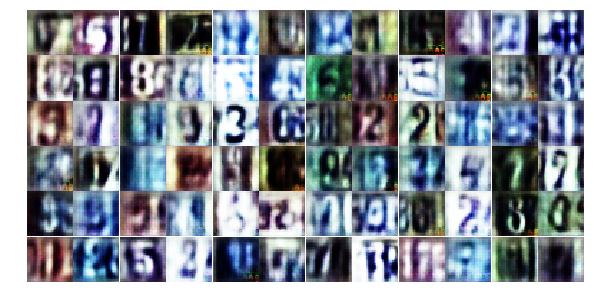

Epoch 18/25... Discriminator Loss: 0.5459... Generator Loss: 1.5522
Epoch 19/25... Discriminator Loss: 0.8006... Generator Loss: 0.9852
Epoch 19/25... Discriminator Loss: 1.2032... Generator Loss: 0.5356
Epoch 19/25... Discriminator Loss: 0.7426... Generator Loss: 1.0508
Epoch 19/25... Discriminator Loss: 0.5833... Generator Loss: 1.1742
Epoch 19/25... Discriminator Loss: 0.6946... Generator Loss: 1.4000
Epoch 19/25... Discriminator Loss: 0.6856... Generator Loss: 1.1117
Epoch 19/25... Discriminator Loss: 0.5403... Generator Loss: 1.6400
Epoch 19/25... Discriminator Loss: 0.6806... Generator Loss: 1.0462
Epoch 19/25... Discriminator Loss: 0.8615... Generator Loss: 0.7472


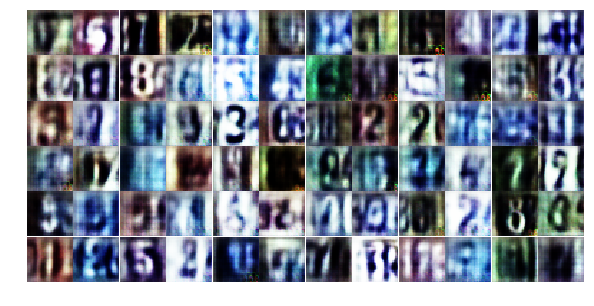

Epoch 19/25... Discriminator Loss: 0.6714... Generator Loss: 1.0470
Epoch 19/25... Discriminator Loss: 0.5239... Generator Loss: 2.6104
Epoch 19/25... Discriminator Loss: 1.2826... Generator Loss: 0.5281
Epoch 19/25... Discriminator Loss: 0.4839... Generator Loss: 1.3196
Epoch 19/25... Discriminator Loss: 0.6704... Generator Loss: 1.1737
Epoch 19/25... Discriminator Loss: 0.9031... Generator Loss: 0.7376
Epoch 19/25... Discriminator Loss: 0.6783... Generator Loss: 1.1411
Epoch 19/25... Discriminator Loss: 0.5737... Generator Loss: 1.2079
Epoch 19/25... Discriminator Loss: 0.6648... Generator Loss: 1.2136
Epoch 19/25... Discriminator Loss: 0.9027... Generator Loss: 0.7577


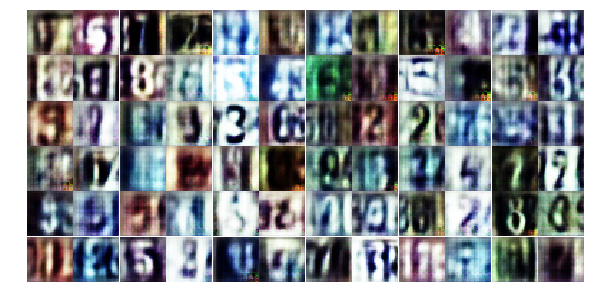

Epoch 19/25... Discriminator Loss: 1.1312... Generator Loss: 0.5606
Epoch 19/25... Discriminator Loss: 0.8875... Generator Loss: 0.8088
Epoch 19/25... Discriminator Loss: 1.4348... Generator Loss: 0.4002
Epoch 19/25... Discriminator Loss: 0.7298... Generator Loss: 1.0086
Epoch 19/25... Discriminator Loss: 0.8364... Generator Loss: 0.9429
Epoch 19/25... Discriminator Loss: 0.9653... Generator Loss: 0.7173
Epoch 19/25... Discriminator Loss: 0.6423... Generator Loss: 1.0949
Epoch 19/25... Discriminator Loss: 0.8848... Generator Loss: 0.7245
Epoch 19/25... Discriminator Loss: 1.2256... Generator Loss: 0.5067
Epoch 19/25... Discriminator Loss: 1.5753... Generator Loss: 0.3649


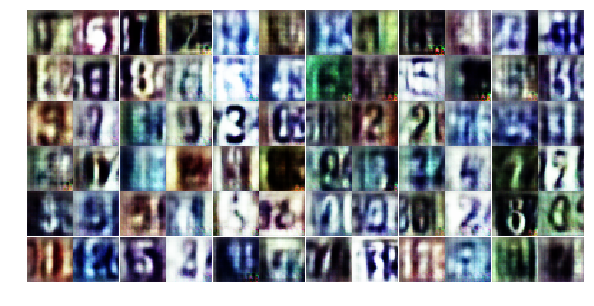

Epoch 19/25... Discriminator Loss: 0.9858... Generator Loss: 0.7109
Epoch 19/25... Discriminator Loss: 0.6295... Generator Loss: 1.0708
Epoch 19/25... Discriminator Loss: 0.6419... Generator Loss: 1.1649
Epoch 19/25... Discriminator Loss: 0.8278... Generator Loss: 0.8922
Epoch 19/25... Discriminator Loss: 0.6487... Generator Loss: 1.1826
Epoch 19/25... Discriminator Loss: 1.9377... Generator Loss: 0.2596
Epoch 19/25... Discriminator Loss: 0.7529... Generator Loss: 1.0518
Epoch 19/25... Discriminator Loss: 0.5986... Generator Loss: 1.2149
Epoch 19/25... Discriminator Loss: 1.0087... Generator Loss: 0.6984
Epoch 19/25... Discriminator Loss: 0.6384... Generator Loss: 1.1008


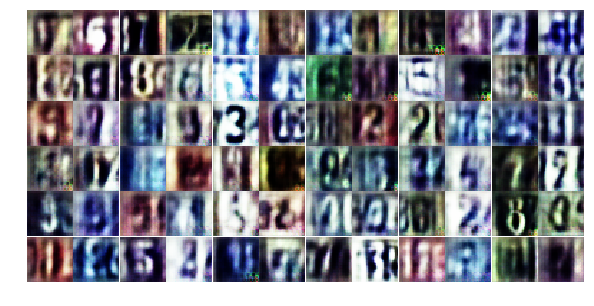

Epoch 19/25... Discriminator Loss: 0.5070... Generator Loss: 1.2938
Epoch 19/25... Discriminator Loss: 0.3585... Generator Loss: 1.7273
Epoch 19/25... Discriminator Loss: 1.3029... Generator Loss: 2.1872
Epoch 19/25... Discriminator Loss: 0.8474... Generator Loss: 1.9515
Epoch 19/25... Discriminator Loss: 1.2119... Generator Loss: 0.5886
Epoch 19/25... Discriminator Loss: 0.8611... Generator Loss: 1.6762
Epoch 19/25... Discriminator Loss: 0.9638... Generator Loss: 0.6772
Epoch 19/25... Discriminator Loss: 0.6609... Generator Loss: 1.0166
Epoch 19/25... Discriminator Loss: 0.6839... Generator Loss: 1.1606
Epoch 19/25... Discriminator Loss: 1.2570... Generator Loss: 0.4703


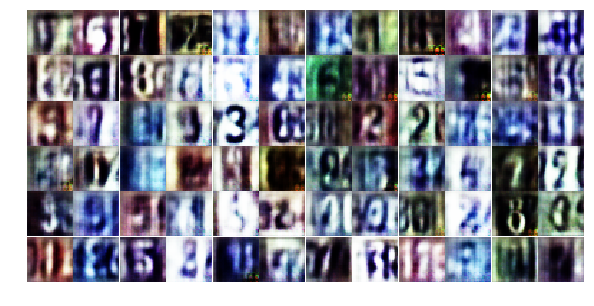

Epoch 19/25... Discriminator Loss: 0.8238... Generator Loss: 0.8525
Epoch 19/25... Discriminator Loss: 0.7631... Generator Loss: 0.8653
Epoch 19/25... Discriminator Loss: 0.5255... Generator Loss: 1.4780
Epoch 19/25... Discriminator Loss: 1.2671... Generator Loss: 0.4853
Epoch 19/25... Discriminator Loss: 1.2421... Generator Loss: 0.6368
Epoch 19/25... Discriminator Loss: 0.6183... Generator Loss: 1.2330
Epoch 19/25... Discriminator Loss: 2.1508... Generator Loss: 0.2446
Epoch 19/25... Discriminator Loss: 0.9674... Generator Loss: 1.0096
Epoch 20/25... Discriminator Loss: 0.8638... Generator Loss: 0.9584
Epoch 20/25... Discriminator Loss: 0.6862... Generator Loss: 1.1226


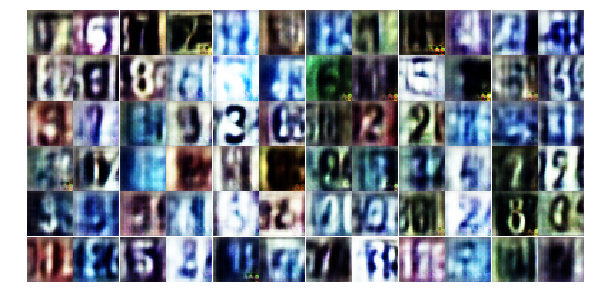

Epoch 20/25... Discriminator Loss: 0.6566... Generator Loss: 1.1275
Epoch 20/25... Discriminator Loss: 0.8777... Generator Loss: 0.8061
Epoch 20/25... Discriminator Loss: 0.8255... Generator Loss: 0.9248
Epoch 20/25... Discriminator Loss: 0.8885... Generator Loss: 0.8561
Epoch 20/25... Discriminator Loss: 0.6101... Generator Loss: 1.1601
Epoch 20/25... Discriminator Loss: 0.6667... Generator Loss: 1.0130
Epoch 20/25... Discriminator Loss: 0.6744... Generator Loss: 1.0957
Epoch 20/25... Discriminator Loss: 0.5205... Generator Loss: 1.2625
Epoch 20/25... Discriminator Loss: 0.8187... Generator Loss: 0.8286
Epoch 20/25... Discriminator Loss: 0.9646... Generator Loss: 0.6597


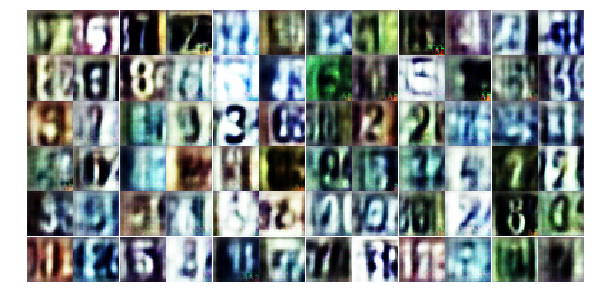

Epoch 20/25... Discriminator Loss: 1.2618... Generator Loss: 0.5334
Epoch 20/25... Discriminator Loss: 0.9912... Generator Loss: 0.6777
Epoch 20/25... Discriminator Loss: 0.8301... Generator Loss: 0.8723
Epoch 20/25... Discriminator Loss: 0.7638... Generator Loss: 0.9739
Epoch 20/25... Discriminator Loss: 0.9523... Generator Loss: 0.7539
Epoch 20/25... Discriminator Loss: 0.8096... Generator Loss: 0.8077
Epoch 20/25... Discriminator Loss: 0.8764... Generator Loss: 0.8294
Epoch 20/25... Discriminator Loss: 0.4806... Generator Loss: 1.3693
Epoch 20/25... Discriminator Loss: 0.3495... Generator Loss: 2.0693
Epoch 20/25... Discriminator Loss: 2.1123... Generator Loss: 0.2460


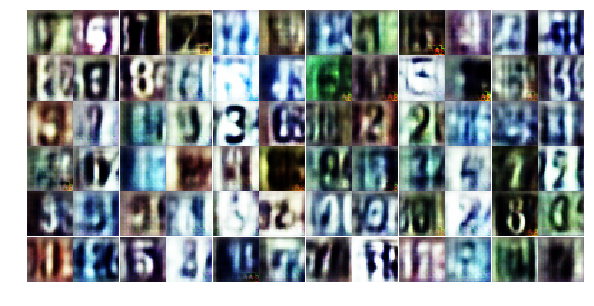

Epoch 20/25... Discriminator Loss: 0.6305... Generator Loss: 1.2086
Epoch 20/25... Discriminator Loss: 0.7785... Generator Loss: 1.0860
Epoch 20/25... Discriminator Loss: 0.6794... Generator Loss: 0.9813
Epoch 20/25... Discriminator Loss: 1.3368... Generator Loss: 0.5105
Epoch 20/25... Discriminator Loss: 0.7740... Generator Loss: 0.9546
Epoch 20/25... Discriminator Loss: 0.9942... Generator Loss: 0.6078
Epoch 20/25... Discriminator Loss: 0.9140... Generator Loss: 0.7134
Epoch 20/25... Discriminator Loss: 1.6988... Generator Loss: 0.3355
Epoch 20/25... Discriminator Loss: 1.1654... Generator Loss: 0.5428
Epoch 20/25... Discriminator Loss: 0.5326... Generator Loss: 1.2610


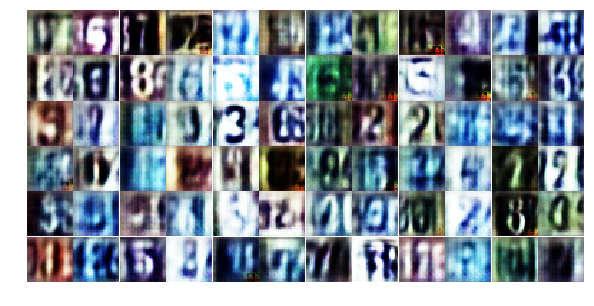

Epoch 20/25... Discriminator Loss: 0.8373... Generator Loss: 0.8785
Epoch 20/25... Discriminator Loss: 0.5747... Generator Loss: 1.1713
Epoch 20/25... Discriminator Loss: 0.7170... Generator Loss: 0.9737
Epoch 20/25... Discriminator Loss: 0.6081... Generator Loss: 1.3113
Epoch 20/25... Discriminator Loss: 1.1497... Generator Loss: 0.6366
Epoch 20/25... Discriminator Loss: 0.5106... Generator Loss: 1.3170
Epoch 20/25... Discriminator Loss: 0.7619... Generator Loss: 2.0941
Epoch 20/25... Discriminator Loss: 0.6414... Generator Loss: 1.4770
Epoch 20/25... Discriminator Loss: 1.4590... Generator Loss: 3.7742
Epoch 20/25... Discriminator Loss: 1.4519... Generator Loss: 0.5901


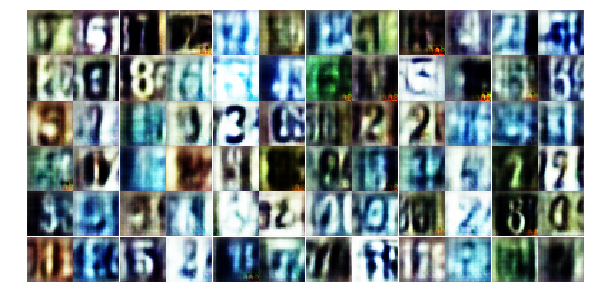

Epoch 20/25... Discriminator Loss: 0.7290... Generator Loss: 1.0833
Epoch 20/25... Discriminator Loss: 0.6666... Generator Loss: 1.6879
Epoch 20/25... Discriminator Loss: 0.5105... Generator Loss: 1.4356
Epoch 20/25... Discriminator Loss: 0.5086... Generator Loss: 1.3334
Epoch 20/25... Discriminator Loss: 0.8396... Generator Loss: 0.8427
Epoch 20/25... Discriminator Loss: 1.2518... Generator Loss: 0.5317
Epoch 20/25... Discriminator Loss: 1.5711... Generator Loss: 0.3587
Epoch 20/25... Discriminator Loss: 0.7494... Generator Loss: 1.0640
Epoch 20/25... Discriminator Loss: 0.8476... Generator Loss: 2.8586
Epoch 20/25... Discriminator Loss: 0.7416... Generator Loss: 0.9509


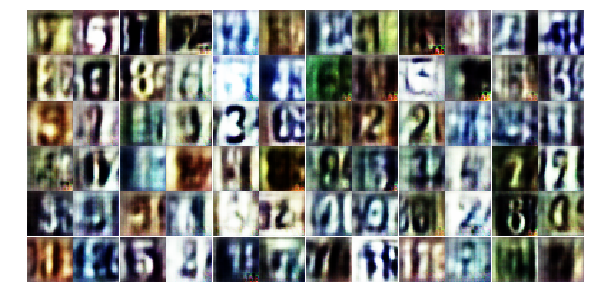

Epoch 20/25... Discriminator Loss: 0.6939... Generator Loss: 2.0370
Epoch 20/25... Discriminator Loss: 0.8280... Generator Loss: 0.8916
Epoch 20/25... Discriminator Loss: 0.6133... Generator Loss: 1.3437
Epoch 20/25... Discriminator Loss: 1.0050... Generator Loss: 0.7182
Epoch 20/25... Discriminator Loss: 0.4665... Generator Loss: 1.4400
Epoch 20/25... Discriminator Loss: 0.6030... Generator Loss: 1.2785
Epoch 21/25... Discriminator Loss: 0.9634... Generator Loss: 0.6560
Epoch 21/25... Discriminator Loss: 1.0320... Generator Loss: 0.7337
Epoch 21/25... Discriminator Loss: 1.9876... Generator Loss: 0.2156
Epoch 21/25... Discriminator Loss: 0.9910... Generator Loss: 0.7790


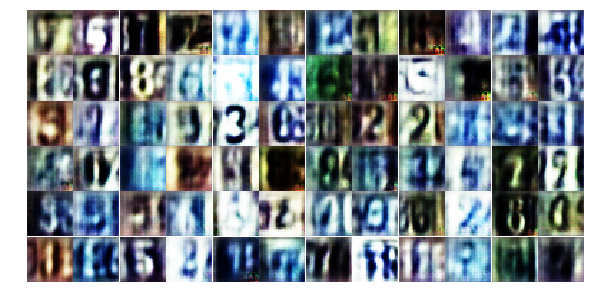

Epoch 21/25... Discriminator Loss: 0.6489... Generator Loss: 1.6614
Epoch 21/25... Discriminator Loss: 1.4594... Generator Loss: 0.4844
Epoch 21/25... Discriminator Loss: 0.3799... Generator Loss: 1.8173
Epoch 21/25... Discriminator Loss: 0.4842... Generator Loss: 1.4448
Epoch 21/25... Discriminator Loss: 1.1514... Generator Loss: 0.5224
Epoch 21/25... Discriminator Loss: 0.8406... Generator Loss: 0.9328
Epoch 21/25... Discriminator Loss: 0.7815... Generator Loss: 0.9077
Epoch 21/25... Discriminator Loss: 1.0562... Generator Loss: 0.6421
Epoch 21/25... Discriminator Loss: 0.5834... Generator Loss: 1.1486
Epoch 21/25... Discriminator Loss: 1.3237... Generator Loss: 0.4747


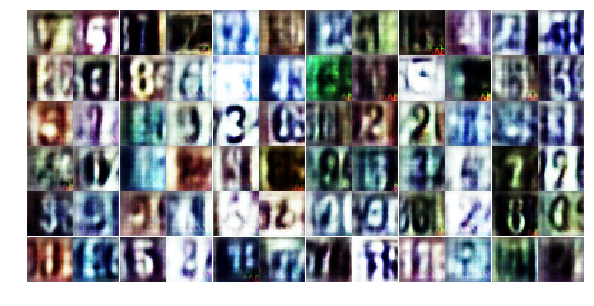

Epoch 21/25... Discriminator Loss: 0.3680... Generator Loss: 1.7344
Epoch 21/25... Discriminator Loss: 0.8935... Generator Loss: 0.7598
Epoch 21/25... Discriminator Loss: 1.4804... Generator Loss: 0.4884
Epoch 21/25... Discriminator Loss: 1.0054... Generator Loss: 0.6946
Epoch 21/25... Discriminator Loss: 0.9446... Generator Loss: 0.7170
Epoch 21/25... Discriminator Loss: 1.4115... Generator Loss: 0.4002
Epoch 21/25... Discriminator Loss: 0.7488... Generator Loss: 1.0855
Epoch 21/25... Discriminator Loss: 0.3886... Generator Loss: 1.7248
Epoch 21/25... Discriminator Loss: 0.4228... Generator Loss: 1.7999
Epoch 21/25... Discriminator Loss: 0.6573... Generator Loss: 1.1054


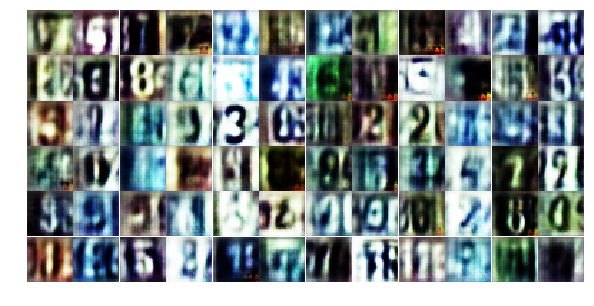

Epoch 21/25... Discriminator Loss: 1.1882... Generator Loss: 0.6287
Epoch 21/25... Discriminator Loss: 0.7114... Generator Loss: 1.0666
Epoch 21/25... Discriminator Loss: 0.7710... Generator Loss: 1.0875
Epoch 21/25... Discriminator Loss: 1.1907... Generator Loss: 0.5547
Epoch 21/25... Discriminator Loss: 1.1077... Generator Loss: 0.7231
Epoch 21/25... Discriminator Loss: 0.9297... Generator Loss: 0.7720
Epoch 21/25... Discriminator Loss: 0.5356... Generator Loss: 1.6883
Epoch 21/25... Discriminator Loss: 0.8086... Generator Loss: 0.9723
Epoch 21/25... Discriminator Loss: 1.0219... Generator Loss: 0.6731
Epoch 21/25... Discriminator Loss: 1.3167... Generator Loss: 0.5202


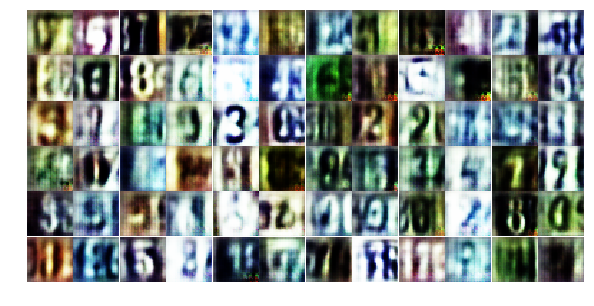

Epoch 21/25... Discriminator Loss: 1.2443... Generator Loss: 0.6003
Epoch 21/25... Discriminator Loss: 1.0383... Generator Loss: 3.3967
Epoch 21/25... Discriminator Loss: 0.9480... Generator Loss: 0.7163
Epoch 21/25... Discriminator Loss: 0.6804... Generator Loss: 1.0958
Epoch 21/25... Discriminator Loss: 0.6421... Generator Loss: 1.2369
Epoch 21/25... Discriminator Loss: 0.9750... Generator Loss: 0.6621
Epoch 21/25... Discriminator Loss: 0.6452... Generator Loss: 1.9886
Epoch 21/25... Discriminator Loss: 1.4711... Generator Loss: 0.3957
Epoch 21/25... Discriminator Loss: 0.5553... Generator Loss: 1.4159
Epoch 21/25... Discriminator Loss: 0.3556... Generator Loss: 1.6026


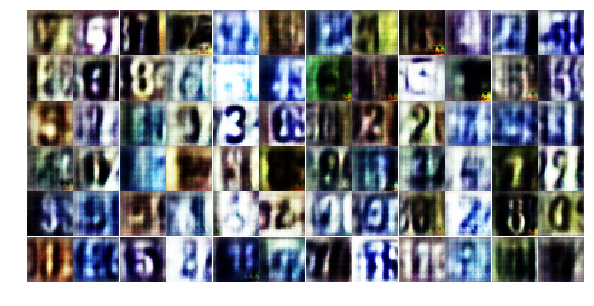

Epoch 21/25... Discriminator Loss: 0.8669... Generator Loss: 0.9040
Epoch 21/25... Discriminator Loss: 0.9283... Generator Loss: 0.7506
Epoch 21/25... Discriminator Loss: 0.3703... Generator Loss: 1.8224
Epoch 21/25... Discriminator Loss: 0.9976... Generator Loss: 0.6800
Epoch 21/25... Discriminator Loss: 0.5890... Generator Loss: 1.1421
Epoch 21/25... Discriminator Loss: 0.8699... Generator Loss: 0.7996
Epoch 21/25... Discriminator Loss: 1.6847... Generator Loss: 0.2940
Epoch 21/25... Discriminator Loss: 0.8248... Generator Loss: 2.1331
Epoch 21/25... Discriminator Loss: 0.9851... Generator Loss: 0.7369
Epoch 21/25... Discriminator Loss: 0.7208... Generator Loss: 1.0030


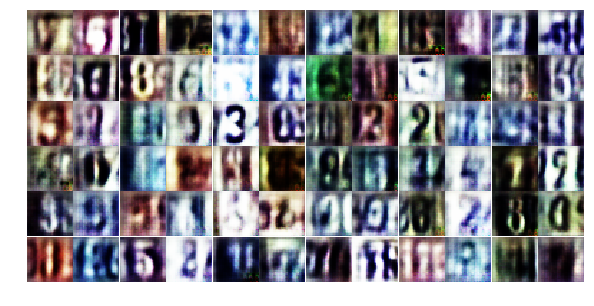

Epoch 21/25... Discriminator Loss: 0.6274... Generator Loss: 1.0368
Epoch 21/25... Discriminator Loss: 0.8213... Generator Loss: 0.9047
Epoch 21/25... Discriminator Loss: 0.5351... Generator Loss: 1.8218
Epoch 22/25... Discriminator Loss: 0.9020... Generator Loss: 0.8038
Epoch 22/25... Discriminator Loss: 1.0156... Generator Loss: 0.6658
Epoch 22/25... Discriminator Loss: 0.9120... Generator Loss: 0.7194
Epoch 22/25... Discriminator Loss: 0.5986... Generator Loss: 1.0778
Epoch 22/25... Discriminator Loss: 0.3622... Generator Loss: 1.7527
Epoch 22/25... Discriminator Loss: 1.0256... Generator Loss: 0.7477
Epoch 22/25... Discriminator Loss: 0.9879... Generator Loss: 0.7649


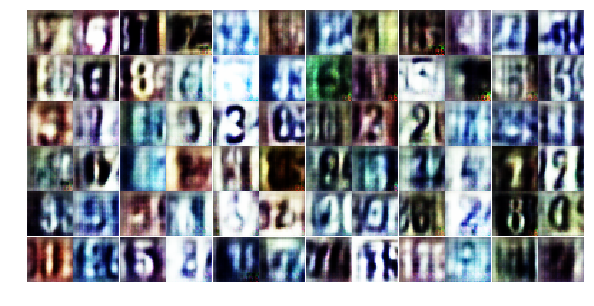

Epoch 22/25... Discriminator Loss: 0.5306... Generator Loss: 1.5580
Epoch 22/25... Discriminator Loss: 0.6635... Generator Loss: 1.7444
Epoch 22/25... Discriminator Loss: 1.6062... Generator Loss: 0.3973
Epoch 22/25... Discriminator Loss: 0.6164... Generator Loss: 1.0421
Epoch 22/25... Discriminator Loss: 0.6709... Generator Loss: 1.3915
Epoch 22/25... Discriminator Loss: 0.8108... Generator Loss: 0.8091
Epoch 22/25... Discriminator Loss: 1.4984... Generator Loss: 0.4550
Epoch 22/25... Discriminator Loss: 0.4406... Generator Loss: 1.5286
Epoch 22/25... Discriminator Loss: 0.8424... Generator Loss: 0.9105
Epoch 22/25... Discriminator Loss: 1.3878... Generator Loss: 0.5208


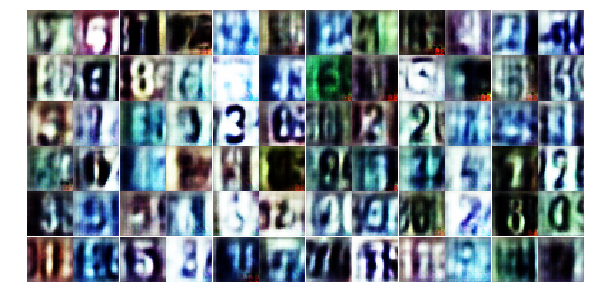

Epoch 22/25... Discriminator Loss: 0.4491... Generator Loss: 1.4263
Epoch 22/25... Discriminator Loss: 0.8411... Generator Loss: 0.8470
Epoch 22/25... Discriminator Loss: 1.0592... Generator Loss: 0.6939
Epoch 22/25... Discriminator Loss: 0.5716... Generator Loss: 1.2295
Epoch 22/25... Discriminator Loss: 0.5822... Generator Loss: 1.2115
Epoch 22/25... Discriminator Loss: 0.7930... Generator Loss: 0.9007
Epoch 22/25... Discriminator Loss: 0.4670... Generator Loss: 1.4555
Epoch 22/25... Discriminator Loss: 0.4684... Generator Loss: 1.2913
Epoch 22/25... Discriminator Loss: 0.7482... Generator Loss: 0.9836
Epoch 22/25... Discriminator Loss: 0.8715... Generator Loss: 0.8374


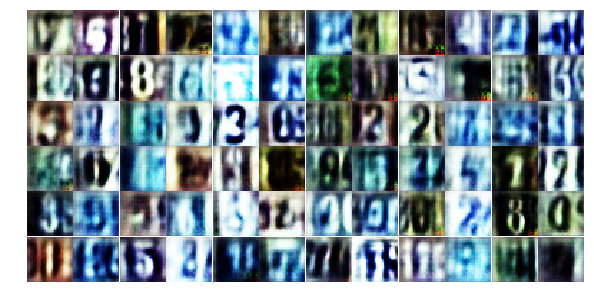

Epoch 22/25... Discriminator Loss: 0.8510... Generator Loss: 0.7539
Epoch 22/25... Discriminator Loss: 0.5665... Generator Loss: 1.2593
Epoch 22/25... Discriminator Loss: 0.4057... Generator Loss: 1.7296
Epoch 22/25... Discriminator Loss: 0.5876... Generator Loss: 1.2798
Epoch 22/25... Discriminator Loss: 0.8420... Generator Loss: 1.0657
Epoch 22/25... Discriminator Loss: 0.3891... Generator Loss: 1.6870
Epoch 22/25... Discriminator Loss: 0.0996... Generator Loss: 3.1064
Epoch 22/25... Discriminator Loss: 0.5847... Generator Loss: 1.3970
Epoch 22/25... Discriminator Loss: 0.9302... Generator Loss: 0.7981
Epoch 22/25... Discriminator Loss: 1.6638... Generator Loss: 0.3730


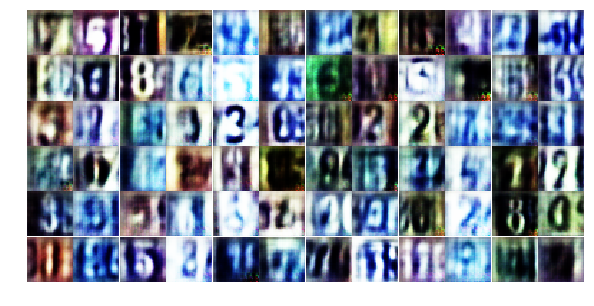

Epoch 22/25... Discriminator Loss: 0.7284... Generator Loss: 1.2481
Epoch 22/25... Discriminator Loss: 0.4268... Generator Loss: 1.6298
Epoch 22/25... Discriminator Loss: 0.3934... Generator Loss: 1.6978
Epoch 22/25... Discriminator Loss: 1.0663... Generator Loss: 0.6376
Epoch 22/25... Discriminator Loss: 0.5958... Generator Loss: 1.0809
Epoch 22/25... Discriminator Loss: 0.3654... Generator Loss: 2.0343
Epoch 22/25... Discriminator Loss: 0.4220... Generator Loss: 1.7223
Epoch 22/25... Discriminator Loss: 0.7237... Generator Loss: 1.9444
Epoch 22/25... Discriminator Loss: 0.8140... Generator Loss: 1.4805
Epoch 22/25... Discriminator Loss: 0.8445... Generator Loss: 0.9806


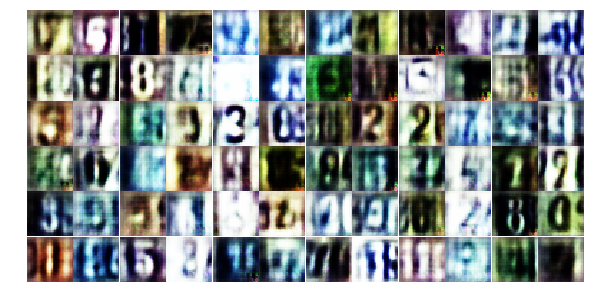

Epoch 22/25... Discriminator Loss: 0.9697... Generator Loss: 0.7247
Epoch 22/25... Discriminator Loss: 0.5492... Generator Loss: 1.3490
Epoch 22/25... Discriminator Loss: 0.6424... Generator Loss: 1.1036
Epoch 22/25... Discriminator Loss: 0.8641... Generator Loss: 1.8388
Epoch 22/25... Discriminator Loss: 0.7304... Generator Loss: 1.1047
Epoch 22/25... Discriminator Loss: 0.6379... Generator Loss: 1.8619
Epoch 22/25... Discriminator Loss: 1.3653... Generator Loss: 0.4675
Epoch 22/25... Discriminator Loss: 0.5844... Generator Loss: 1.2253
Epoch 22/25... Discriminator Loss: 0.7778... Generator Loss: 1.3557
Epoch 22/25... Discriminator Loss: 0.8334... Generator Loss: 0.8531


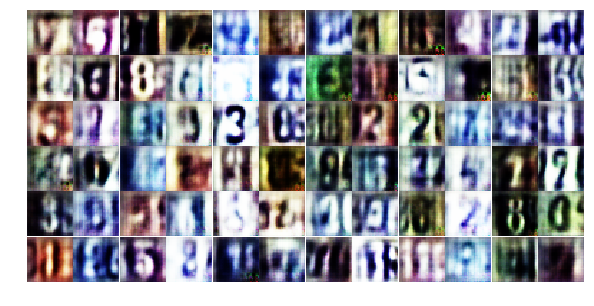

Epoch 23/25... Discriminator Loss: 0.5563... Generator Loss: 1.2526
Epoch 23/25... Discriminator Loss: 0.4897... Generator Loss: 1.2948
Epoch 23/25... Discriminator Loss: 0.6981... Generator Loss: 1.0813
Epoch 23/25... Discriminator Loss: 0.9787... Generator Loss: 0.7678
Epoch 23/25... Discriminator Loss: 0.8365... Generator Loss: 0.9286
Epoch 23/25... Discriminator Loss: 1.9031... Generator Loss: 0.2612
Epoch 23/25... Discriminator Loss: 0.4629... Generator Loss: 1.5441
Epoch 23/25... Discriminator Loss: 0.8308... Generator Loss: 0.8733
Epoch 23/25... Discriminator Loss: 0.6276... Generator Loss: 1.5908
Epoch 23/25... Discriminator Loss: 0.4549... Generator Loss: 1.4474


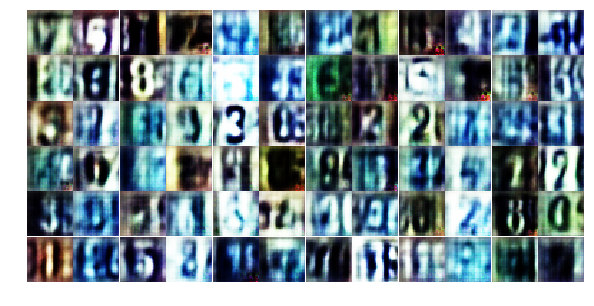

Epoch 23/25... Discriminator Loss: 0.8172... Generator Loss: 0.8000
Epoch 23/25... Discriminator Loss: 0.5581... Generator Loss: 1.3700
Epoch 23/25... Discriminator Loss: 0.9637... Generator Loss: 0.8398
Epoch 23/25... Discriminator Loss: 0.7939... Generator Loss: 0.9039
Epoch 23/25... Discriminator Loss: 0.7725... Generator Loss: 0.9388
Epoch 23/25... Discriminator Loss: 0.8700... Generator Loss: 0.9513
Epoch 23/25... Discriminator Loss: 0.6285... Generator Loss: 1.0693
Epoch 23/25... Discriminator Loss: 0.6584... Generator Loss: 1.0405
Epoch 23/25... Discriminator Loss: 0.5393... Generator Loss: 1.4627
Epoch 23/25... Discriminator Loss: 0.7089... Generator Loss: 0.9964


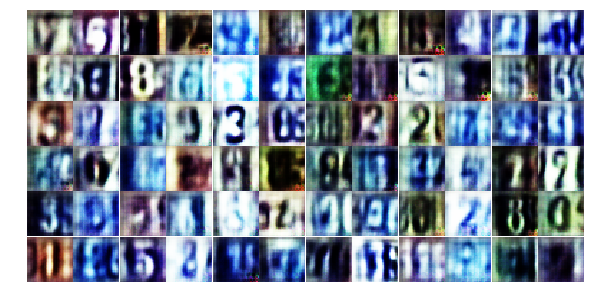

Epoch 23/25... Discriminator Loss: 0.9317... Generator Loss: 0.8298
Epoch 23/25... Discriminator Loss: 0.6387... Generator Loss: 1.1558
Epoch 23/25... Discriminator Loss: 0.6819... Generator Loss: 1.1505
Epoch 23/25... Discriminator Loss: 0.6537... Generator Loss: 1.4165
Epoch 23/25... Discriminator Loss: 0.5607... Generator Loss: 1.3485
Epoch 23/25... Discriminator Loss: 0.5203... Generator Loss: 1.4616
Epoch 23/25... Discriminator Loss: 0.5883... Generator Loss: 1.2310
Epoch 23/25... Discriminator Loss: 0.6882... Generator Loss: 1.0791
Epoch 23/25... Discriminator Loss: 0.8173... Generator Loss: 0.9148
Epoch 23/25... Discriminator Loss: 0.9983... Generator Loss: 0.6873


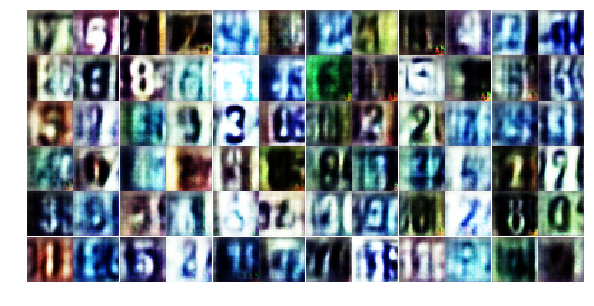

Epoch 23/25... Discriminator Loss: 0.4684... Generator Loss: 1.3485
Epoch 23/25... Discriminator Loss: 1.0525... Generator Loss: 0.7820
Epoch 23/25... Discriminator Loss: 1.7744... Generator Loss: 0.2858
Epoch 23/25... Discriminator Loss: 2.0003... Generator Loss: 1.2424
Epoch 23/25... Discriminator Loss: 1.0075... Generator Loss: 0.7244
Epoch 23/25... Discriminator Loss: 1.2540... Generator Loss: 0.5030
Epoch 23/25... Discriminator Loss: 0.8376... Generator Loss: 0.9117
Epoch 23/25... Discriminator Loss: 1.1178... Generator Loss: 0.7152
Epoch 23/25... Discriminator Loss: 0.4103... Generator Loss: 1.5455
Epoch 23/25... Discriminator Loss: 0.5943... Generator Loss: 1.1862


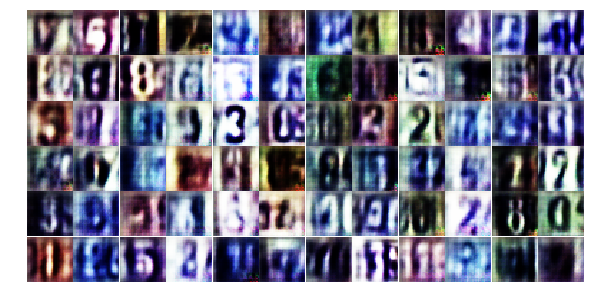

Epoch 23/25... Discriminator Loss: 0.4640... Generator Loss: 1.3808
Epoch 23/25... Discriminator Loss: 0.9255... Generator Loss: 0.8195
Epoch 23/25... Discriminator Loss: 1.8234... Generator Loss: 0.3457
Epoch 23/25... Discriminator Loss: 0.7570... Generator Loss: 1.0230
Epoch 23/25... Discriminator Loss: 0.6780... Generator Loss: 1.1231
Epoch 23/25... Discriminator Loss: 0.7564... Generator Loss: 1.0899
Epoch 23/25... Discriminator Loss: 0.7821... Generator Loss: 0.8724
Epoch 23/25... Discriminator Loss: 0.7469... Generator Loss: 0.9925
Epoch 23/25... Discriminator Loss: 0.5709... Generator Loss: 1.2516
Epoch 23/25... Discriminator Loss: 0.4747... Generator Loss: 1.6019


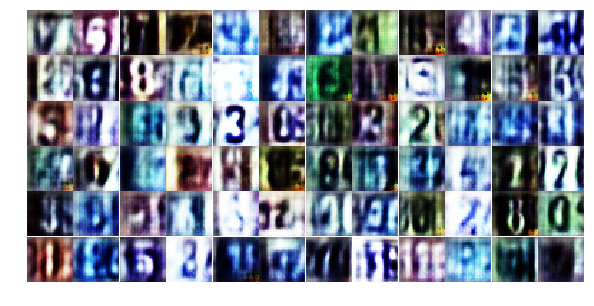

Epoch 23/25... Discriminator Loss: 0.5235... Generator Loss: 1.3312
Epoch 23/25... Discriminator Loss: 0.7192... Generator Loss: 1.0129
Epoch 23/25... Discriminator Loss: 0.6186... Generator Loss: 1.1865
Epoch 23/25... Discriminator Loss: 0.2949... Generator Loss: 2.0045
Epoch 23/25... Discriminator Loss: 2.0489... Generator Loss: 0.2545
Epoch 23/25... Discriminator Loss: 0.6288... Generator Loss: 1.3017
Epoch 23/25... Discriminator Loss: 0.9166... Generator Loss: 0.8481
Epoch 24/25... Discriminator Loss: 0.7728... Generator Loss: 0.9959
Epoch 24/25... Discriminator Loss: 1.0328... Generator Loss: 0.7284
Epoch 24/25... Discriminator Loss: 0.9360... Generator Loss: 0.8252


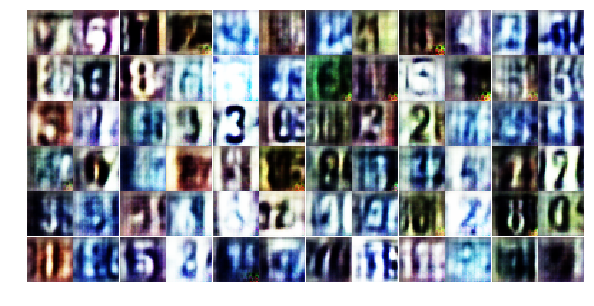

Epoch 24/25... Discriminator Loss: 0.7363... Generator Loss: 1.0437
Epoch 24/25... Discriminator Loss: 0.4897... Generator Loss: 1.3731
Epoch 24/25... Discriminator Loss: 0.5451... Generator Loss: 1.3826
Epoch 24/25... Discriminator Loss: 0.7164... Generator Loss: 1.9164
Epoch 24/25... Discriminator Loss: 0.4960... Generator Loss: 1.4364
Epoch 24/25... Discriminator Loss: 1.0977... Generator Loss: 0.6602
Epoch 24/25... Discriminator Loss: 0.6182... Generator Loss: 1.1615
Epoch 24/25... Discriminator Loss: 1.0251... Generator Loss: 0.7438
Epoch 24/25... Discriminator Loss: 0.4695... Generator Loss: 1.3797
Epoch 24/25... Discriminator Loss: 0.6177... Generator Loss: 1.1383


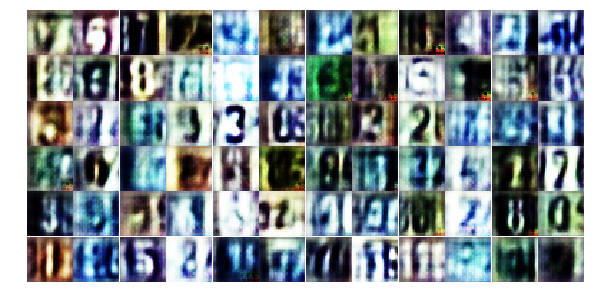

Epoch 24/25... Discriminator Loss: 1.1346... Generator Loss: 0.5800
Epoch 24/25... Discriminator Loss: 1.2051... Generator Loss: 0.5200
Epoch 24/25... Discriminator Loss: 1.5238... Generator Loss: 0.4842
Epoch 24/25... Discriminator Loss: 0.5756... Generator Loss: 1.1404
Epoch 24/25... Discriminator Loss: 0.6659... Generator Loss: 1.1807
Epoch 24/25... Discriminator Loss: 0.5784... Generator Loss: 1.2956
Epoch 24/25... Discriminator Loss: 1.0731... Generator Loss: 0.6671
Epoch 24/25... Discriminator Loss: 1.2870... Generator Loss: 0.5429
Epoch 24/25... Discriminator Loss: 0.6491... Generator Loss: 1.2096
Epoch 24/25... Discriminator Loss: 0.6421... Generator Loss: 1.1864


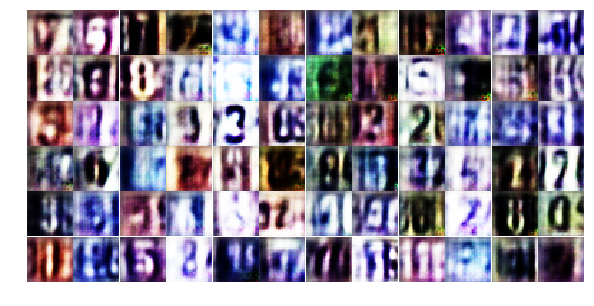

Epoch 24/25... Discriminator Loss: 0.7602... Generator Loss: 0.9705
Epoch 24/25... Discriminator Loss: 0.7418... Generator Loss: 0.9393
Epoch 24/25... Discriminator Loss: 0.6259... Generator Loss: 1.1829
Epoch 24/25... Discriminator Loss: 1.2299... Generator Loss: 0.6363
Epoch 24/25... Discriminator Loss: 0.3660... Generator Loss: 1.7538
Epoch 24/25... Discriminator Loss: 0.6396... Generator Loss: 1.0974
Epoch 24/25... Discriminator Loss: 0.2723... Generator Loss: 1.8997
Epoch 24/25... Discriminator Loss: 0.5984... Generator Loss: 1.2760
Epoch 24/25... Discriminator Loss: 0.6962... Generator Loss: 1.0633
Epoch 24/25... Discriminator Loss: 0.7762... Generator Loss: 0.9050


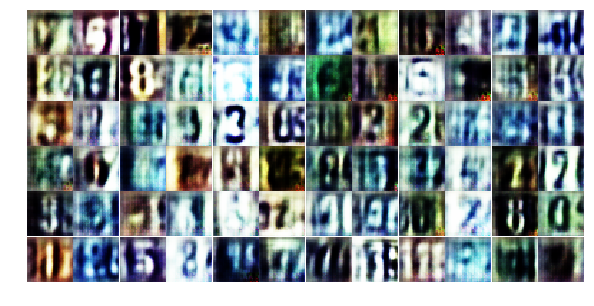

Epoch 24/25... Discriminator Loss: 0.6326... Generator Loss: 1.0212
Epoch 24/25... Discriminator Loss: 0.6821... Generator Loss: 1.0047
Epoch 24/25... Discriminator Loss: 0.7308... Generator Loss: 1.8890
Epoch 24/25... Discriminator Loss: 0.7144... Generator Loss: 1.1959
Epoch 24/25... Discriminator Loss: 0.5568... Generator Loss: 1.2972
Epoch 24/25... Discriminator Loss: 0.8821... Generator Loss: 0.7997
Epoch 24/25... Discriminator Loss: 1.3747... Generator Loss: 0.5385
Epoch 24/25... Discriminator Loss: 1.6276... Generator Loss: 0.3449
Epoch 24/25... Discriminator Loss: 1.0593... Generator Loss: 0.5934
Epoch 24/25... Discriminator Loss: 0.7800... Generator Loss: 2.5338


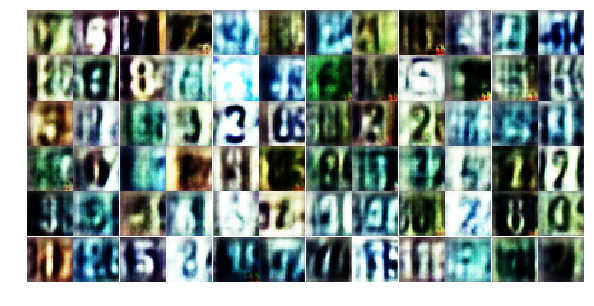

Epoch 24/25... Discriminator Loss: 0.7484... Generator Loss: 1.1705
Epoch 24/25... Discriminator Loss: 1.0972... Generator Loss: 0.6397
Epoch 24/25... Discriminator Loss: 1.2270... Generator Loss: 0.6071
Epoch 24/25... Discriminator Loss: 1.0457... Generator Loss: 0.6903
Epoch 24/25... Discriminator Loss: 1.2390... Generator Loss: 0.5772
Epoch 24/25... Discriminator Loss: 0.6255... Generator Loss: 1.2043
Epoch 24/25... Discriminator Loss: 0.9975... Generator Loss: 0.8088
Epoch 24/25... Discriminator Loss: 0.5715... Generator Loss: 1.2092
Epoch 24/25... Discriminator Loss: 0.8489... Generator Loss: 1.0350
Epoch 24/25... Discriminator Loss: 1.1176... Generator Loss: 0.6334


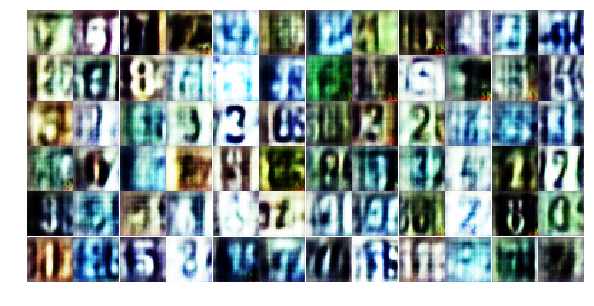

Epoch 24/25... Discriminator Loss: 1.2004... Generator Loss: 0.5056
Epoch 24/25... Discriminator Loss: 1.7224... Generator Loss: 0.4098
Epoch 24/25... Discriminator Loss: 1.1812... Generator Loss: 0.6289
Epoch 24/25... Discriminator Loss: 2.2313... Generator Loss: 0.2232
Epoch 24/25... Discriminator Loss: 0.8853... Generator Loss: 0.7936
Epoch 25/25... Discriminator Loss: 0.6119... Generator Loss: 1.2643
Epoch 25/25... Discriminator Loss: 0.5212... Generator Loss: 1.5730
Epoch 25/25... Discriminator Loss: 1.1882... Generator Loss: 0.5680
Epoch 25/25... Discriminator Loss: 1.3305... Generator Loss: 0.5361
Epoch 25/25... Discriminator Loss: 1.0474... Generator Loss: 0.6685


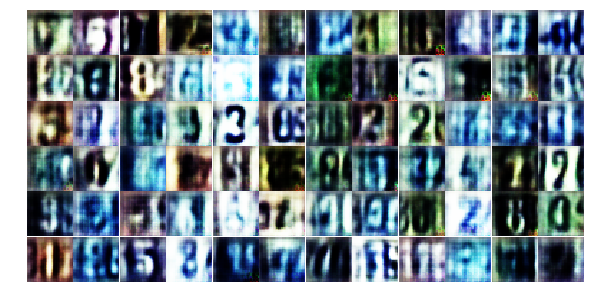

Epoch 25/25... Discriminator Loss: 1.1009... Generator Loss: 0.5740
Epoch 25/25... Discriminator Loss: 1.3280... Generator Loss: 0.5530
Epoch 25/25... Discriminator Loss: 0.8282... Generator Loss: 0.7818
Epoch 25/25... Discriminator Loss: 0.8032... Generator Loss: 0.9423
Epoch 25/25... Discriminator Loss: 0.7242... Generator Loss: 1.2975
Epoch 25/25... Discriminator Loss: 1.2155... Generator Loss: 0.5456
Epoch 25/25... Discriminator Loss: 0.6349... Generator Loss: 1.1551
Epoch 25/25... Discriminator Loss: 0.9771... Generator Loss: 0.8187
Epoch 25/25... Discriminator Loss: 0.5815... Generator Loss: 1.1845
Epoch 25/25... Discriminator Loss: 0.7294... Generator Loss: 0.9738


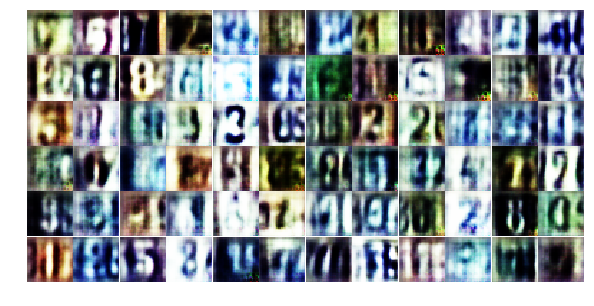

Epoch 25/25... Discriminator Loss: 0.9743... Generator Loss: 0.7670
Epoch 25/25... Discriminator Loss: 0.4794... Generator Loss: 1.8597
Epoch 25/25... Discriminator Loss: 0.6381... Generator Loss: 1.1351
Epoch 25/25... Discriminator Loss: 1.3680... Generator Loss: 0.4798
Epoch 25/25... Discriminator Loss: 0.5468... Generator Loss: 1.6791
Epoch 25/25... Discriminator Loss: 0.3873... Generator Loss: 1.6862
Epoch 25/25... Discriminator Loss: 1.2076... Generator Loss: 0.8619
Epoch 25/25... Discriminator Loss: 2.0259... Generator Loss: 0.3206
Epoch 25/25... Discriminator Loss: 0.5457... Generator Loss: 1.2503
Epoch 25/25... Discriminator Loss: 0.5869... Generator Loss: 1.4258


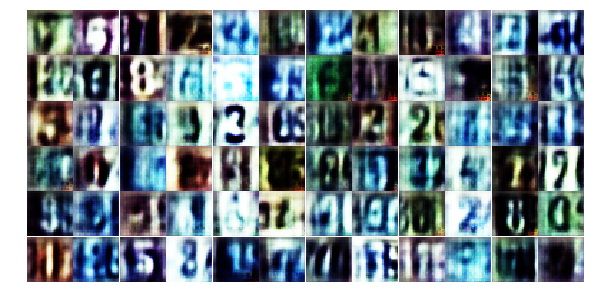

Epoch 25/25... Discriminator Loss: 0.9144... Generator Loss: 0.7935
Epoch 25/25... Discriminator Loss: 0.5137... Generator Loss: 1.2889
Epoch 25/25... Discriminator Loss: 0.7255... Generator Loss: 1.0051
Epoch 25/25... Discriminator Loss: 0.2833... Generator Loss: 2.0263
Epoch 25/25... Discriminator Loss: 0.9422... Generator Loss: 0.7948
Epoch 25/25... Discriminator Loss: 0.6707... Generator Loss: 1.1222
Epoch 25/25... Discriminator Loss: 0.6858... Generator Loss: 1.1489
Epoch 25/25... Discriminator Loss: 1.0306... Generator Loss: 0.6814
Epoch 25/25... Discriminator Loss: 1.3216... Generator Loss: 0.4270
Epoch 25/25... Discriminator Loss: 0.3651... Generator Loss: 2.1722


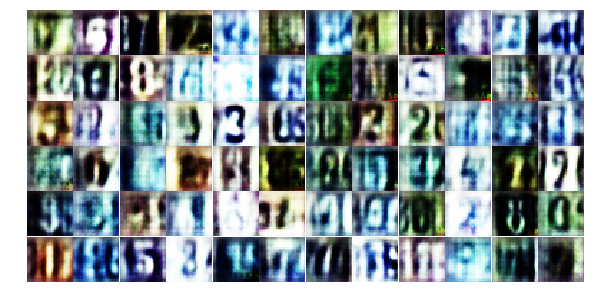

Epoch 25/25... Discriminator Loss: 0.8216... Generator Loss: 0.8683
Epoch 25/25... Discriminator Loss: 0.6862... Generator Loss: 1.0578
Epoch 25/25... Discriminator Loss: 0.8688... Generator Loss: 0.9280
Epoch 25/25... Discriminator Loss: 1.1405... Generator Loss: 0.6279
Epoch 25/25... Discriminator Loss: 0.6483... Generator Loss: 1.1946
Epoch 25/25... Discriminator Loss: 0.3386... Generator Loss: 1.6403
Epoch 25/25... Discriminator Loss: 0.8787... Generator Loss: 0.8196
Epoch 25/25... Discriminator Loss: 0.9162... Generator Loss: 0.7667
Epoch 25/25... Discriminator Loss: 1.8505... Generator Loss: 0.4070
Epoch 25/25... Discriminator Loss: 0.5939... Generator Loss: 1.2094


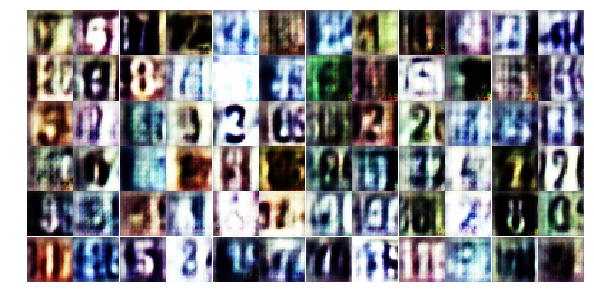

Epoch 25/25... Discriminator Loss: 0.7531... Generator Loss: 1.0471
Epoch 25/25... Discriminator Loss: 1.0254... Generator Loss: 0.7660
Epoch 25/25... Discriminator Loss: 0.7653... Generator Loss: 0.9237
Epoch 25/25... Discriminator Loss: 0.7565... Generator Loss: 0.9574
Epoch 25/25... Discriminator Loss: 0.7732... Generator Loss: 0.9511
Epoch 25/25... Discriminator Loss: 0.4704... Generator Loss: 1.5641
Epoch 25/25... Discriminator Loss: 0.7817... Generator Loss: 1.9993
Epoch 25/25... Discriminator Loss: 0.8984... Generator Loss: 0.8138
Epoch 25/25... Discriminator Loss: 1.0106... Generator Loss: 0.6869
Epoch 25/25... Discriminator Loss: 1.3736... Generator Loss: 0.4636


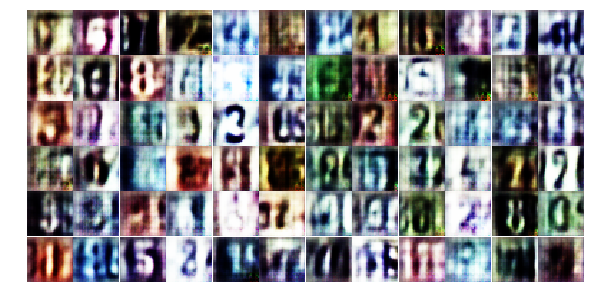

Epoch 25/25... Discriminator Loss: 0.9749... Generator Loss: 0.7645
Epoch 25/25... Discriminator Loss: 2.2333... Generator Loss: 0.1930


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

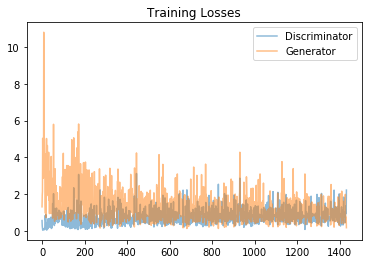

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

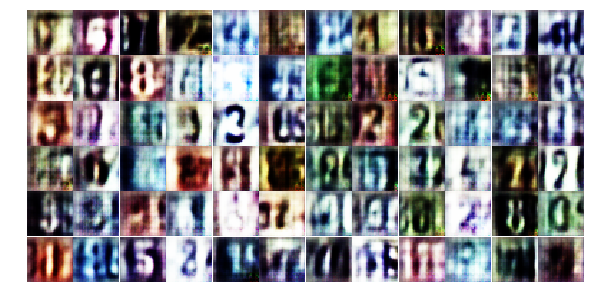

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))